In [1]:
import pandas as pd
from matplotlib import pyplot as plt
import seaborn as sns
import numpy as np
%matplotlib inline

#!pip install plotly
import plotly.graph_objects as go                   
import plotly.express as px
from plotly.subplots import make_subplots

import statsmodels.api as sm
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf,plot_pacf
from statsmodels.tsa.stattools import adfuller
from statsmodels.tsa.holtwinters import SimpleExpSmoothing
from statsmodels.tsa.holtwinters import ExponentialSmoothing

In [2]:
import warnings
warnings.filterwarnings('ignore')

In [3]:
pjm_data = pd.read_excel('PJMW_MW_Hourly.xlsx',index_col = 'Datetime', parse_dates = ['Datetime'])


In [4]:
pjm_data


,PJMW_MW
Datetime,
2002-12-31 01:00:00,5077
2002-12-31 02:00:00,4939
2002-12-31 03:00:00,4885
2002-12-31 04:00:00,4857
2002-12-31 05:00:00,4930
...,...
2018-01-01 20:00:00,8401
2018-01-01 21:00:00,8373
2018-01-01 22:00:00,8238


In [5]:
pjm_data.head(10)


,PJMW_MW
Datetime,
2002-12-31 01:00:00,5077
2002-12-31 02:00:00,4939
2002-12-31 03:00:00,4885
2002-12-31 04:00:00,4857
2002-12-31 05:00:00,4930
2002-12-31 06:00:00,5126
2002-12-31 07:00:00,5493
2002-12-31 08:00:00,5824
2002-12-31 09:00:00,5962


In [6]:
#sorting the data
pjm_data.sort_index(inplace = True)

In [7]:
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374
2002-04-01 02:00:00,4306
2002-04-01 03:00:00,4322
2002-04-01 04:00:00,4359
2002-04-01 05:00:00,4436
...,...
2018-08-02 20:00:00,6545
2018-08-02 21:00:00,6496
2018-08-02 22:00:00,6325


In [8]:
pjm_data.shape


(143206, 1)

In [9]:
pjm_data.isna().sum()


PJMW_MW    0
dtype: int64

In [10]:
pjm_data.dtypes


PJMW_MW    int64
dtype: object

In [11]:
pjm_data.describe()


,PJMW_MW
count,143206.000000
mean,5602.375089
std,979.142872
min,487.000000
25%,4907.000000
50%,5530.000000
75%,6252.000000
max,9594.000000


<AxesSubplot:xlabel='Datetime'>

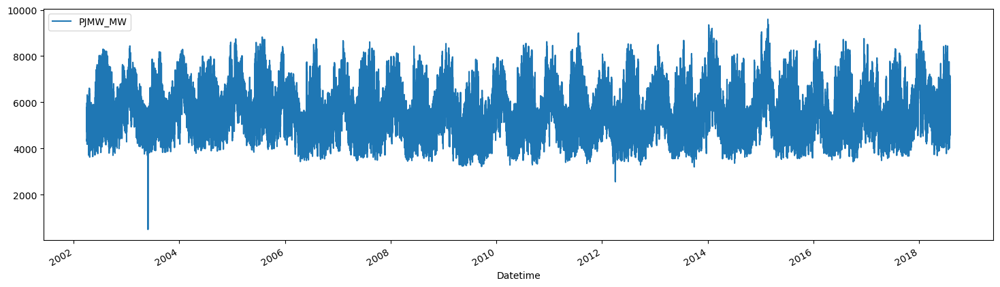

In [12]:
pjm_data.plot(figsize=(18,5),label=True)


array([[<AxesSubplot:title={'center':'PJMW_MW'}>]], dtype=object)

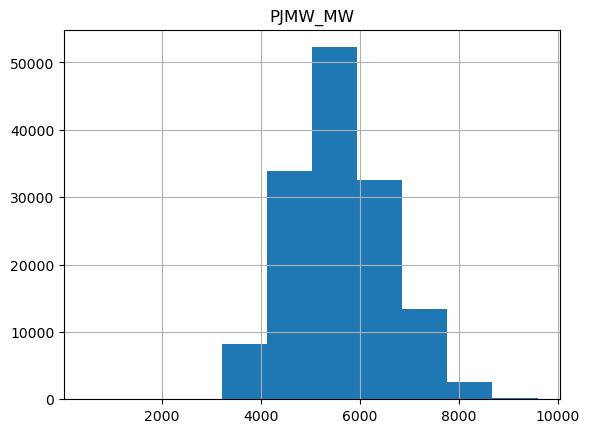

In [13]:
pjm_data.hist()


In [14]:
duplicate_values = pjm_data[pjm_data.index.duplicated()]
print(pjm_data.loc[duplicate_values.index.values, :])

                     PJMW_MW
Datetime                    
2014-11-02 02:00:00     4571
2014-11-02 02:00:00     4613
2015-11-01 02:00:00     3927
2015-11-01 02:00:00     3832
2016-11-06 02:00:00     4114
2016-11-06 02:00:00     4089
2017-11-05 02:00:00     3984
2017-11-05 02:00:00     4042


In [15]:
#4 Rows reduced as duplicate data
pjm_data= pjm_data.groupby('Datetime').agg(np.mean)
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [16]:
pjm_data = pjm_data.asfreq('H')
print('Missing values: {}'.format(len(pjm_data[pjm_data['PJMW_MW'].isna()])))

Missing values: 30


In [17]:
pjm_data['PJMW_MW'] = pjm_data['PJMW_MW'].interpolate(limit_area = 'inside', limit = None)

In [18]:
#30 rows increased by interpolating missing values
pjm_data

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [19]:
#copying the data
df = pjm_data.copy()

In [20]:
df

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [21]:
df['Date']=df.index.date
df['year'] = df.index.year
df['month'] = df.index.month
df['month_name'] = df.index.month_name()
df['week_of_year'] = df.index.isocalendar().week
df['quarter'] = df.index.quarter
df['day_of_week_name'] = df.index.day_name()
df['day_of_month'] = df.index.day
df['day_of_year'] = df.index.dayofyear
df['hour'] = df.index.hour 

In [22]:
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5
...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22


In [23]:
df.head(20)

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5
2002-04-01 06:00:00,4723.0,2002-04-01,2002,4,April,14,2,Monday,1,91,6
2002-04-01 07:00:00,5180.0,2002-04-01,2002,4,April,14,2,Monday,1,91,7
2002-04-01 08:00:00,5482.0,2002-04-01,2002,4,April,14,2,Monday,1,91,8
2002-04-01 09:00:00,5616.0,2002-04-01,2002,4,April,14,2,Monday,1,91,9


In [24]:
df[df["PJMW_MW"] == df["PJMW_MW"].max()]

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2015-02-20 08:00:00,9594.0,2015-02-20,2015,2,February,8,1,Friday,20,51,8


In [25]:
df[df["PJMW_MW"] == df["PJMW_MW"].min()]

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29,487.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,0


In [26]:
df.groupby(by='year')['PJMW_MW'].sum().sort_values(ascending=False)

year
2005    52894167.5
2004    51529495.5
2003    49934646.5
2014    49549721.0
2007    49363488.5
2015    49241343.0
2016    48996276.5
2010    48818465.0
2013    48676336.0
2008    48575109.5
2011    48262289.5
2017    48183510.5
2006    47524343.0
2012    47388259.5
2009    46342076.5
2002    37095135.5
2018    30041708.5
Name: PJMW_MW, dtype: float64

In [27]:
df.groupby(by='year')['PJMW_MW'].sum().sort_values(ascending=True)

year
2018    30041708.5
2002    37095135.5
2009    46342076.5
2012    47388259.5
2006    47524343.0
2017    48183510.5
2011    48262289.5
2008    48575109.5
2013    48676336.0
2010    48818465.0
2016    48996276.5
2015    49241343.0
2007    49363488.5
2014    49549721.0
2003    49934646.5
2004    51529495.5
2005    52894167.5
Name: PJMW_MW, dtype: float64

In [28]:
df.groupby(by='month_name')['PJMW_MW'].sum().sort_values(ascending=False).head()


month_name
January     76753037.0
July        74136721.0
December    72191551.0
August      69592073.0
February    68307782.0
Name: PJMW_MW, dtype: float64

In [29]:
df.groupby(by='month_name')['PJMW_MW'].sum().sort_values(ascending=True).head()

month_name
October      59488727.5
September    59971646.0
April        61465673.5
November     62246632.0
May          63440417.0
Name: PJMW_MW, dtype: float64

<AxesSubplot:xlabel='Datetime'>

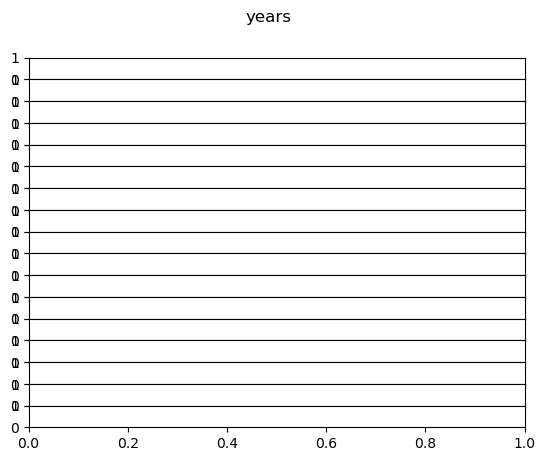

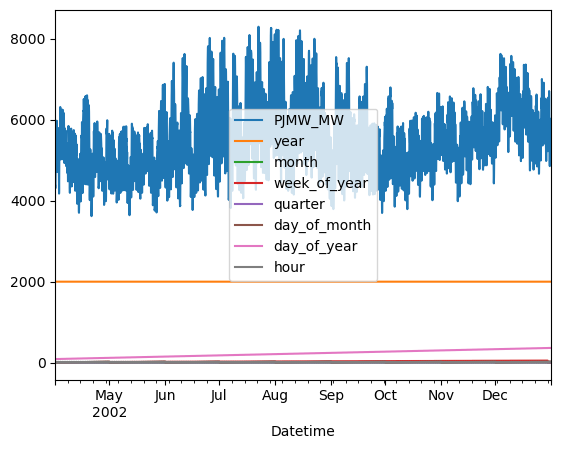

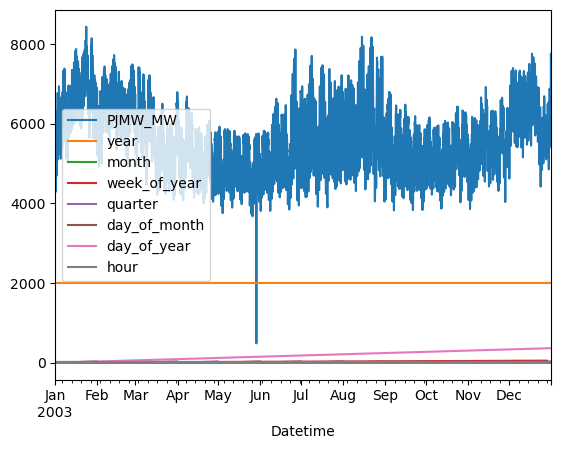

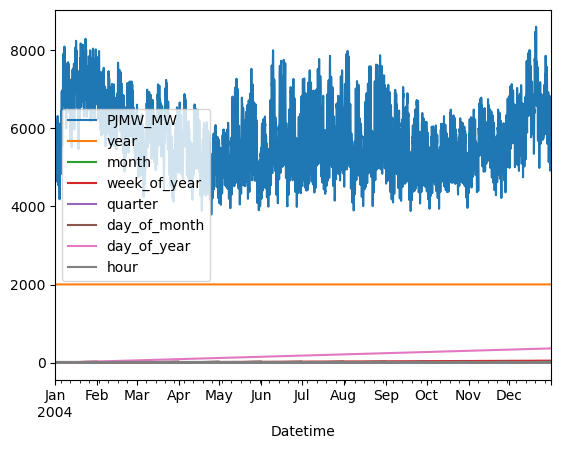

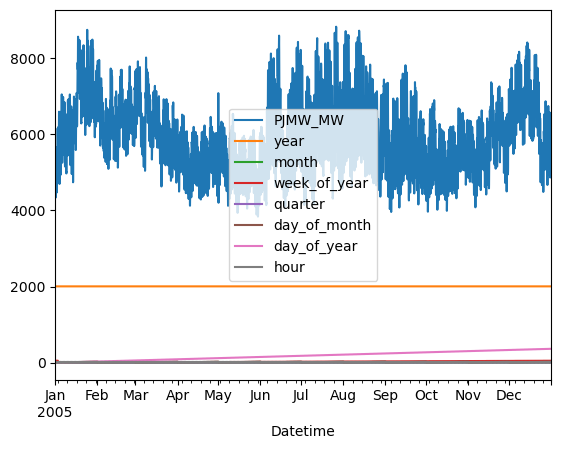

...

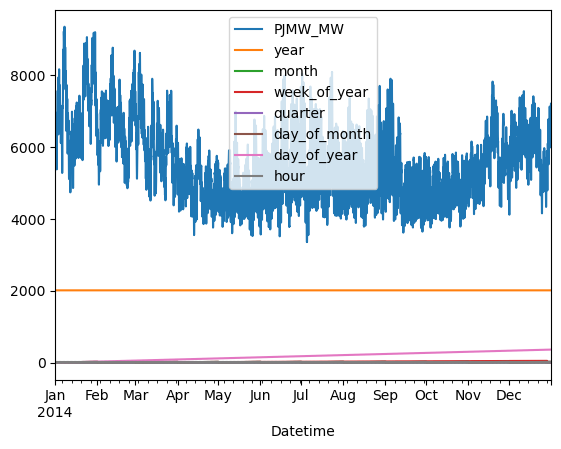

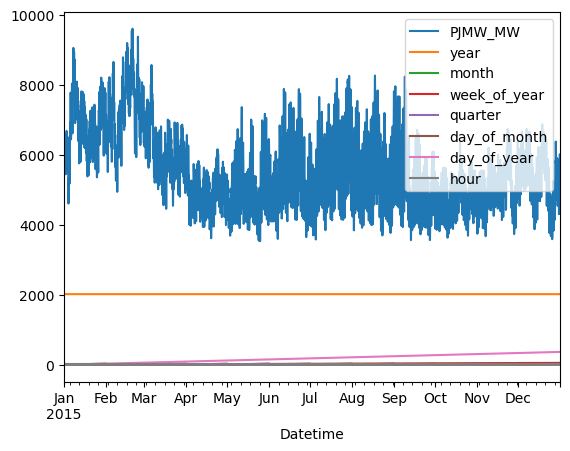

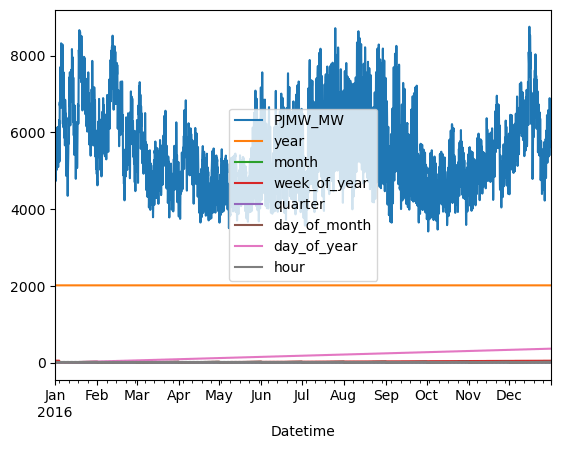

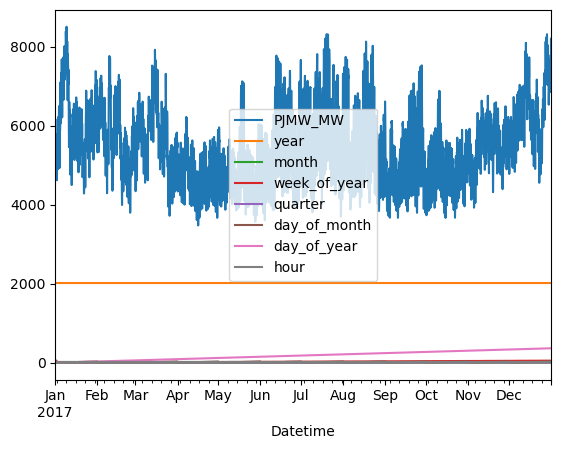

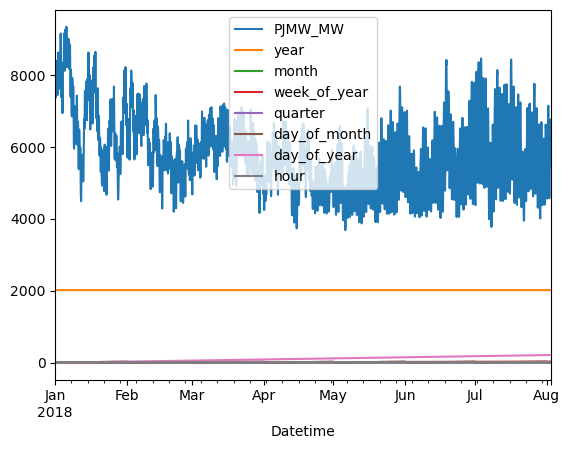

In [30]:
fig = plt.figure()
gs = fig.add_gridspec(17, hspace=0)
axs = gs.subplots(sharex=True, sharey=True)
fig.suptitle('years')
df.loc['2002'].plot()
df.loc['2003'].plot()
df.loc['2004'].plot()
df.loc['2005'].plot()
df.loc['2006'].plot()
df.loc['2007'].plot()
df.loc['2008'].plot()
df.loc['2009'].plot()
df.loc['2010'].plot()
df.loc['2011'].plot()
df.loc['2012'].plot()
df.loc['2013'].plot()
df.loc['2014'].plot()
df.loc['2015'].plot()
df.loc['2016'].plot()
df.loc['2017'].plot()
df.loc['2018'].plot()

<AxesSubplot:xlabel='Datetime'>

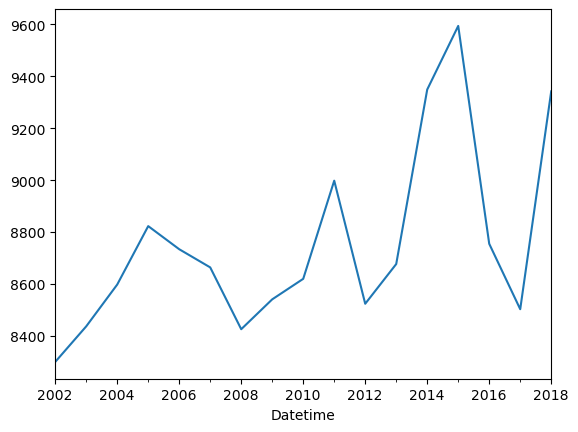

In [31]:
df.PJMW_MW.resample(rule='A').max().plot()

<AxesSubplot:xlabel='Datetime'>

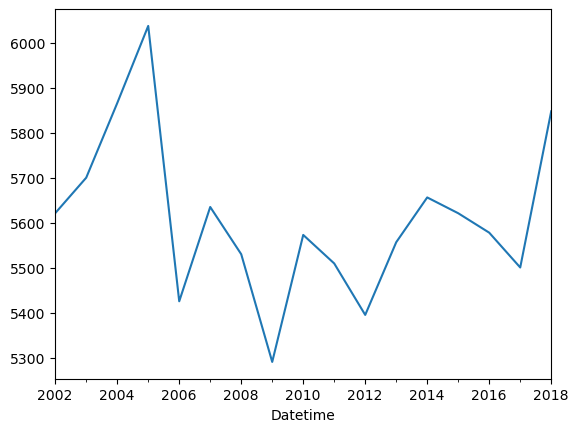

In [32]:
df.PJMW_MW.resample(rule='A').mean().plot()


<AxesSubplot:xlabel='Datetime'>

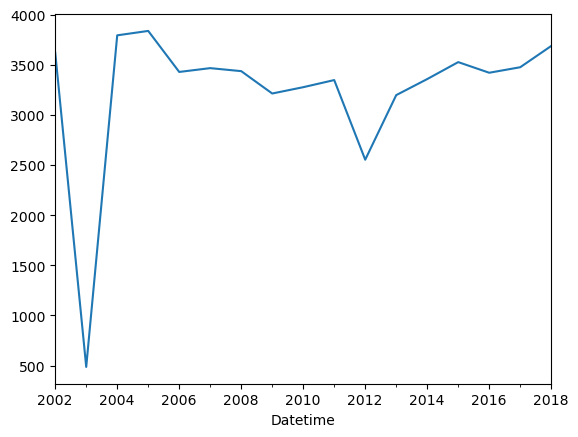

In [33]:
df.PJMW_MW.resample(rule='A').min().plot()


In [34]:
df['2003'].PJMW_MW.resample(rule='A').min()


Datetime
2003-12-31    487.0
Freq: A-DEC, Name: PJMW_MW, dtype: float64

In [35]:
df[df['PJMW_MW']==487.0]


,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29,487.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,0


In [36]:
df['PJMW_MW'].mask(df['PJMW_MW']<500,inplace=True)

In [37]:
df['PJMW_MW']=df.PJMW_MW.interpolate(method='linear')

In [38]:
df['2003-05-29'].head()


,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour
Datetime,,,,,,,,,,,
2003-05-29 00:00:00,4938.5,2003-05-29,2003,5,May,22,2,Thursday,29,149,0
2003-05-29 01:00:00,4560.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,1
2003-05-29 02:00:00,4424.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,2
2003-05-29 03:00:00,4351.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,3
2003-05-29 04:00:00,4337.0,2003-05-29,2003,5,May,22,2,Thursday,29,149,4


<AxesSubplot:xlabel='Datetime'>

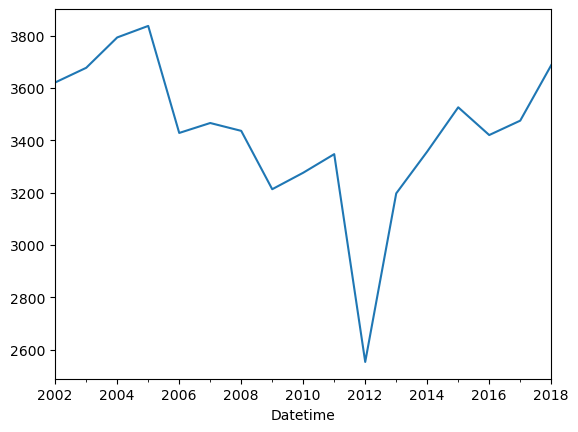

In [39]:
df.PJMW_MW.resample(rule='A').min().plot()

In [40]:
from pandas.tseries.holiday import USFederalHolidayCalendar as calender
cal=calender()
holidays=pd.to_datetime(cal.holidays(df.index.min(),df.index.max()))
df['Date']=pd.to_datetime(df['Date'])
df['Holidays'] = df['Date'].apply(lambda x:1 if x in holidays else 0 )
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays
Datetime,,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1,0
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2,0
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3,0
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4,0
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5,0
...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20,0
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21,0
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22,0


In [41]:
y =[5,6]
df['Weekends']=df['day_of_week_name'].apply(lambda x:1 if x in y else 0)
df['Weekends'].value_counts()

0    143232
Name: Weekends, dtype: int64

In [42]:
df['day_of_week_name'].value_counts()

Tuesday      20472
Wednesday    20472
Thursday     20472
Monday       20471
Friday       20449
Saturday     20448
Sunday       20448
Name: day_of_week_name, dtype: int64

In [43]:
df['Holidays'].value_counts()

0    139344
1      3888
Name: Holidays, dtype: int64

In [44]:
df['Season']='NAN'
summer=[6,7,8,9]
Rainy=[10,11]
winter=[12,1,2]
spring=[3,4,5]
for i in range(0,143232):
    if df['month_name'][i] in summer:
        df['Season'][i]=1
    elif df['month_name'][i] in winter:
        df['Season'][i]=2
    elif df['month_name'][i] in Rainy:
        df['Season'][i]=3
    else: 
        df['Season'][i]=4

In [45]:
df

,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays,Weekends,Season
Datetime,,,,,,,,,,,,,,
2002-04-01 01:00:00,4374.0,2002-04-01,2002,4,April,14,2,Monday,1,91,1,0,0,4
2002-04-01 02:00:00,4306.0,2002-04-01,2002,4,April,14,2,Monday,1,91,2,0,0,4
2002-04-01 03:00:00,4322.0,2002-04-01,2002,4,April,14,2,Monday,1,91,3,0,0,4
2002-04-01 04:00:00,4359.0,2002-04-01,2002,4,April,14,2,Monday,1,91,4,0,0,4
2002-04-01 05:00:00,4436.0,2002-04-01,2002,4,April,14,2,Monday,1,91,5,0,0,4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2018-08-02 20:00:00,6545.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,20,0,0,4
2018-08-02 21:00:00,6496.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,21,0,0,4
2018-08-02 22:00:00,6325.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,22,0,0,4


In [46]:
df['Season'].value_counts()


4    143232
Name: Season, dtype: int64

In [47]:
df['month_name'].value_counts()


May          12648
July         12648
June         12240
April        12239
August       11953
October      11904
December     11904
January      11904
March        11904
September    11520
November     11520
February     10848
Name: month_name, dtype: int64

In [48]:
df.tail(20)


,PJMW_MW,Date,year,month,month_name,week_of_year,quarter,day_of_week_name,day_of_month,day_of_year,hour,Holidays,Weekends,Season
Datetime,,,,,,,,,,,,,,
2018-08-02 05:00:00,4594.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,5,0,0,4
2018-08-02 06:00:00,4826.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,6,0,0,4
2018-08-02 07:00:00,5114.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,7,0,0,4
2018-08-02 08:00:00,5333.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,8,0,0,4
2018-08-02 09:00:00,5597.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,9,0,0,4
2018-08-02 10:00:00,5775.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,10,0,0,4
2018-08-02 11:00:00,6050.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,11,0,0,4
2018-08-02 12:00:00,6152.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,12,0,0,4
2018-08-02 13:00:00,6299.0,2018-08-02,2018,8,August,31,3,Thursday,2,214,13,0,0,4


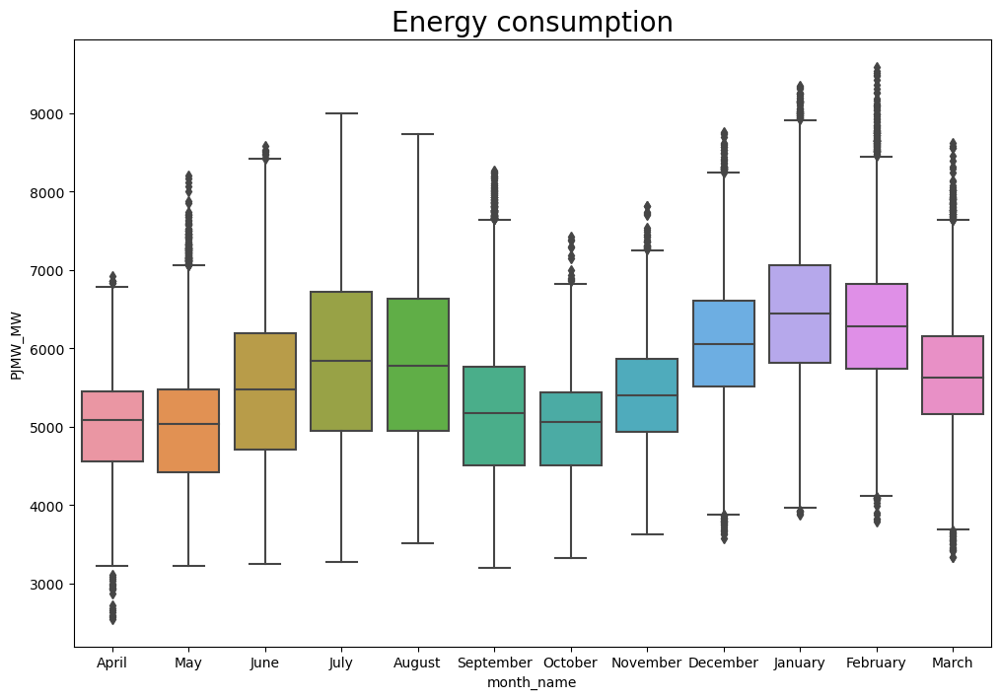

In [49]:
plt.figure(figsize=(12,8))
sns.boxplot(x = 'month_name', y = 'PJMW_MW',data = df)
plt.title('Energy consumption', size = 20)
plt.show()

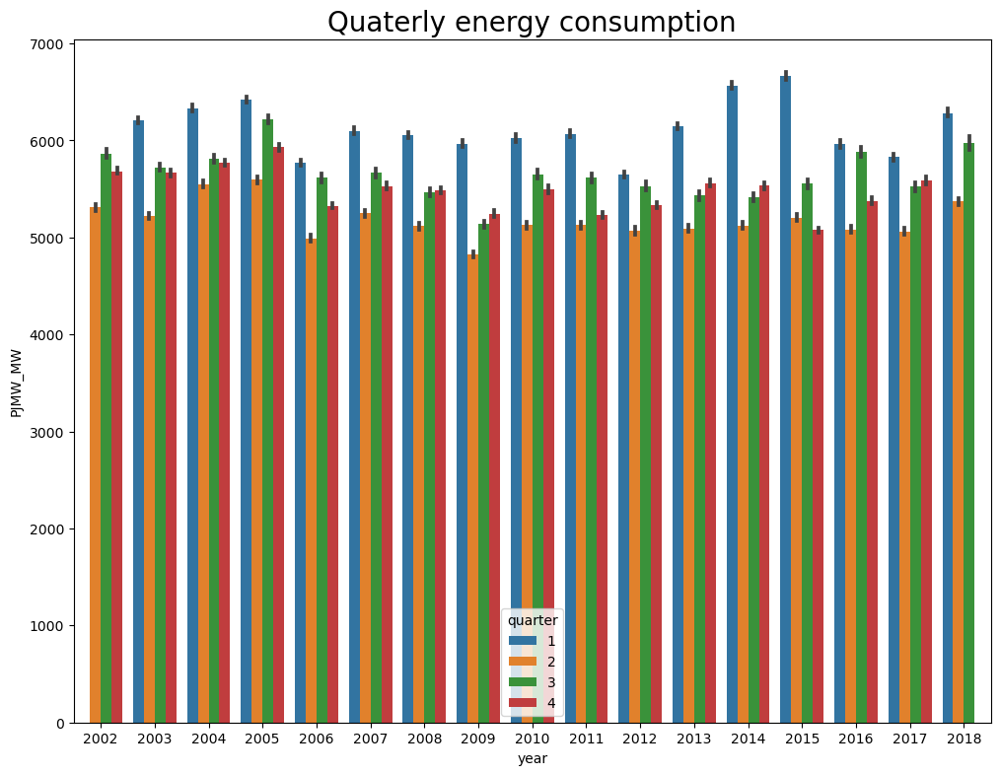

In [50]:
plt.figure(figsize=(12,9))
sns.barplot(x='year',y='PJMW_MW',hue = 'quarter',data =df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

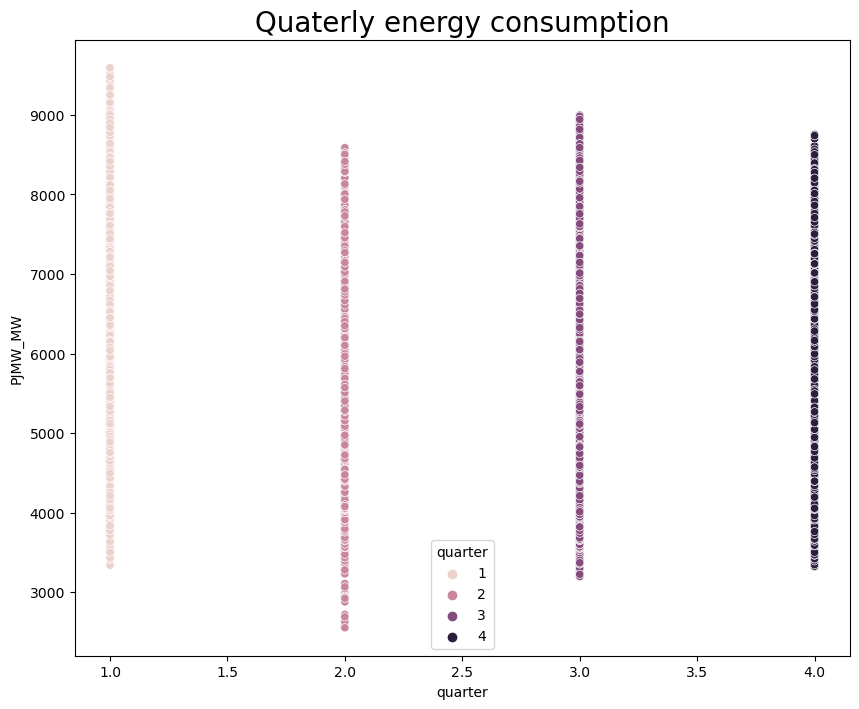

In [51]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='quarter',y='PJMW_MW',hue='quarter', data=df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

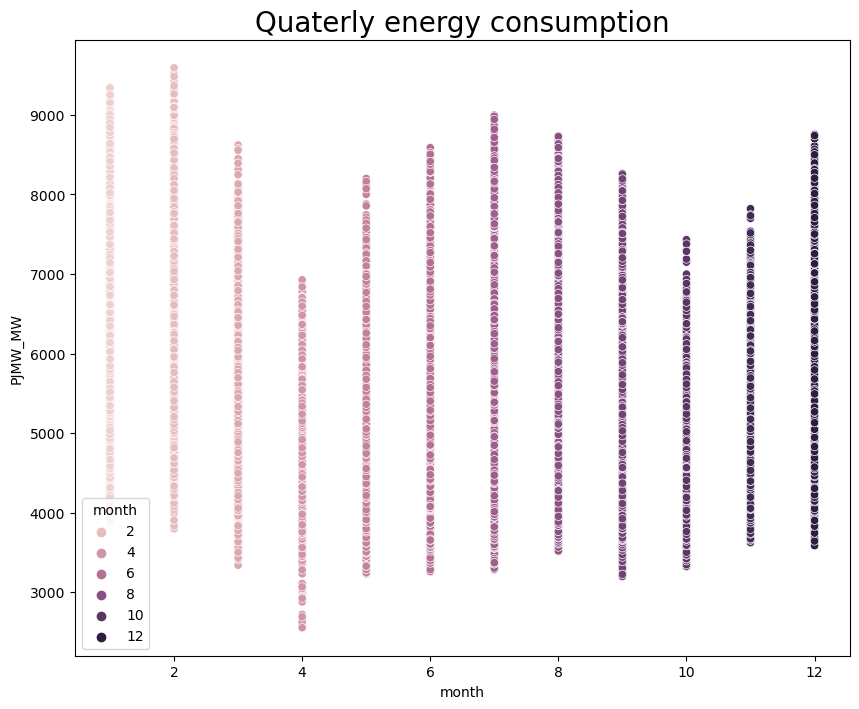

In [52]:
plt.figure(figsize=(10,8))
sns.scatterplot(x='month',y='PJMW_MW',hue='month', data=df)
plt.title('Quaterly energy consumption', size = 20)
plt.show()

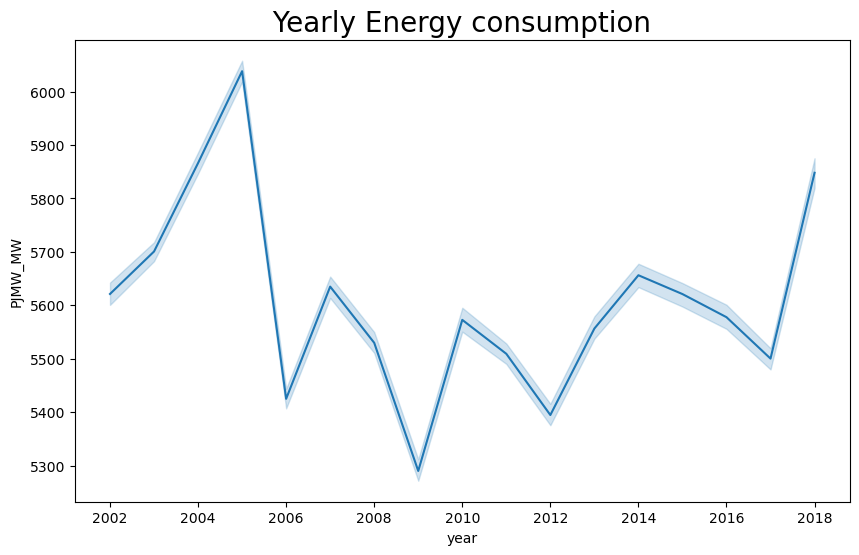

In [53]:
plt.figure(figsize=(10, 6))
sns.lineplot(x=df['year'],y=df['PJMW_MW'],data=df)
plt.title(' Yearly Energy consumption ',size = 20)
plt.show()

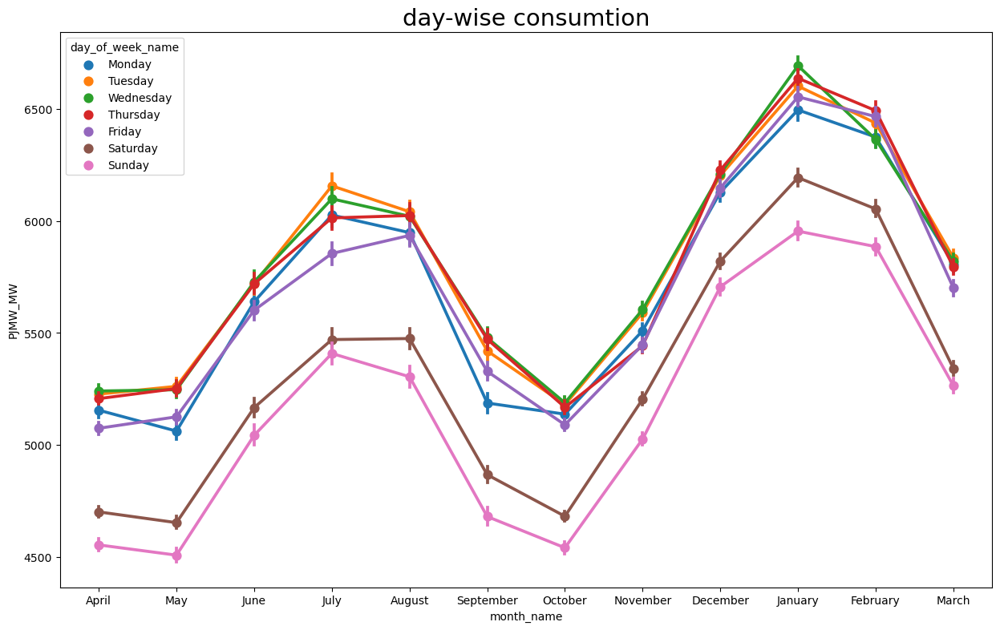

In [54]:
plt.figure(figsize=(15,9))
sns.pointplot(x='month_name', y='PJMW_MW', hue='day_of_week_name', data=df)
plt.title('day-wise consumtion',size = 21)
plt.show()

In [55]:
endmoth_min_energy=df['PJMW_MW'].resample(rule='A').min().head(30)
endmonth_max_energy=df['PJMW_MW'].resample(rule='A').max().head(20)
enegy_range =endmonth_max_energy-endmoth_min_energy
print(enegy_range)

Datetime
2002-12-31    4679.0
2003-12-31    4760.0
2004-12-31    4805.0
2005-12-31    4986.0
2006-12-31    5306.0
2007-12-31    5198.0
2008-12-31    4990.0
2009-12-31    5328.0
2010-12-31    5344.0
2011-12-31    5651.0
2012-12-31    5971.0
2013-12-31    5480.0
2014-12-31    5992.0
2015-12-31    6068.0
2016-12-31    5335.0
2017-12-31    5028.0
2018-12-31    5655.0
Freq: A-DEC, Name: PJMW_MW, dtype: float64


<AxesSubplot:xlabel='Datetime'>

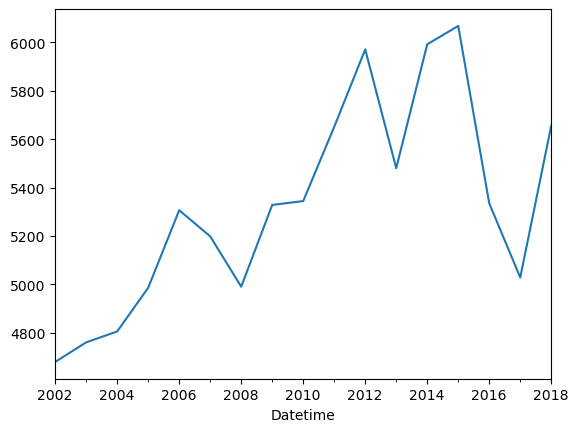

In [56]:
enegy_range.plot()


<AxesSubplot:xlabel='Datetime'>

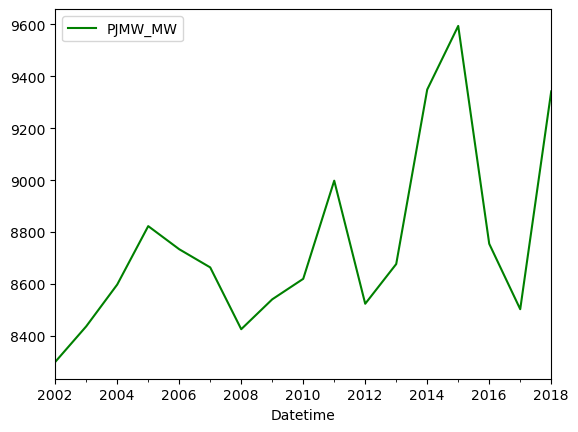

In [57]:
# plot for maximum mw in 2015
df.resample(rule='A').max()['PJMW_MW'].plot(legend= True,color='g')

<AxesSubplot:xlabel='Datetime'>

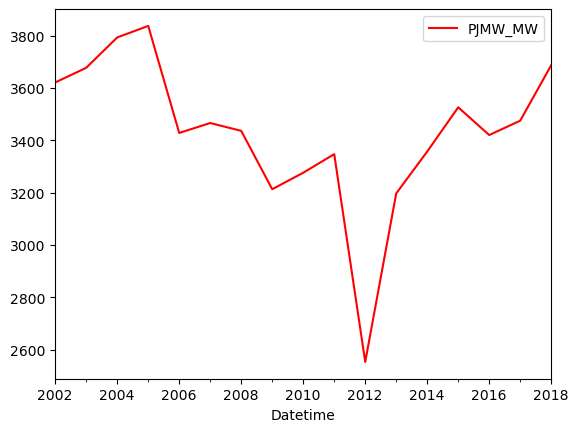

In [58]:
#plot for minimum mw in 2003
df.resample(rule='A').min()['PJMW_MW'].plot(legend= True,color='r')

In [59]:
df['PJMW_MW'].resample(rule='B').max().head()


Datetime
2002-04-01    5978.0
2002-04-02    5797.0
2002-04-03    6317.0
2002-04-04    6254.0
2002-04-05    6240.0
Freq: B, Name: PJMW_MW, dtype: float64

In [60]:
df['PJMW_MW'].resample(rule='B').min().head()

Datetime
2002-04-01    4306.0
2002-04-02    4713.0
2002-04-03    4178.0
2002-04-04    5021.0
2002-04-05    4689.0
Freq: B, Name: PJMW_MW, dtype: float64

In [61]:
df['PJMW_MW'].resample(rule='B').mean().head()

Datetime
2002-04-01    5271.173913
2002-04-02    5310.416667
2002-04-03    5325.916667
2002-04-04    5670.791667
2002-04-05    5368.798611
Freq: B, Name: PJMW_MW, dtype: float64

<AxesSubplot:xlabel='Datetime'>

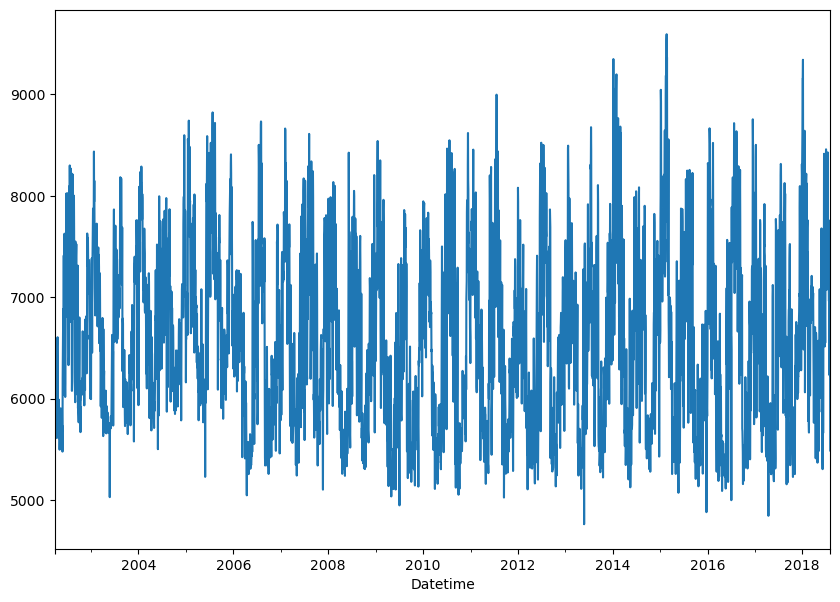

In [62]:
df['PJMW_MW'].resample(rule='B').max().plot(figsize = (10,7))

<AxesSubplot:xlabel='Datetime'>

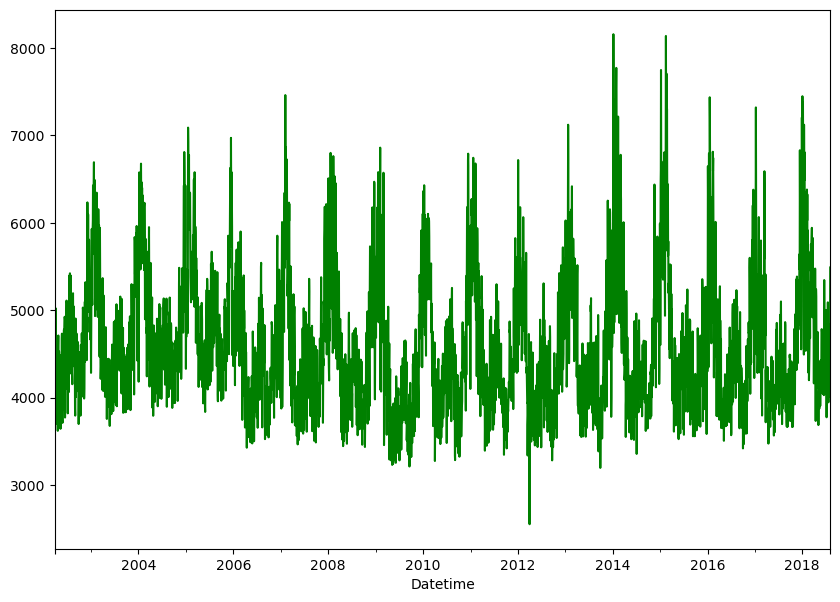

In [63]:
df['PJMW_MW'].resample(rule='B').min().plot(figsize = (10,7),color = 'g')

<AxesSubplot:xlabel='Datetime'>

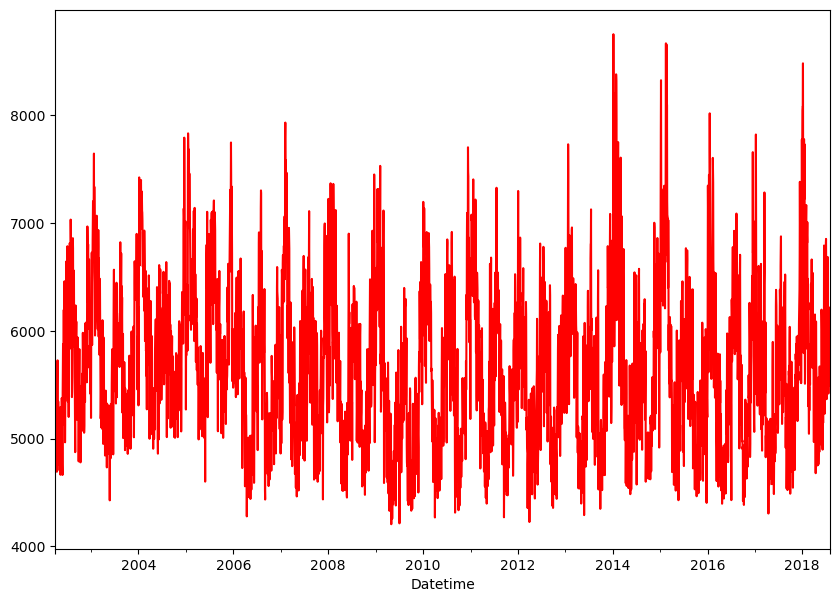

In [64]:
df['PJMW_MW'].resample(rule='B').mean().plot(figsize = (10,7),color = 'r')


In [65]:
# Creating times grouped dataframes in order to analyse them

df_year = df.groupby('year')['PJMW_MW'].sum()
df_month = df.groupby('month_name', sort = False)['PJMW_MW'].sum()
df_week_of_year = df.groupby('week_of_year')['PJMW_MW'].sum()
df_quarter = df.groupby('quarter')['PJMW_MW'].sum()
df_day_of_week = df.groupby('day_of_week_name', sort = False)['PJMW_MW'].sum()
df_day_of_month = df.groupby('day_of_month')['PJMW_MW'].sum()
df_day_of_year = df.groupby('day_of_year')['PJMW_MW'].sum()
df_hour = df.groupby('hour')['PJMW_MW'].sum()

In [66]:
fig = make_subplots(rows=4, cols=2, vertical_spacing = 0.200,
                    subplot_titles=(['Year', 'Month', 'Day of Week', 'Day of Month', 'Week of Year', 'Day of year', 'Hour', 'Quarter']))

fig.add_trace(go.Scatter(x=df_year.index, y = df_year), row=1, col=1)
fig.add_trace(go.Scatter(x=df_month.index, y=df_month), row=1, col=2)
fig.add_trace(go.Scatter(x=df_week_of_year.index, y=df_week_of_year), row=3, col=1)
fig.add_trace(go.Scatter(x=df_day_of_week.index, y=df_day_of_week), row=2, col=1)
fig.add_trace(go.Scatter(x=df_day_of_month.index, y=df_day_of_month), row=2, col=2)
fig.add_trace(go.Scatter(x=df_day_of_year.index, y=df_day_of_year), row=3, col=2)
fig.add_trace(go.Scatter(x=df_hour.index, y=df_hour), row=4, col=1)
fig.add_trace(go.Scatter(x=df_quarter.index, y=df_quarter), row=4, col=2)

fig.update_layout(title = 'Energy Consumption of PJME per', height = 700, showlegend = False)

fig.show()

In [67]:
# BY using slider function it is easy to visulalize
figure = px.line(df, x=df.index, y = df.PJMW_MW)

figure.update_layout(title = "Energy Consumption of PJME from year  2002 to 2018", 
                  yaxis_title="Energy (MW)", 
                  xaxis_title="Date", 
                  xaxis_rangeslider_visible=True)
figure.show()


In [68]:
df.corr()


,PJMW_MW,year,month,week_of_year,quarter,day_of_month,day_of_year,hour,Holidays,Weekends
PJMW_MW,1.000000,-0.046837,-0.152383,-0.151562,-0.159915,-0.006072,-0.150875,4.473128e-01,-1.447481e-02,NaN
year,-0.046837,1.000000,-0.077682,-0.076304,-0.077328,-0.001896,-0.077423,-3.923280e-05,-1.040085e-03,NaN
month,-0.152383,-0.077682,1.000000,0.970054,0.970840,0.010207,0.996439,-1.356767e-05,2.549798e-02,NaN
week_of_year,-0.151562,-0.076304,0.970054,1.000000,0.945407,0.067433,0.971517,-1.319881e-05,3.512584e-02,NaN
quarter,-0.159915,-0.077328,0.970840,0.945407,1.000000,0.011954,0.967611,-1.047025e-05,3.483795e-02,NaN
day_of_month,-0.006072,-0.001896,0.010207,0.067433,0.011954,1.000000,0.094187,-2.635322e-06,-1.552202e-02,NaN
day_of_year,-0.150875,-0.077423,0.996439,0.971517,0.967611,0.094187,1.000000,-1.375583e-05,2.455236e-02,NaN
hour,0.447313,-0.000039,-0.000014,-0.000013,-0.000010,-0.000003,-0.000014,1.000000e+00,-3.705443e-18,NaN
Holidays,-0.014475,-0.001040,0.025498,0.035126,0.034838,-0.015522,0.024552,-3.705443e-18,1.000000e+00,NaN
Weekends,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


<Figure size 2000x1200 with 0 Axes>

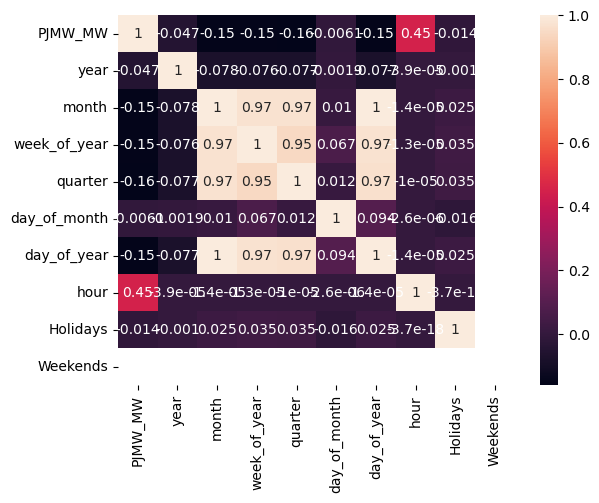

<Figure size 2000x1200 with 0 Axes>

In [69]:
sns.heatmap(df.corr(),annot=True)
plt.figure(figsize = (20,12))

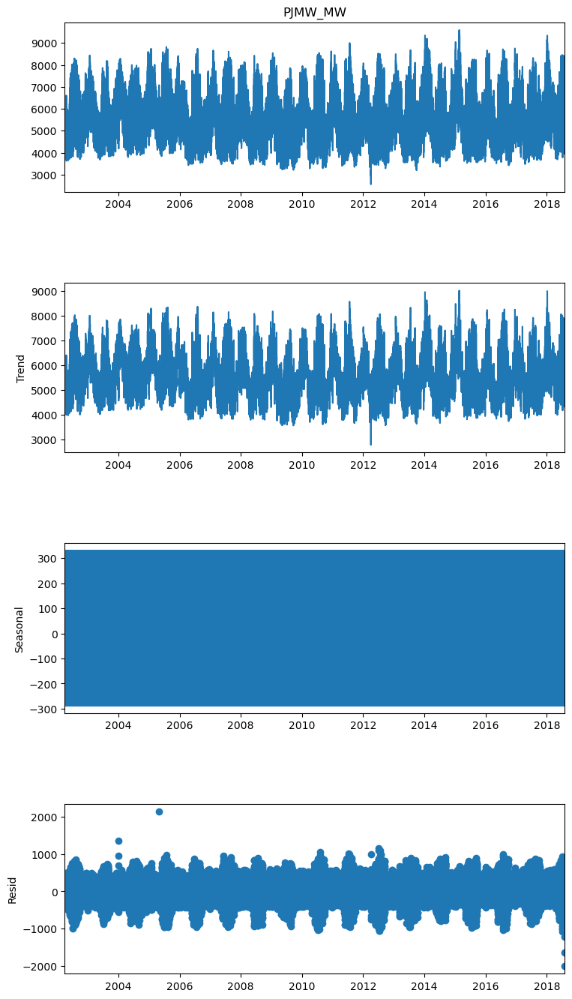

In [70]:
#Seasonal Decompose
import statsmodels.api as sm

from statsmodels.tsa.seasonal import seasonal_decompose

ts_add = seasonal_decompose(df.PJMW_MW,model="additive",extrapolate_trend = 'freq',period = 12)
fig = ts_add.plot()
fig.set_figheight(15)
fig.set_figwidth(8)
plt.show()

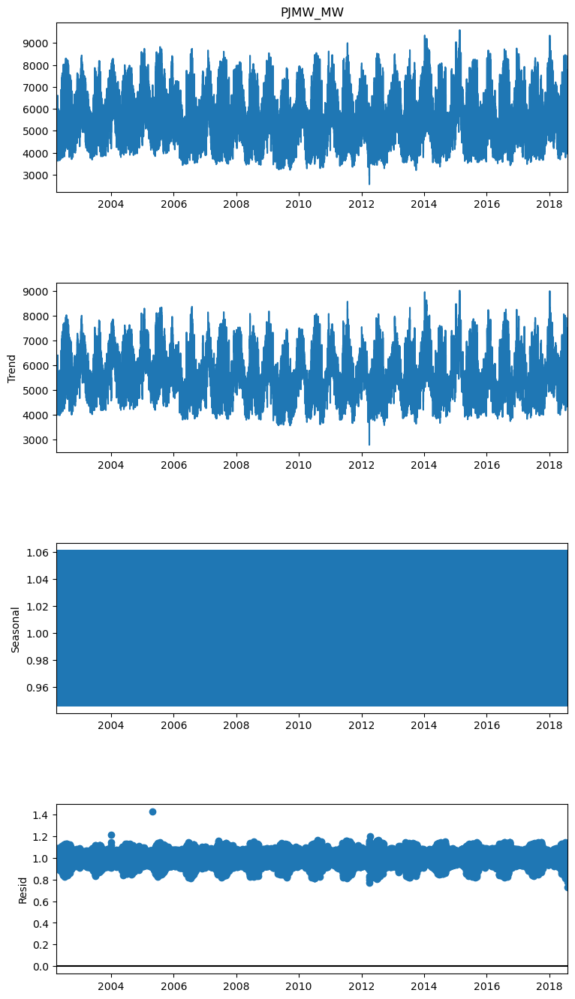

In [71]:
ts_mul = seasonal_decompose(df.PJMW_MW,model="multiplicative",extrapolate_trend = 'freq',period = 12)
fig = ts_mul.plot()
fig.set_figheight(15)
fig.set_figwidth(8)
plt.show()

In [72]:
df = pjm_data.copy()
df

,PJMW_MW
Datetime,
2002-04-01 01:00:00,4374.0
2002-04-01 02:00:00,4306.0
2002-04-01 03:00:00,4322.0
2002-04-01 04:00:00,4359.0
2002-04-01 05:00:00,4436.0
...,...
2018-08-02 20:00:00,6545.0
2018-08-02 21:00:00,6496.0
2018-08-02 22:00:00,6325.0


In [73]:
df_month = df.resample(rule = 'M').mean()

In [74]:
df_month


,PJMW_MW
Datetime,
2002-04-30,5170.892211
2002-05-31,5085.094086
2002-06-30,5685.681944
2002-07-31,6097.877688
2002-08-31,6063.909946
...,...
2018-04-30,5281.277778
2018-05-31,5278.620968
2018-06-30,5559.326389


In [75]:
def adf_test(series):
    result =adfuller(series)
    print('ADF Statistics: {}'.format(result[0]))
    print('p-values: {}'.format(result[1]))
    if result[1]<=0.05:
        print('Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary')
    else:
        print('weak avidence against the null hypothsis,time series has a unit root , indicating it is no -stationary')

In [76]:
adf_test(df_month['PJMW_MW'])

ADF Statistics: -2.8947558399262023
p-values: 0.04596122930503252
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


<AxesSubplot:xlabel='Datetime'>

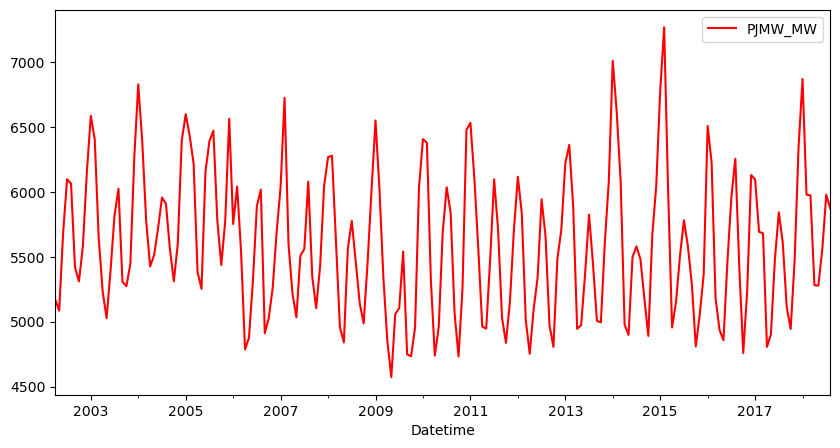

In [77]:
df_month.plot(figsize= (10,5),color='r')

In [78]:
result1=seasonal_decompose(df_month['PJMW_MW'], model='additive', period=12)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

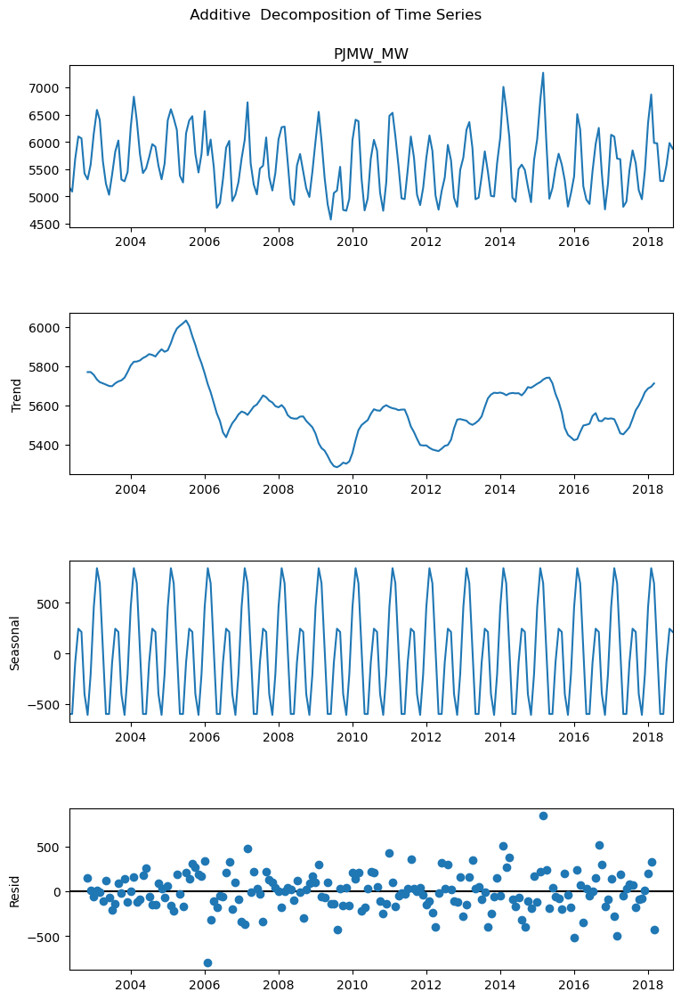

In [79]:
fig = result1.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

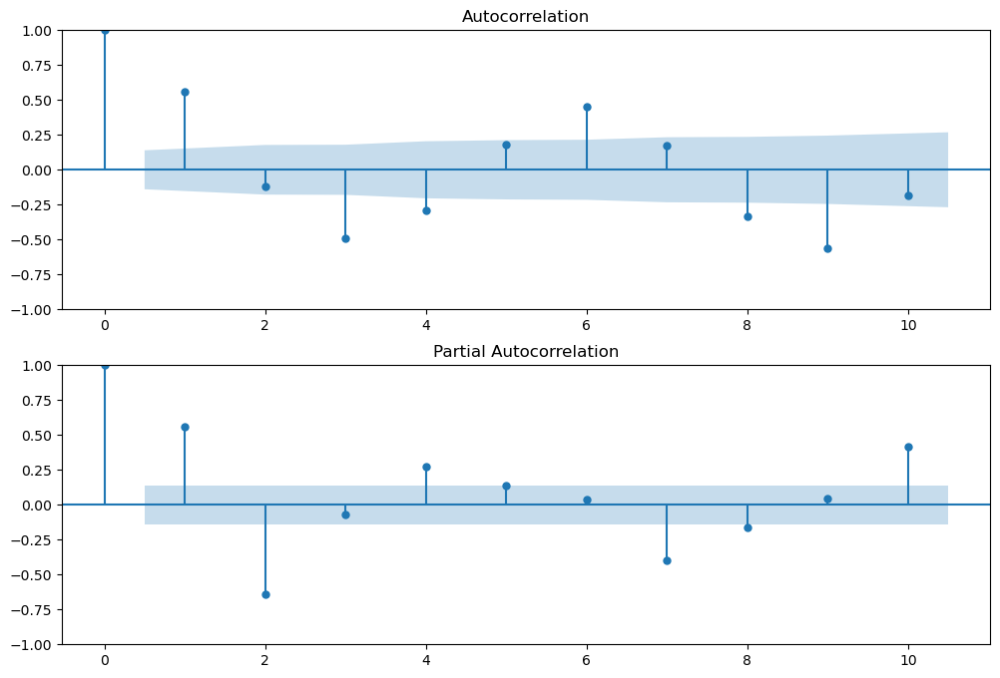

In [80]:
## seeing the acf and pacf graph for days data

fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_month['PJMW_MW'],lags=10,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_month['PJMW_MW'],lags=10,ax=ax2)

In [81]:
df_daily  = df.resample(rule = 'D').mean()
df_daily.head()

,PJMW_MW
Datetime,
2002-04-01,5271.173913
2002-04-02,5310.416667
2002-04-03,5325.916667
2002-04-04,5670.791667
2002-04-05,5686.125000


In [206]:
df_daily.to_csv(r'D:\dfdaily.csv')


In [83]:
df_daily.describe()


,PJMW_MW
count,5969.000000
mean,5602.193906
std,737.789742
min,3018.041667
25%,5043.875000
50%,5522.458333
75%,6085.750000
max,8794.583333


In [84]:
result_add=seasonal_decompose(df_daily['PJMW_MW'], model='additive', period=365)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

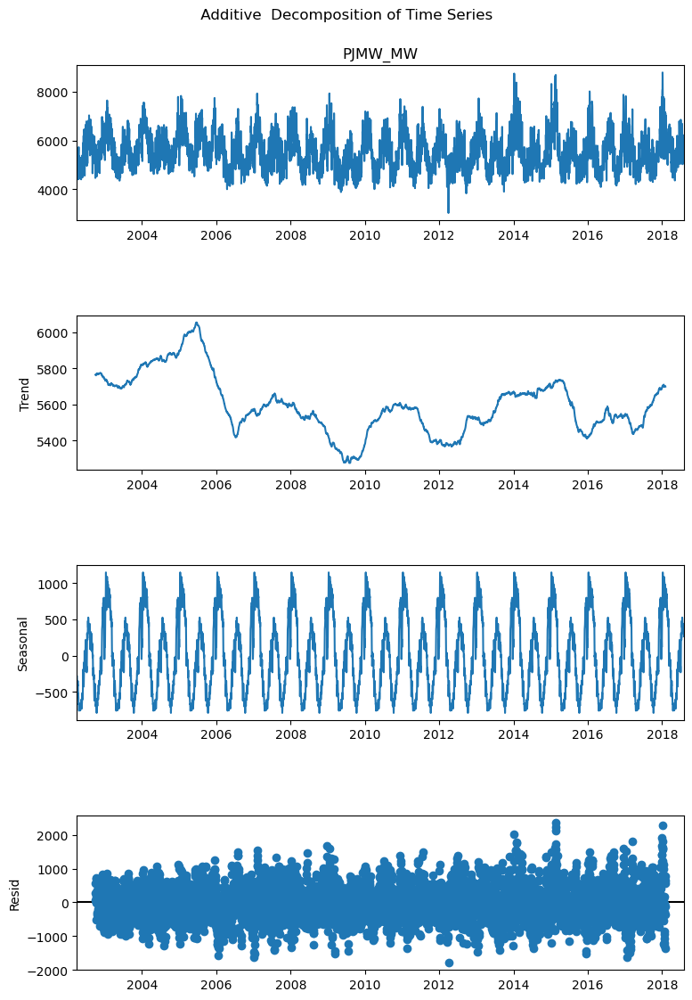

In [85]:
fig = result_add.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

In [86]:
result_mul=seasonal_decompose(df_daily['PJMW_MW'], model='mul', period=365)

Text(0.5, 0.98, ' Mulplicative  Decomposition of Time Series')

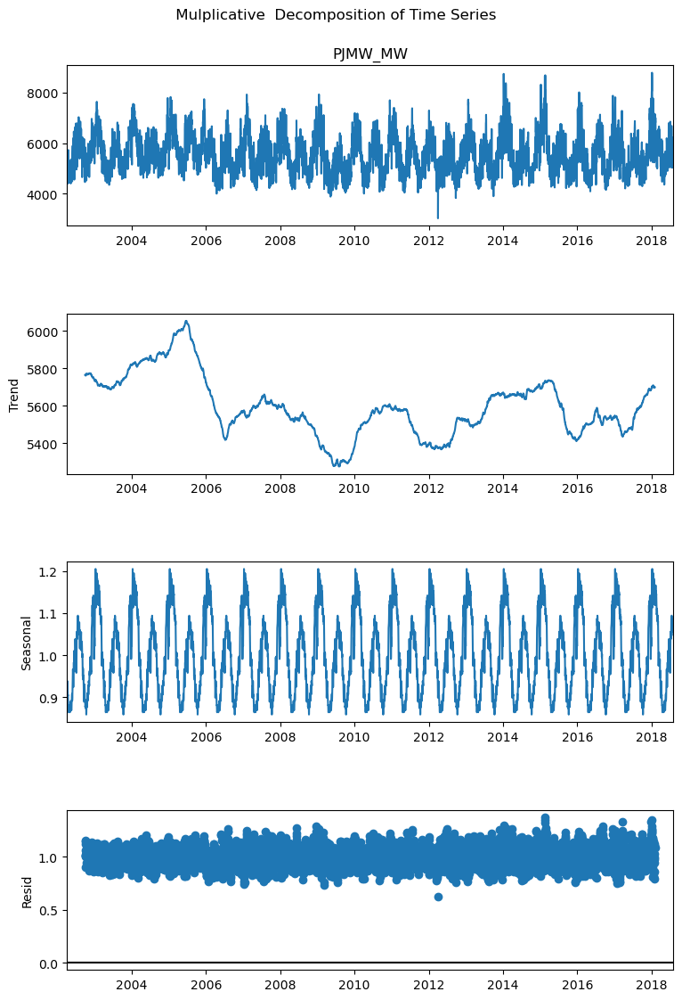

In [87]:
fig = result_mul.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Mulplicative  Decomposition of Time Series')

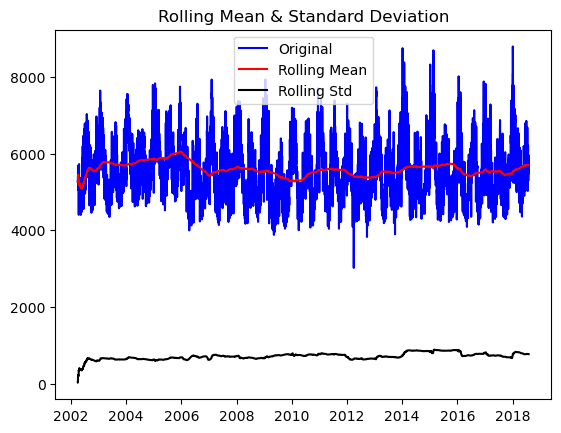

ADF Statistics: -7.2652434833525605
p-values: 1.6415165880026629e-10
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [88]:
#Determing rolling statistics for yearly basis
   
rolmean =df_daily['PJMW_MW'] .rolling(window=365,min_periods=1).mean()
    
rolstd =df_daily['PJMW_MW'].rolling(window=365,min_periods=1).std()


 #Plot rolling statistics:
orig = plt.plot(df_daily, color='blue',label='Original')
mean = plt.plot(rolmean, color='red', label='Rolling Mean')
std = plt.plot(rolstd, color='black', label = 'Rolling Std')
plt.legend(loc='best')
plt.title('Rolling Mean & Standard Deviation')
plt.show(block=False)
adf_test(df_daily['PJMW_MW'])

In [89]:
result_mul=seasonal_decompose(rolmean.dropna(), model='mul',period=365)

Text(0.5, 0.98, ' Additive  Decomposition of Time Series')

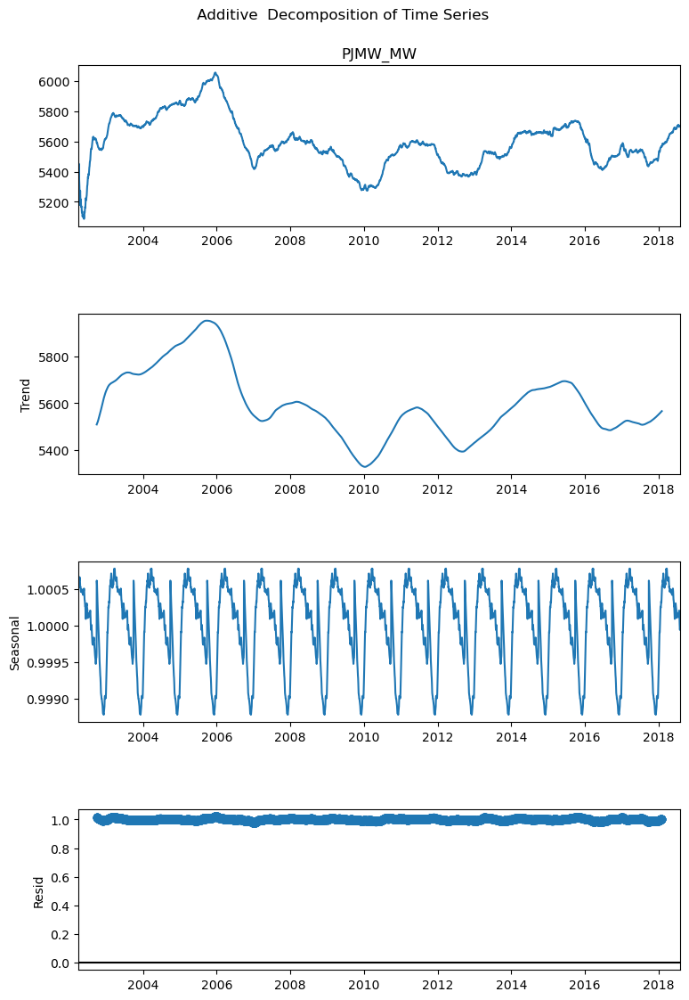

In [90]:
fig = result_mul.plot()
fig.set_figheight(12)
fig.set_figwidth(8)
fig.suptitle(' Additive  Decomposition of Time Series')

In [91]:
#ACF and PACF plots:
from statsmodels.tsa.stattools import acf, pacf 

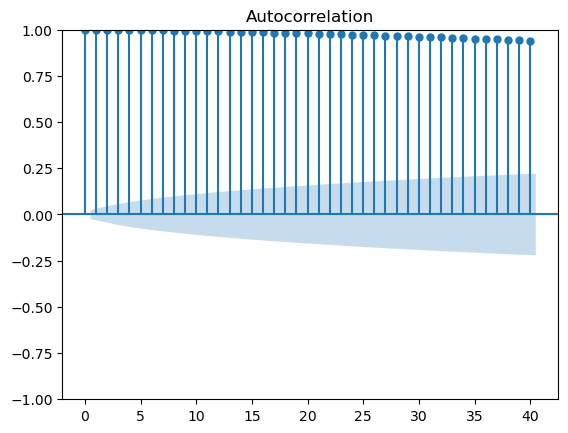

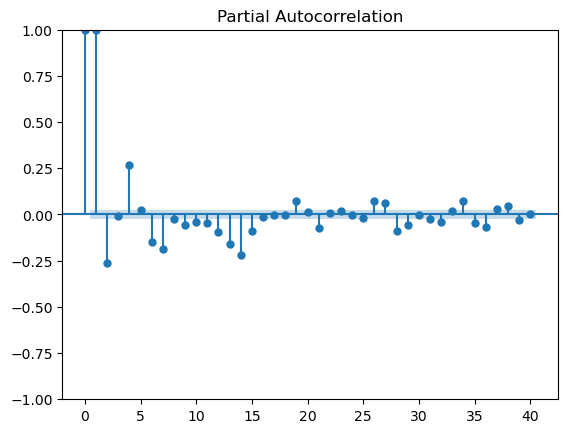

In [92]:
lag_acf = plot_acf(rolmean.dropna(), lags=40)
lag_pacf = plot_pacf(rolmean.dropna(), lags=40)

ADF Statistics: -7.944404396491014
p-values: 3.248966872307294e-12
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


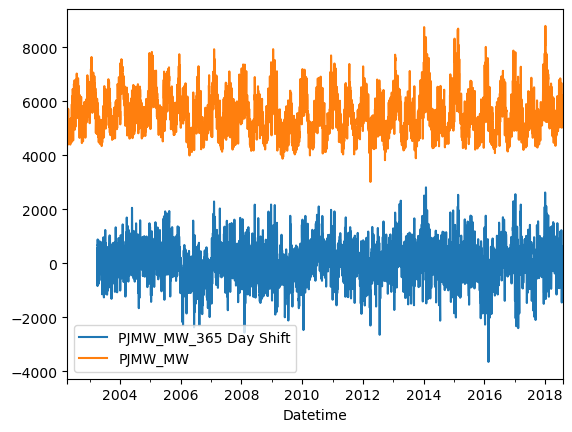

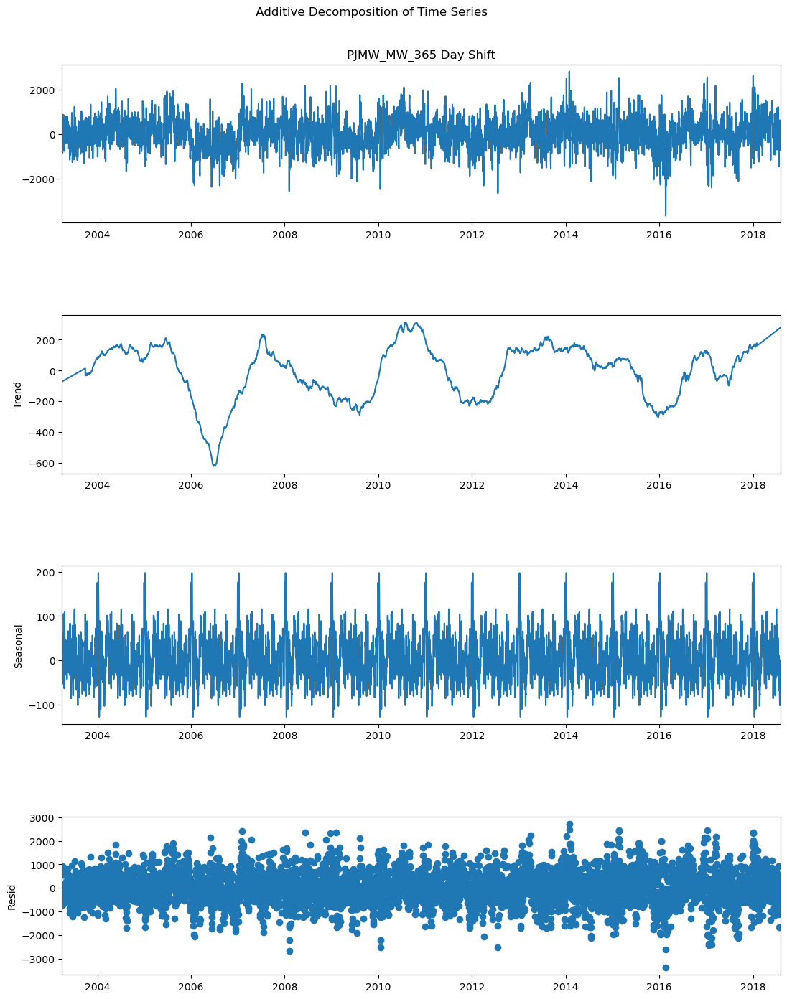

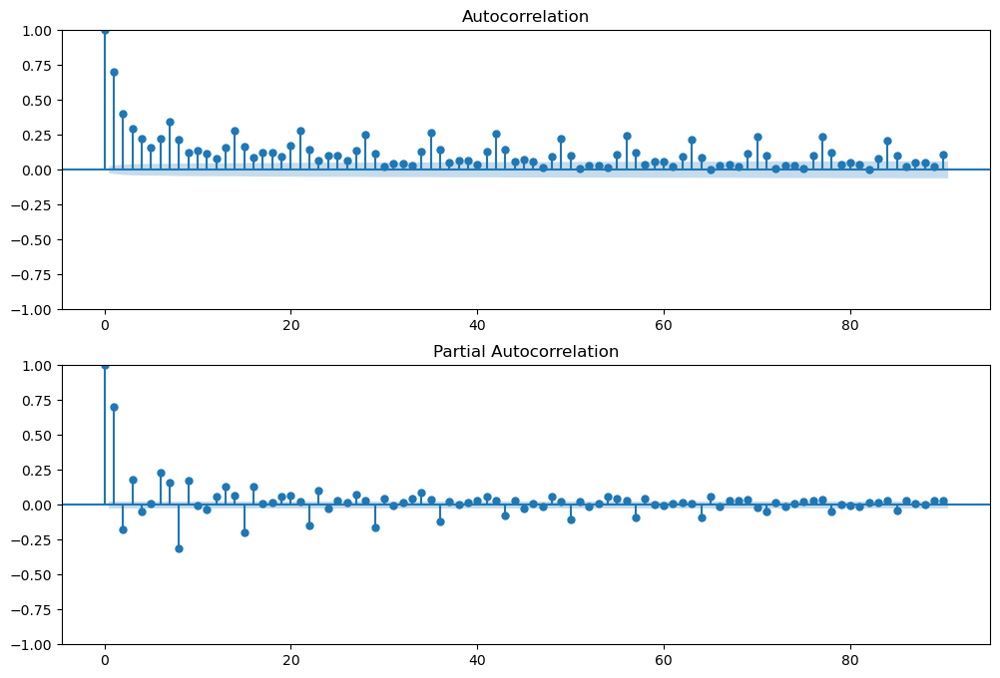

In [93]:
df_daily['PJMW_MW_365 Day Shift'] = df_daily['PJMW_MW']- df_daily['PJMW_MW'].shift(365)


## Again test dickey fuller test after changing to daily 365 day shift
adf_test(df_daily['PJMW_MW_365 Day Shift'].dropna())


df_daily[['PJMW_MW_365 Day Shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_365 Day Shift'].dropna(),model="addative",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_365 Day Shift'].dropna(),lags=90,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_365 Day Shift'].dropna(),lags=90,ax=ax2)

ADF Statistics: -9.193693067246592
p-values: 2.0901318753862775e-15
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


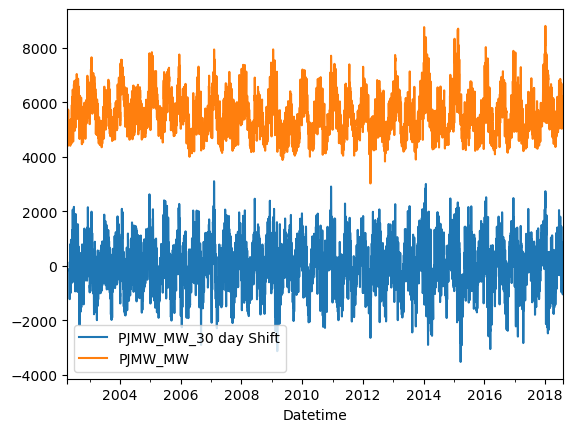

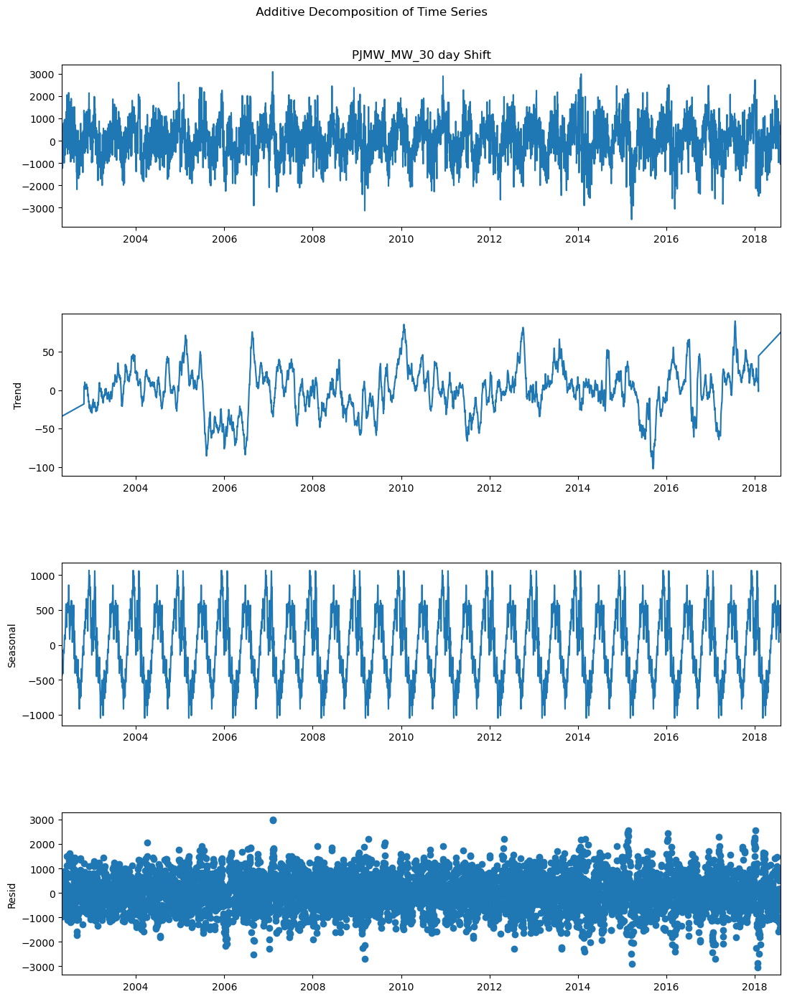

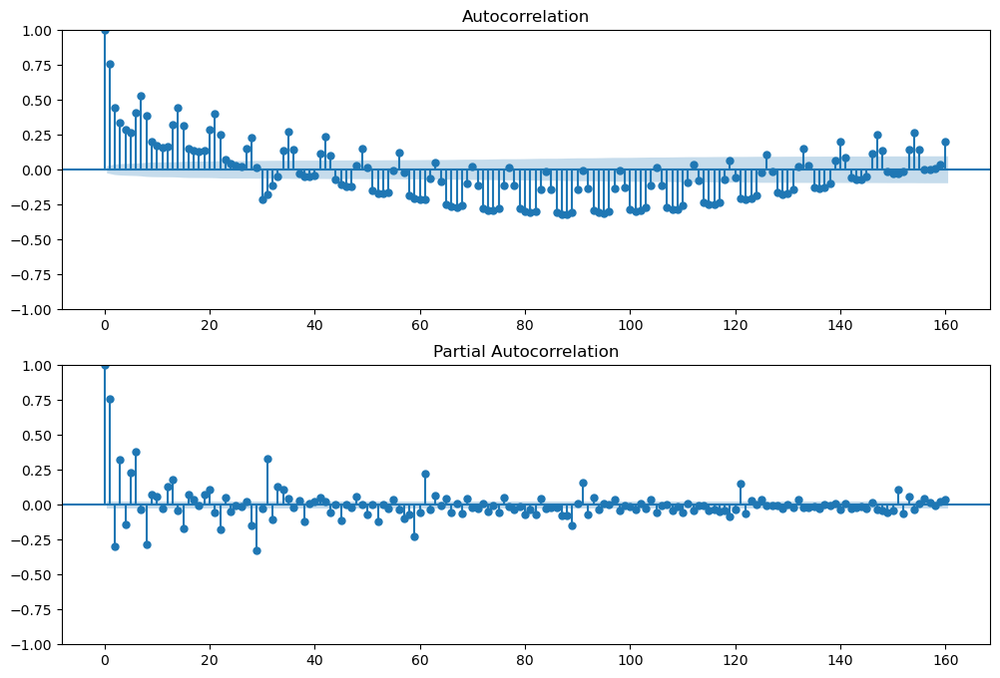

In [94]:
df_daily['PJMW_MW_30 day Shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(30)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_30 day Shift'].dropna())


df_daily[['PJMW_MW_30 day Shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_30 day Shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_30 day Shift'].dropna(),lags=160,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_30 day Shift'].dropna(),lags=160,ax=ax2)

ADF Statistics: -7.60700285481104
p-values: 2.308043782843623e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


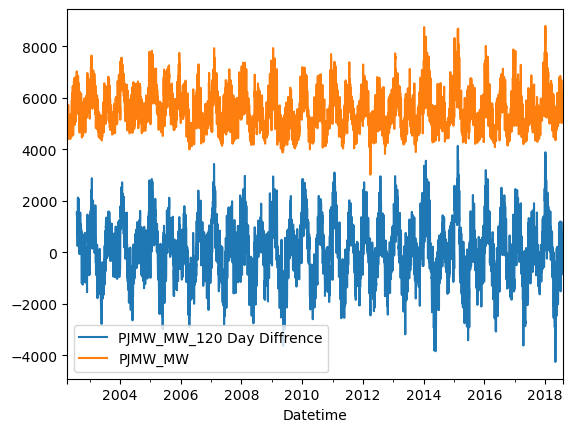

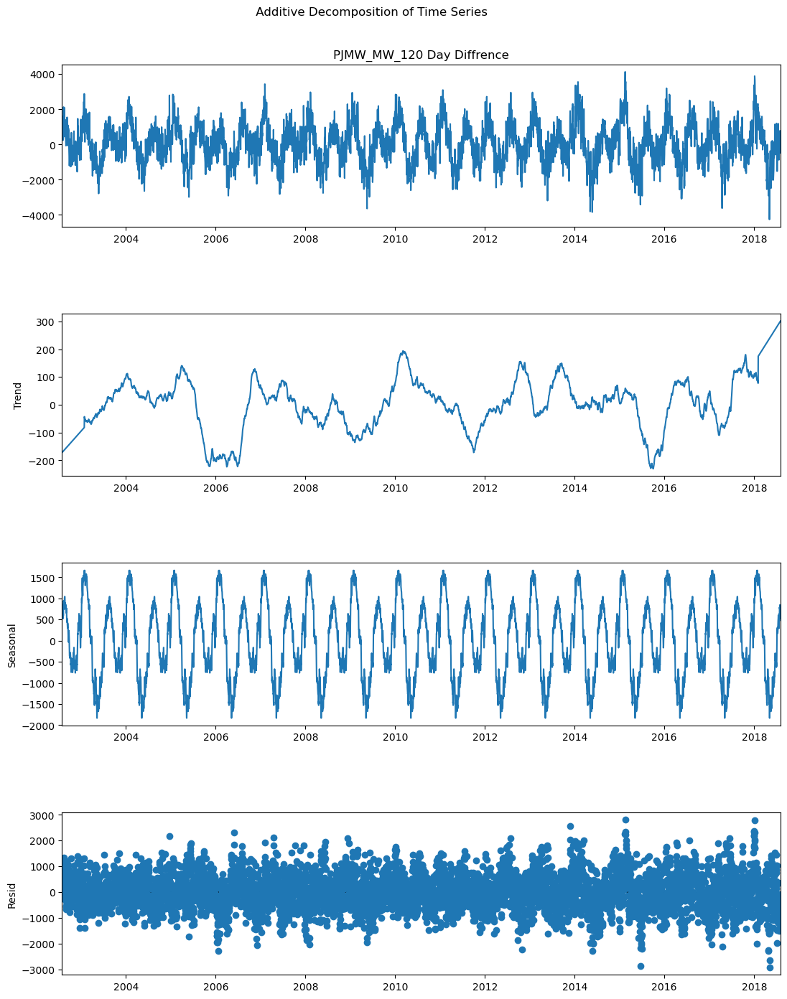

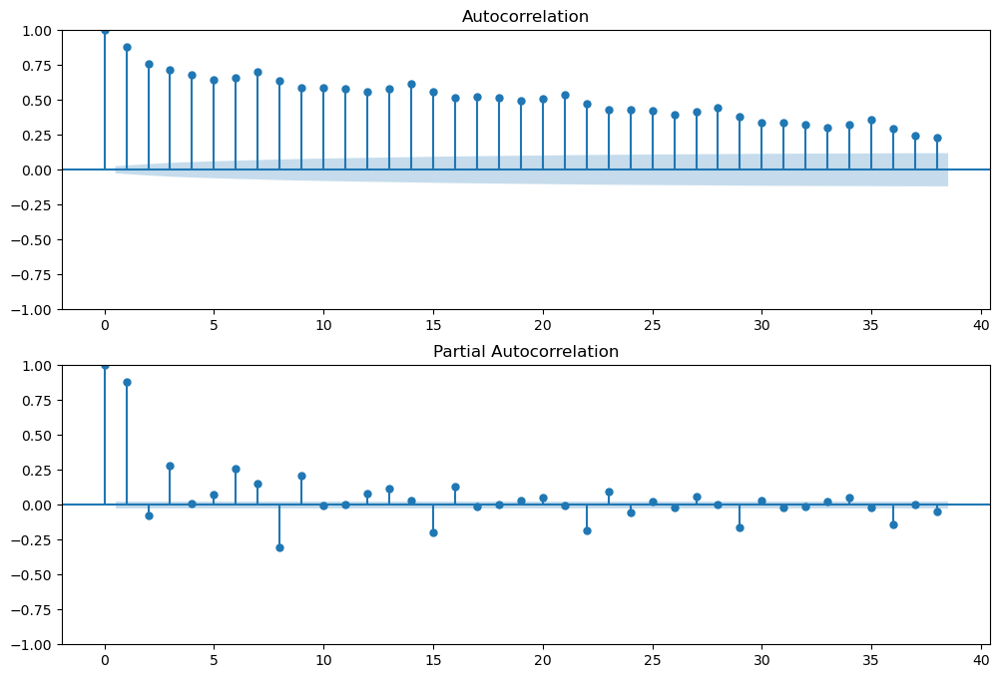

In [95]:
df_daily['PJMW_MW_120 Day Diffrence'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(120)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_120 Day Diffrence'].dropna())


df_daily[['PJMW_MW_120 Day Diffrence','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_120 Day Diffrence'].dropna(),ax=ax2)

ADF Statistics: -13.97513857971994
p-values: 4.2752184342048377e-26
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


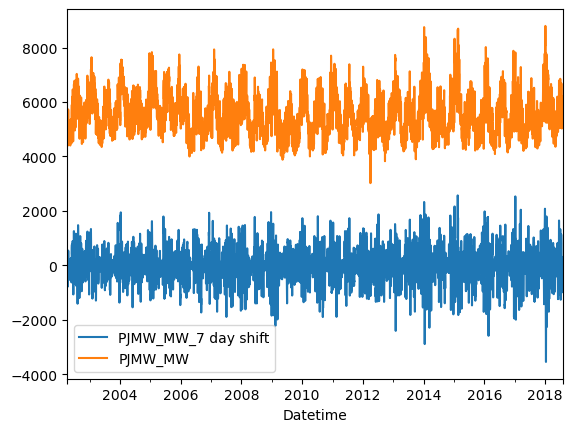

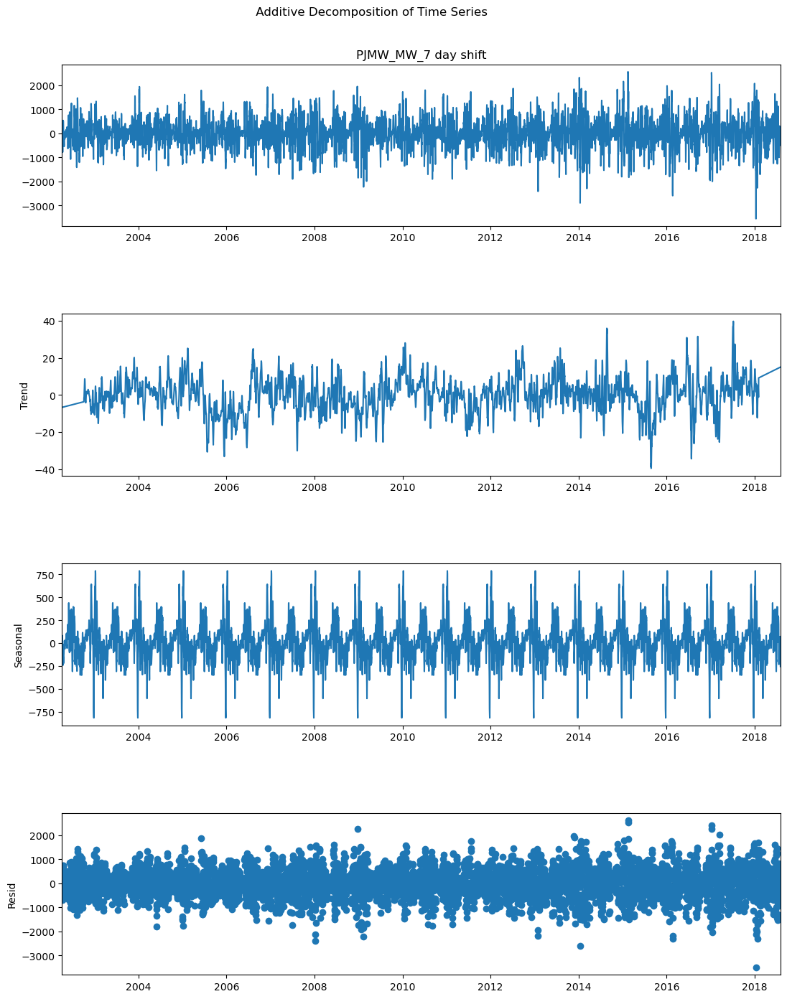

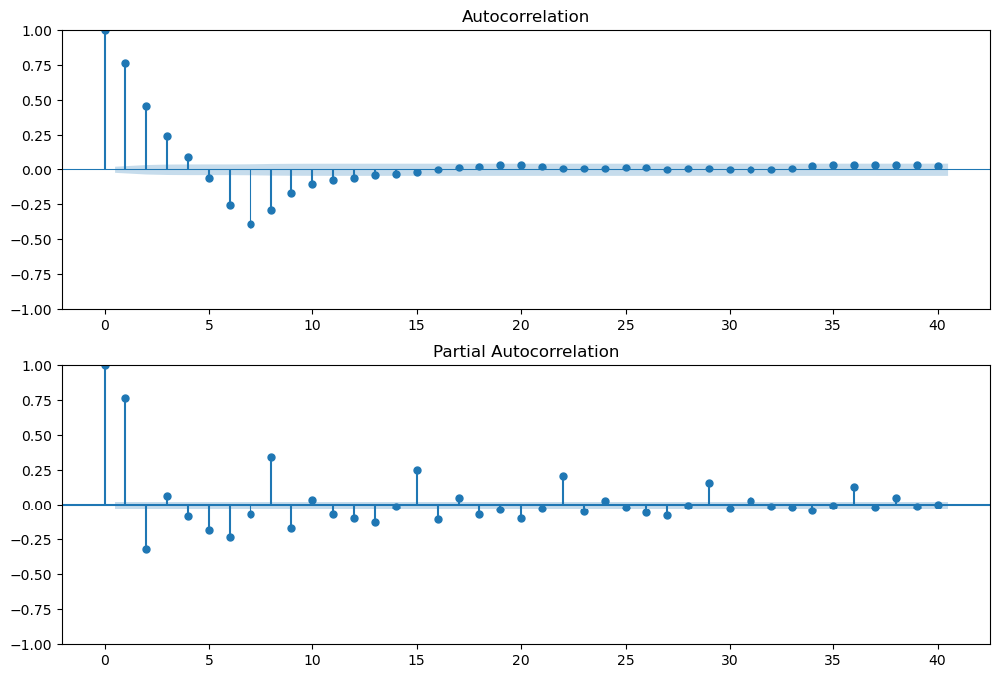

In [96]:
df_daily['PJMW_MW_7 day shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift(7)


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_7 day shift'].dropna())


df_daily[['PJMW_MW_7 day shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_7 day shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_7 day shift'].dropna(),lags=40,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_7 day shift'].dropna(),lags=40,ax=ax2)

ADF Statistics: -14.39691544953562
p-values: 8.636781700455097e-27
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


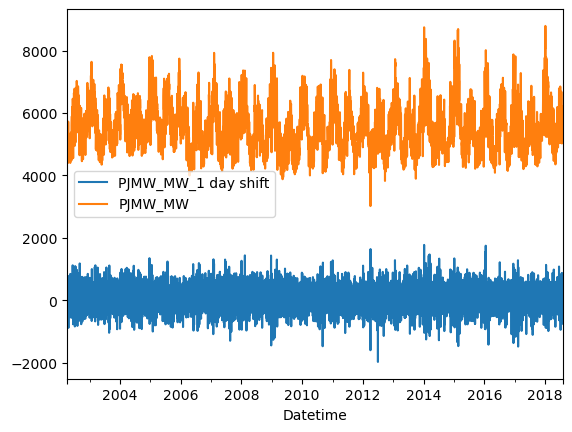

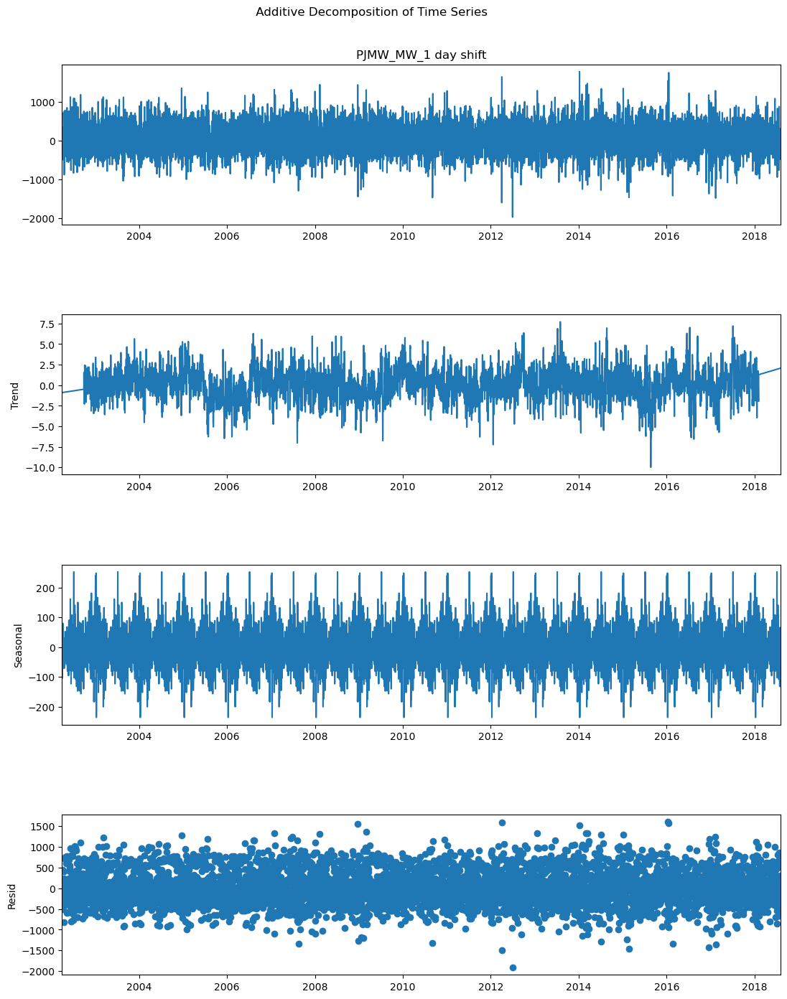

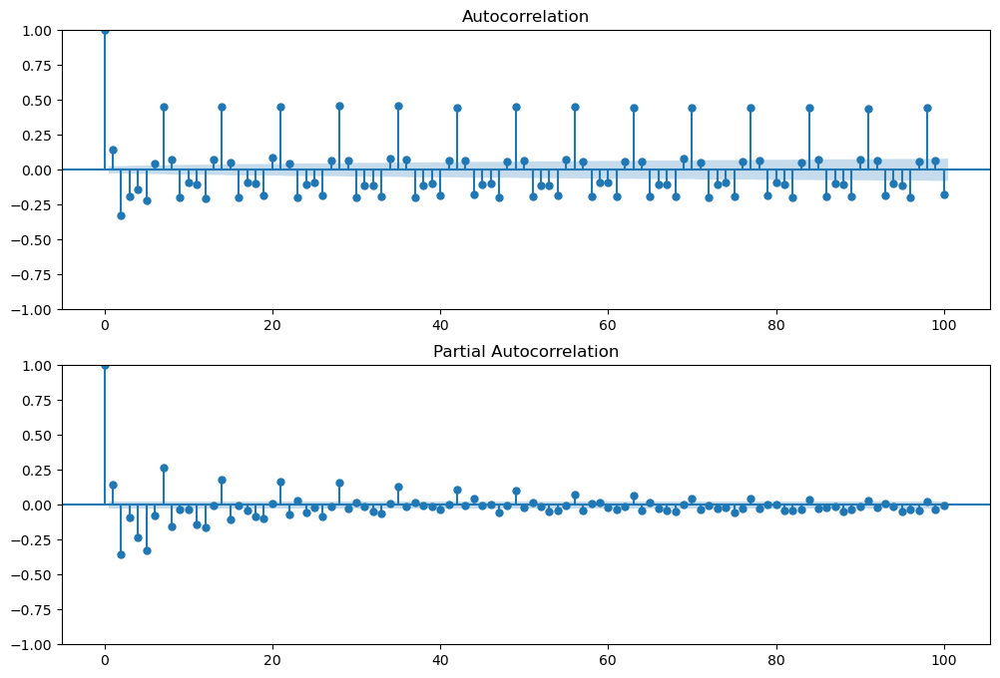

In [97]:
df_daily['PJMW_MW_1 day shift'] = df_daily['PJMW_MW']-df_daily['PJMW_MW'].shift()


## Again test dickey fuller test after changing to daily 1 day differencing
adf_test(df_daily['PJMW_MW_1 day shift'].dropna())


df_daily[['PJMW_MW_1 day shift','PJMW_MW']].plot()
add_decompose = seasonal_decompose(df_daily['PJMW_MW_1 day shift'].dropna(),model="add",extrapolate_trend='freq',period=365)
fig = add_decompose.plot()
fig.set_figheight(15)
fig.set_figwidth(12)
fig.suptitle(' Additive Decomposition of Time Series')



fig = plt.figure(figsize=(12,8))
ax1 =fig.add_subplot(211)
fig = sm.graphics.tsa.plot_acf(df_daily['PJMW_MW_1 day shift'].dropna(),lags=100,ax=ax1)
ax2 = fig.add_subplot(212)
fig = sm.graphics.tsa.plot_pacf(df_daily['PJMW_MW_1 day shift'].dropna(),lags=100,ax=ax2)

Text(0.5, 1.0, '2nd Order Differencing')

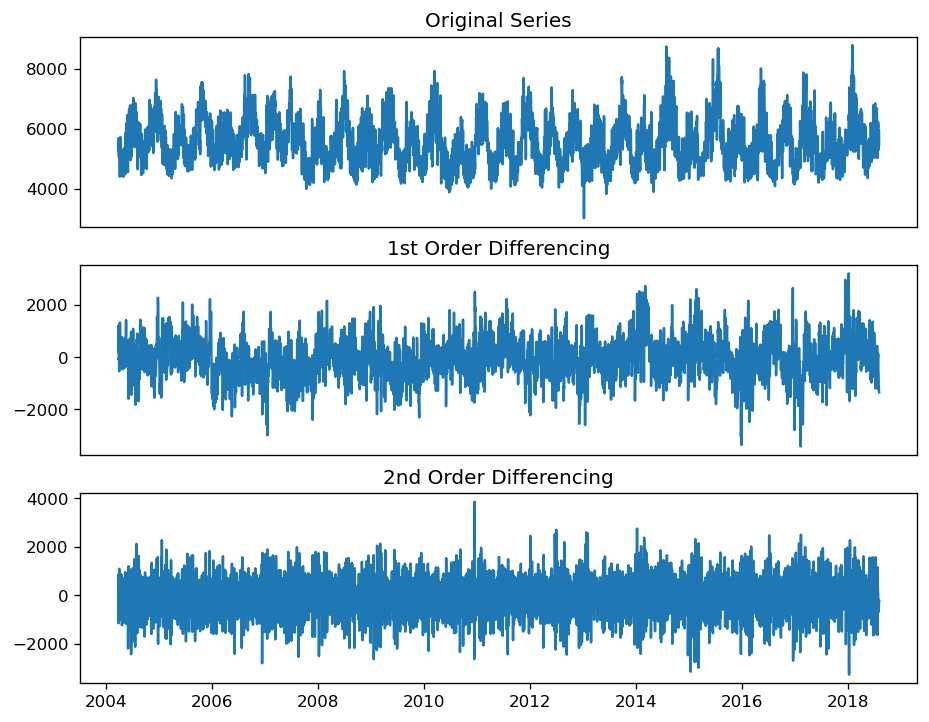

In [98]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(720)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(720).diff(2)); ax3.set_title('2nd Order Differencing')

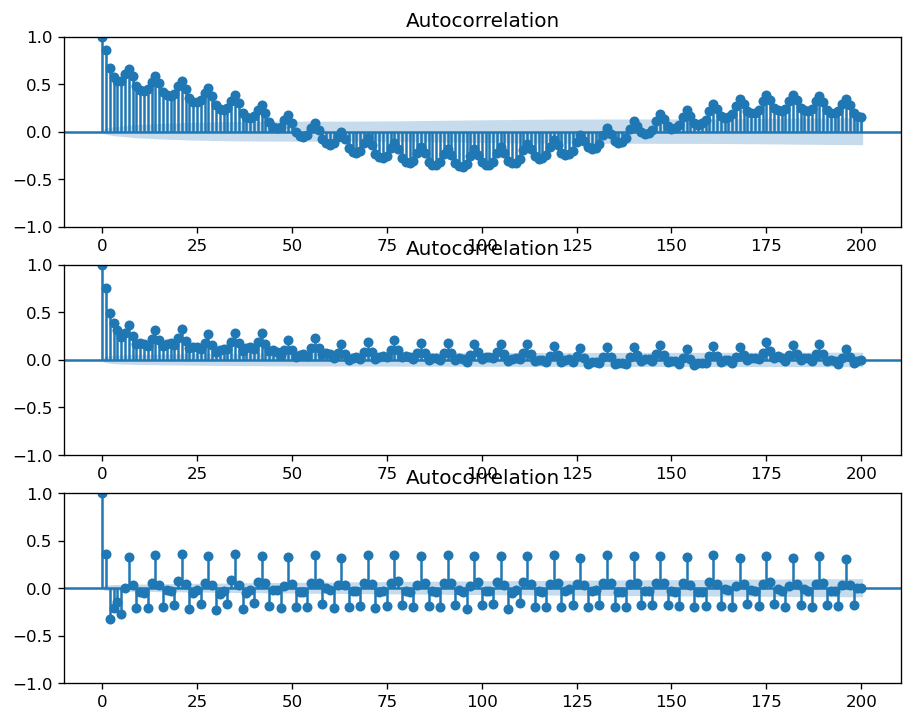

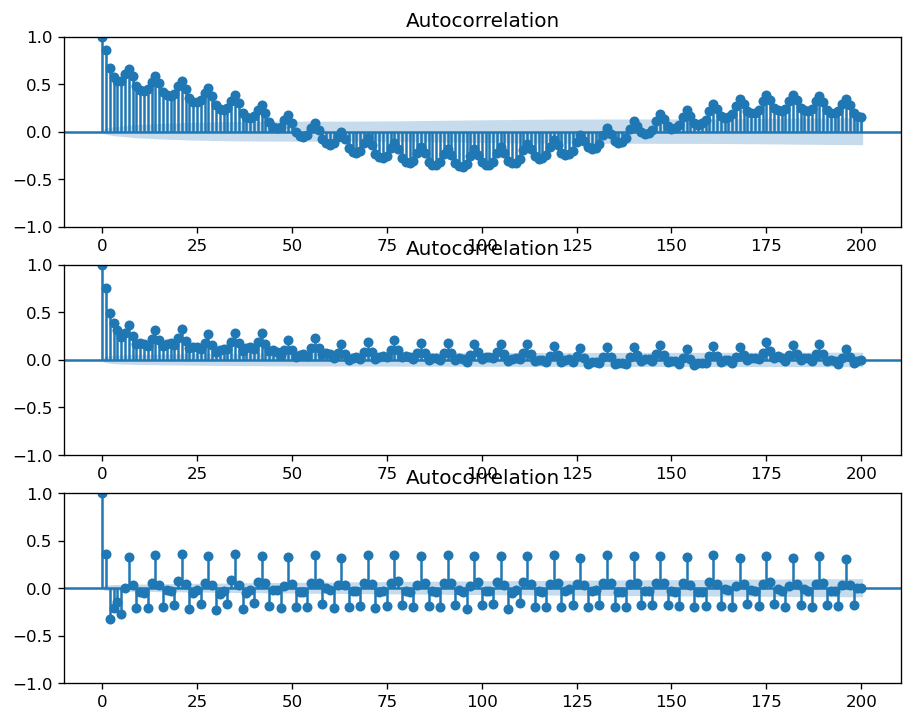

In [99]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=200)
plot_acf(df_daily.PJMW_MW.diff(720).dropna(), ax=ax2,lags=200)
plot_acf(df_daily.PJMW_MW.diff(720).diff(2).dropna(), ax=ax3,lags=200)

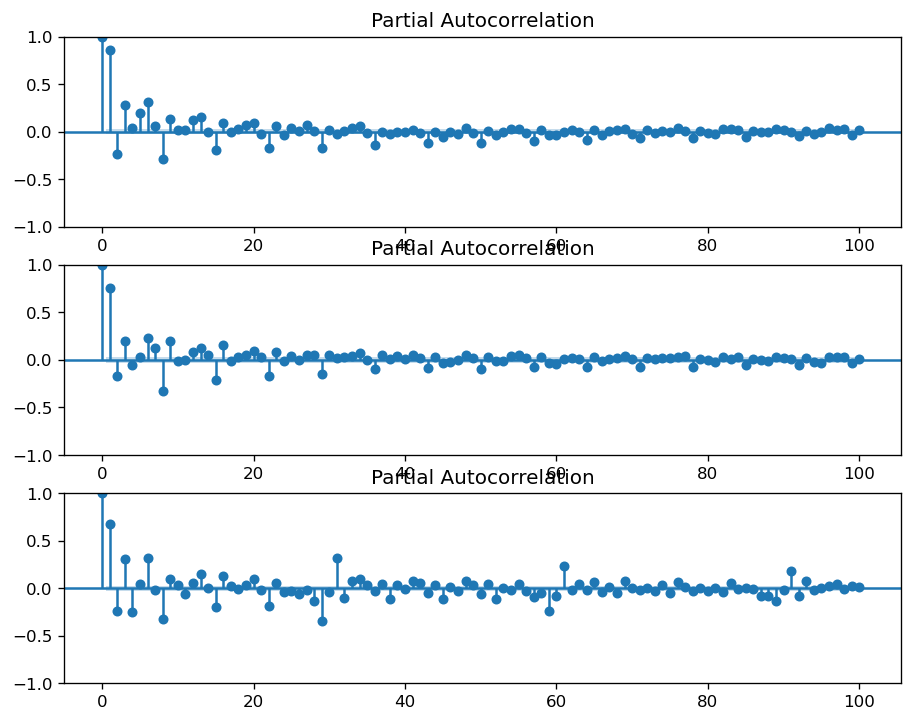

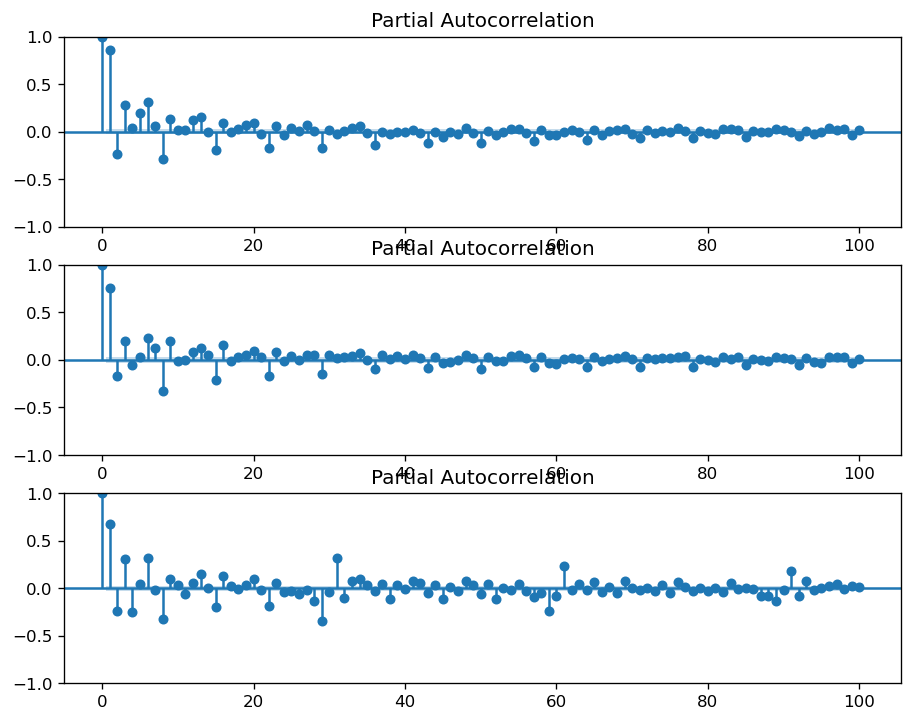

In [100]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(720).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(720).diff(30).dropna(), ax=ax3,lags=100)


Text(0.5, 1.0, '2nd Order Differencing')

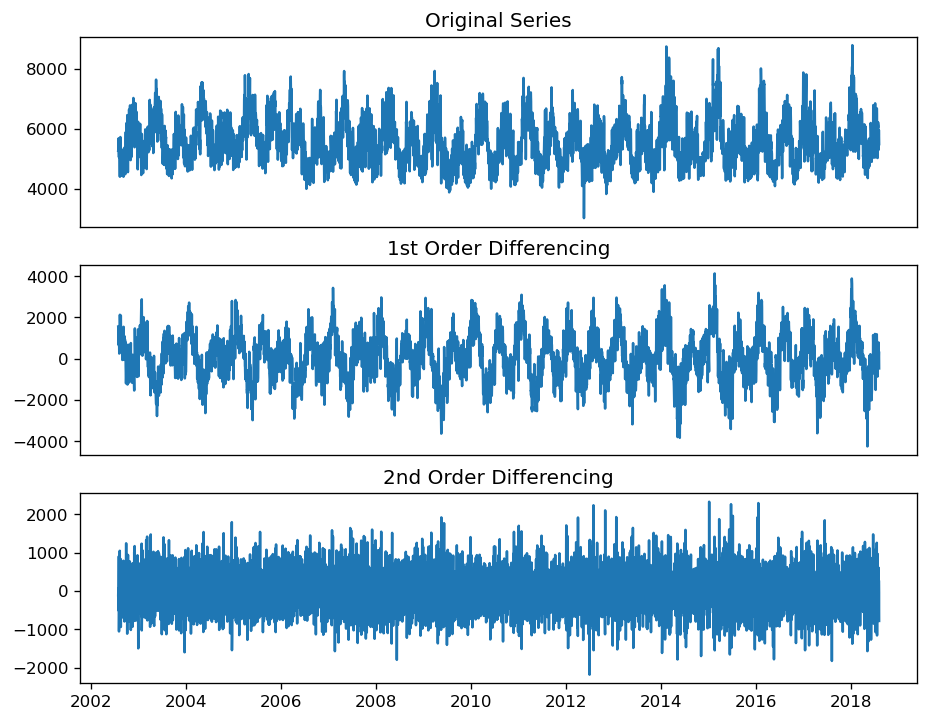

In [101]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(120)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(120).diff()); ax3.set_title('2nd Order Differencing')

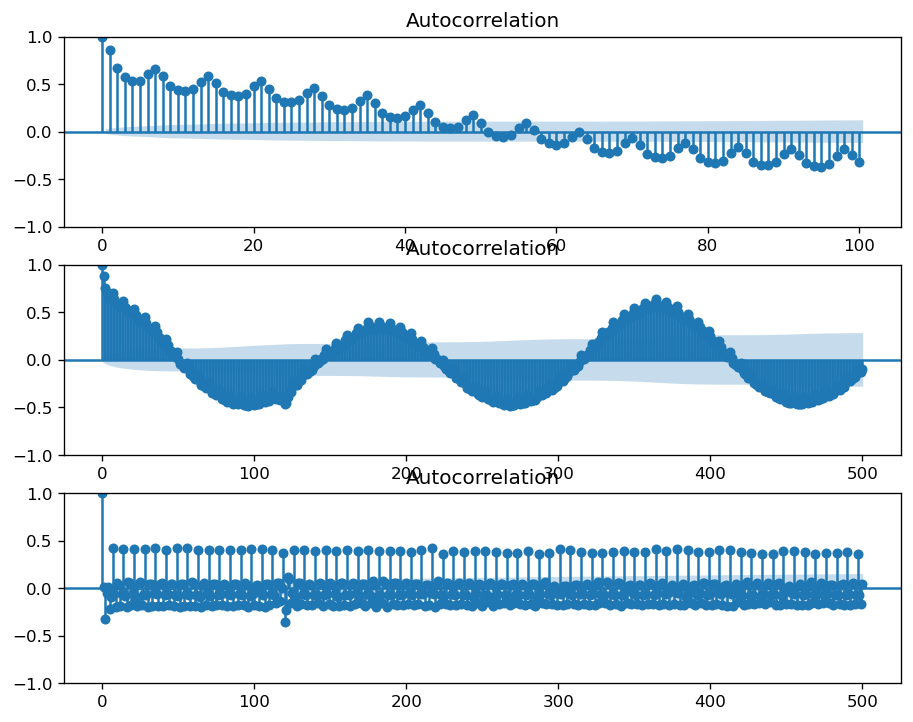

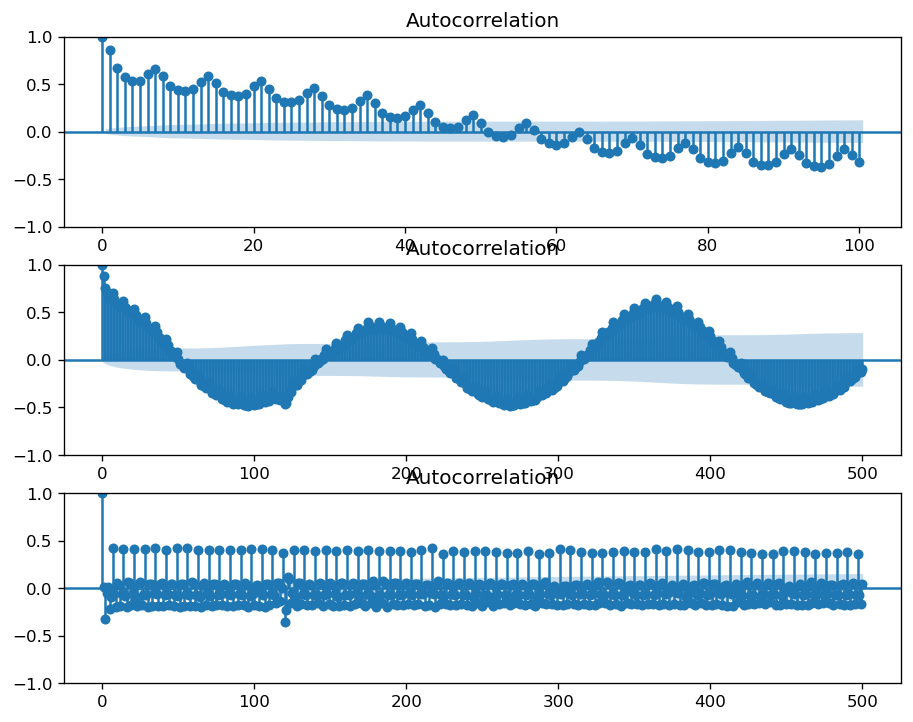

In [102]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_acf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=500)
plot_acf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=500)

Text(0.5, 1.0, '2nd Order Differencing')

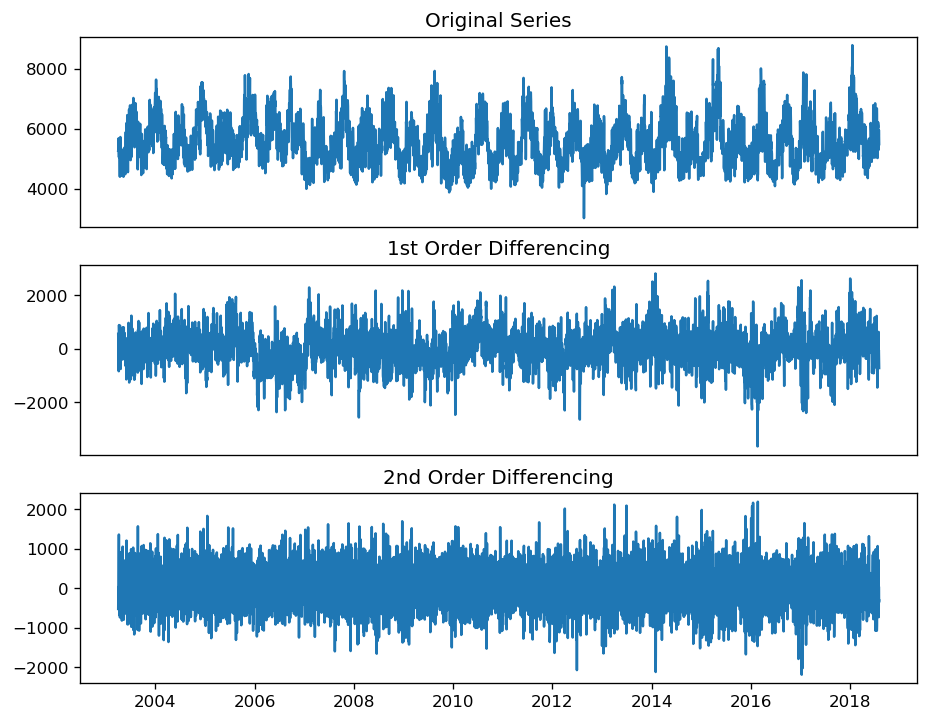

In [103]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(365)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(365).diff()); ax3.set_title('2nd Order Differencing')

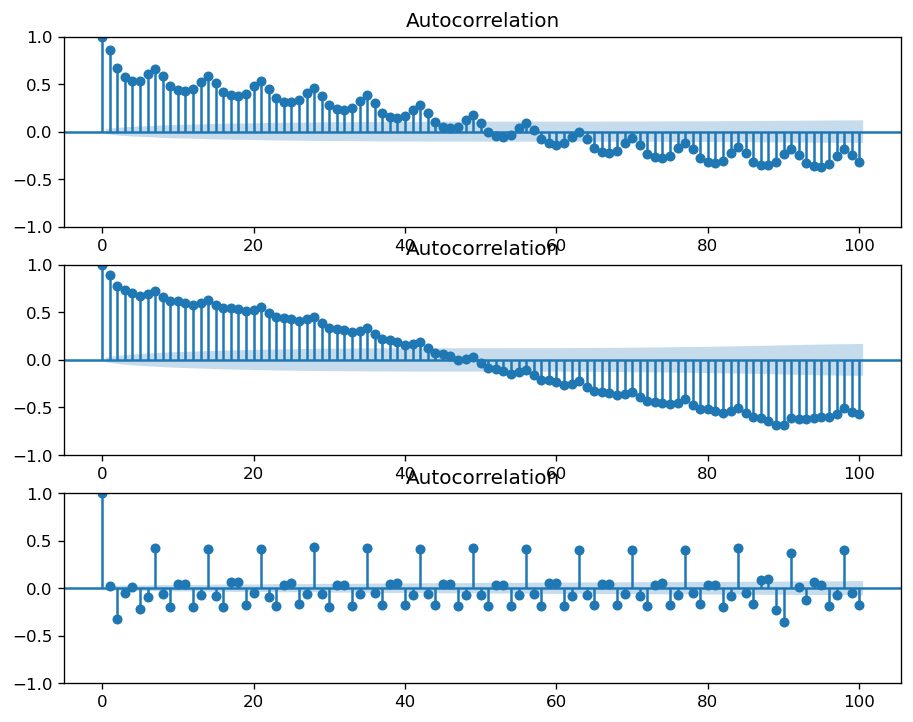

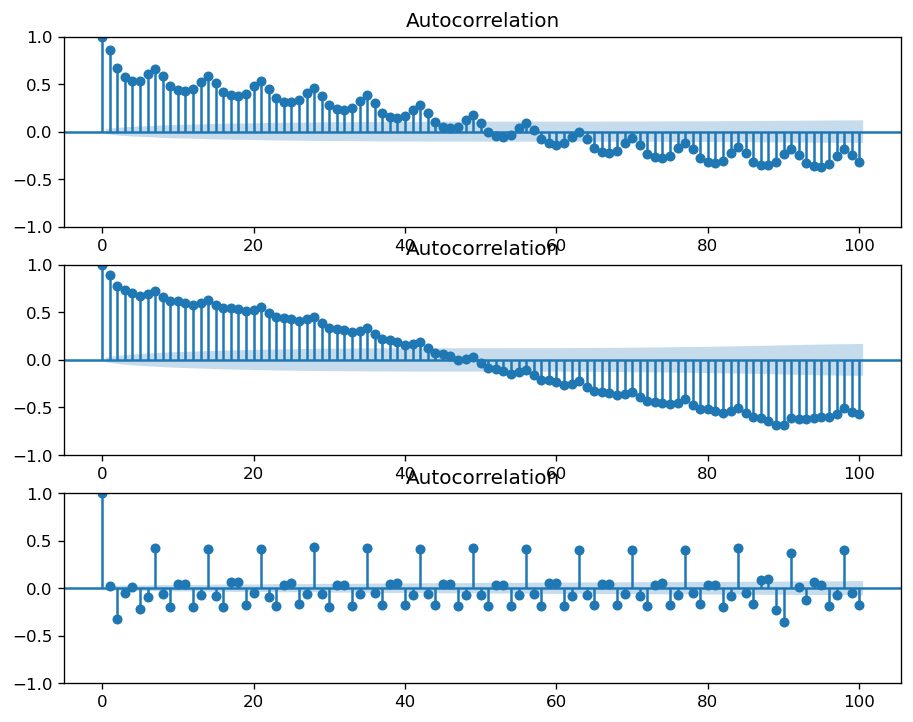

In [104]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_acf(df_daily.PJMW_MW.diff(90).dropna(), ax=ax2,lags=100)
plot_acf(df_daily.PJMW_MW.diff(90).diff().dropna(), ax=ax3,lags=100)

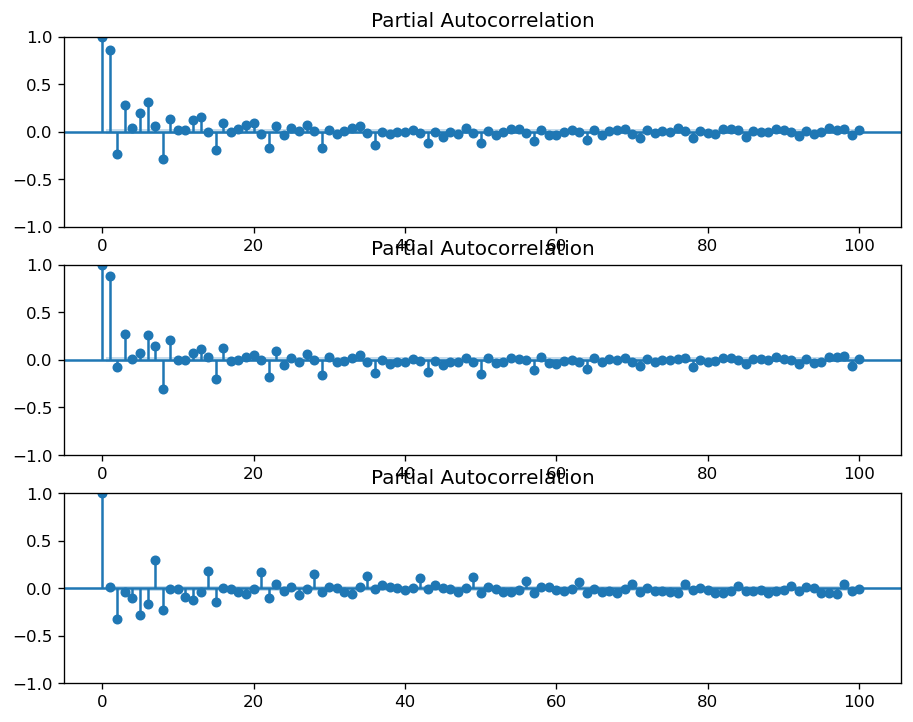

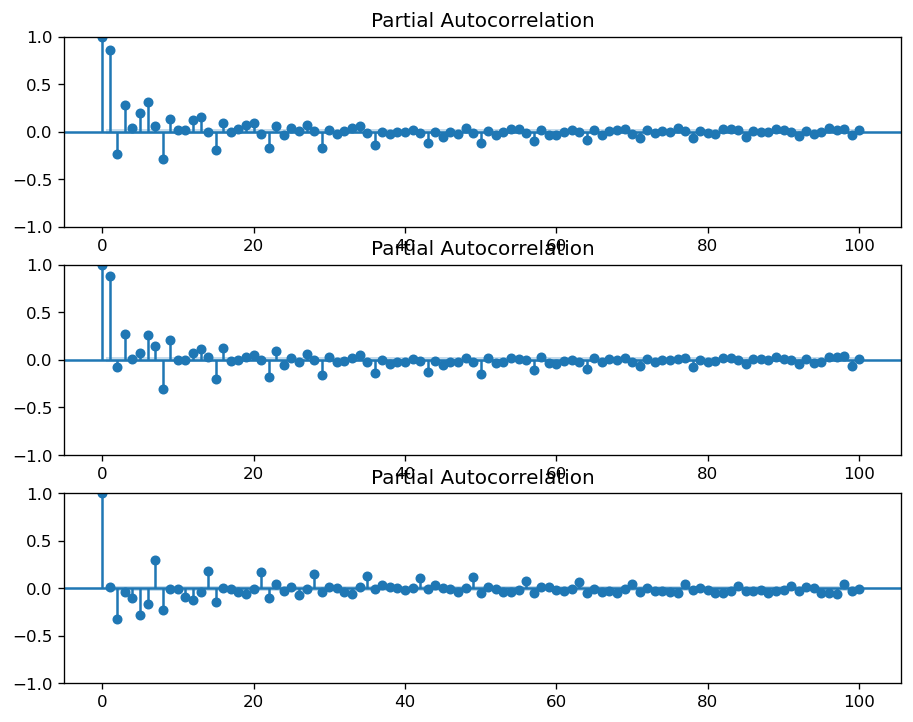

In [105]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=100)

Text(0.5, 1.0, '2nd Order Differencing')

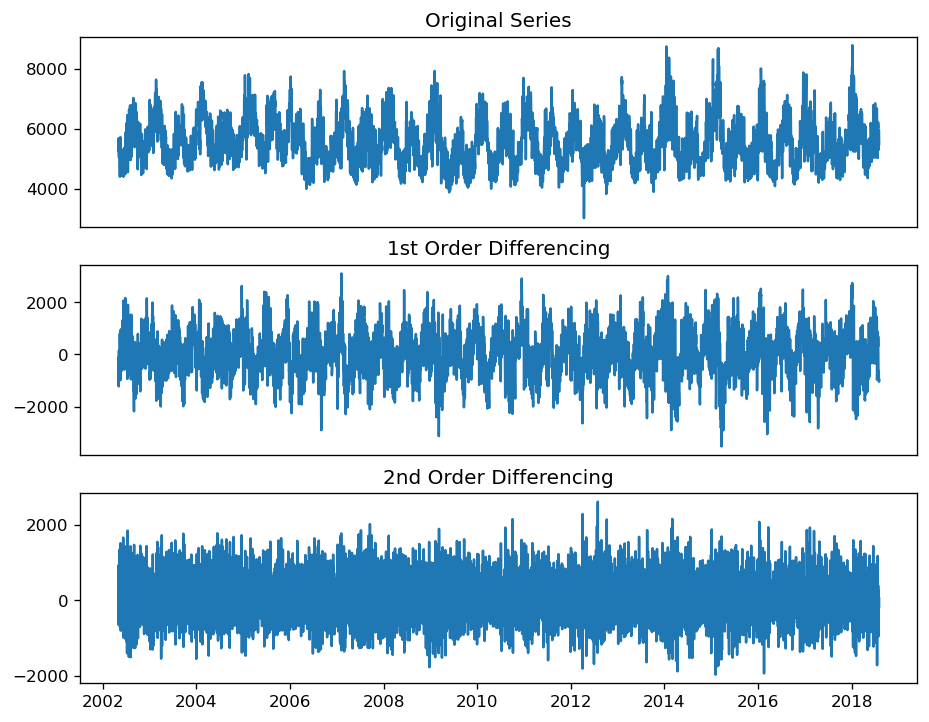

In [106]:
plt.rcParams.update({'figure.figsize':(9,7), 'figure.dpi':120})
 
# Original Series
fig, (ax1, ax2, ax3) = plt.subplots(3)
ax1.plot(df_daily.PJMW_MW); ax1.set_title('Original Series'); ax1.axes.xaxis.set_visible(False)

# 1st Differencing
ax2.plot(df_daily.PJMW_MW.diff(30)); ax2.set_title('1st Order Differencing'); ax2.axes.xaxis.set_visible(False)

# 2nd Differencing
ax3.plot(df_daily.PJMW_MW.diff(30).diff()); ax3.set_title('2nd Order Differencing')

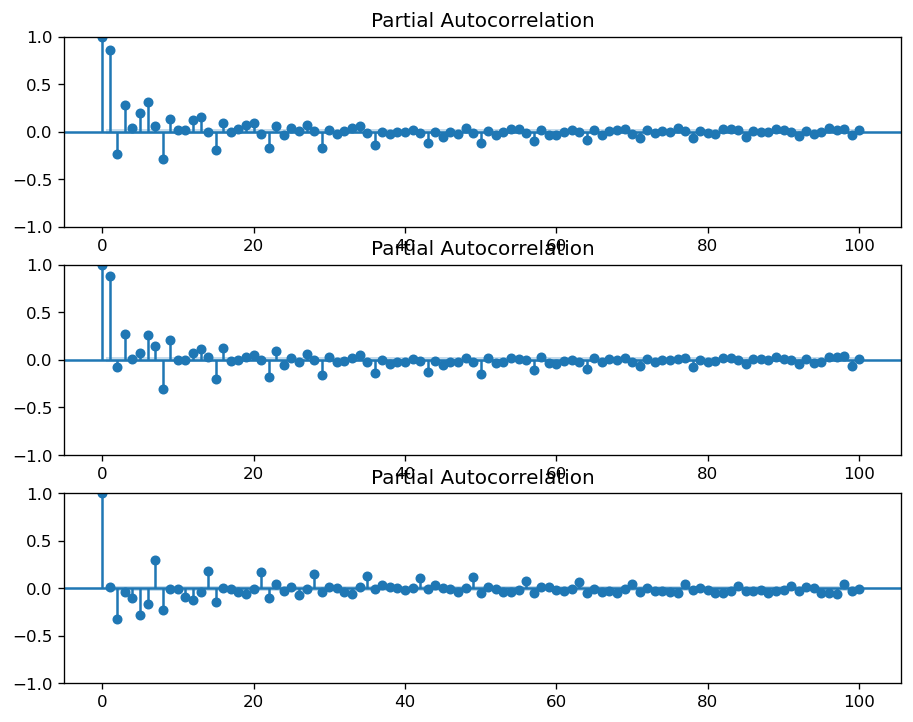

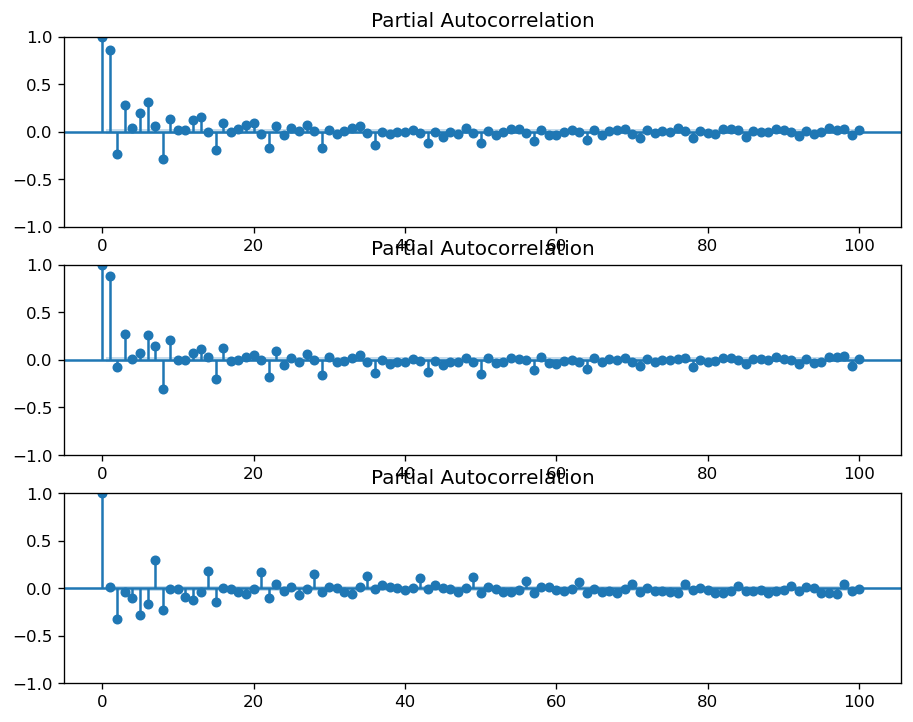

In [107]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).dropna(), ax=ax2,lags=100)
plot_pacf(df_daily.PJMW_MW.diff(120).diff().dropna(), ax=ax3,lags=100)

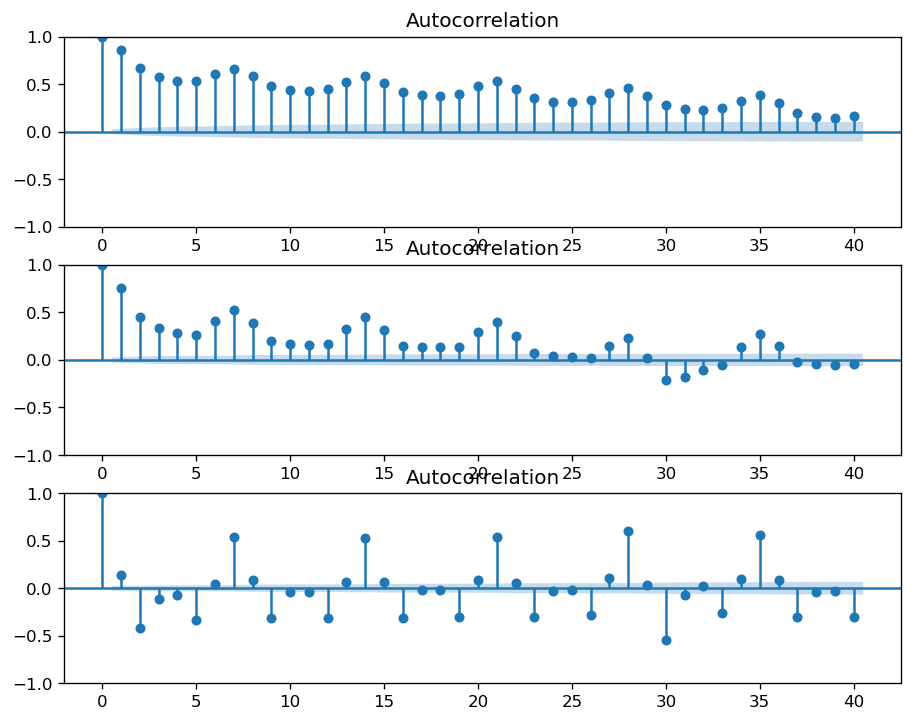

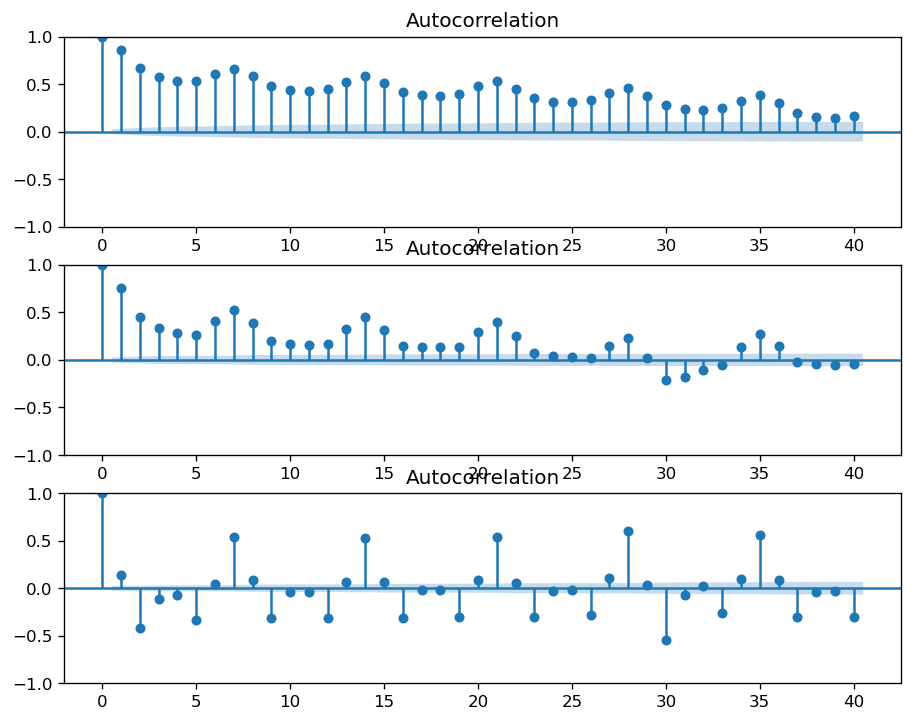

In [108]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).diff().dropna(), ax=ax3,lags=40)

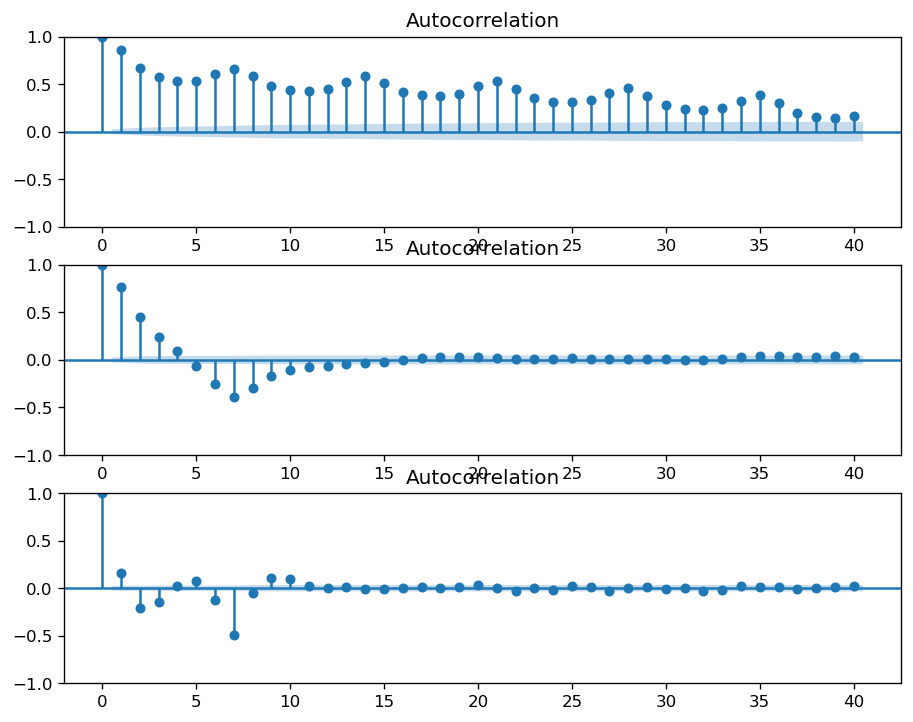

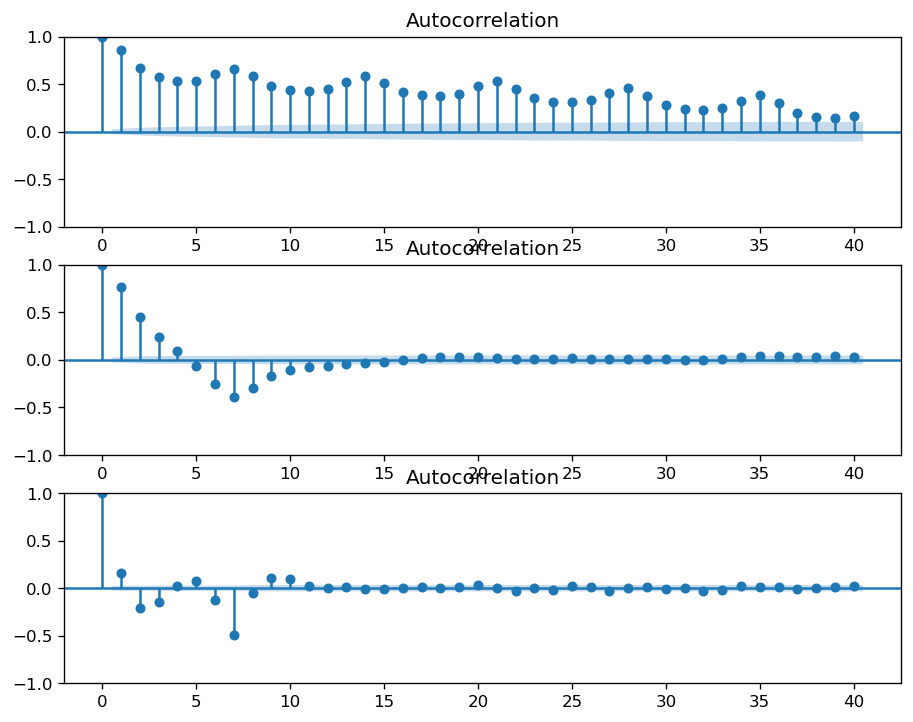

In [109]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).diff().dropna(), ax=ax3,lags=40)

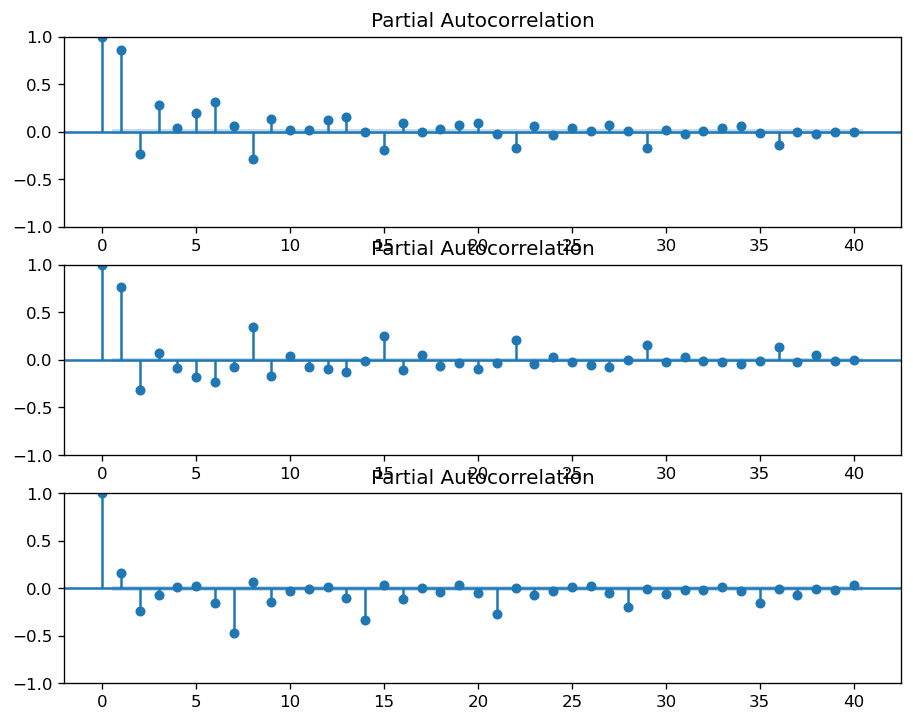

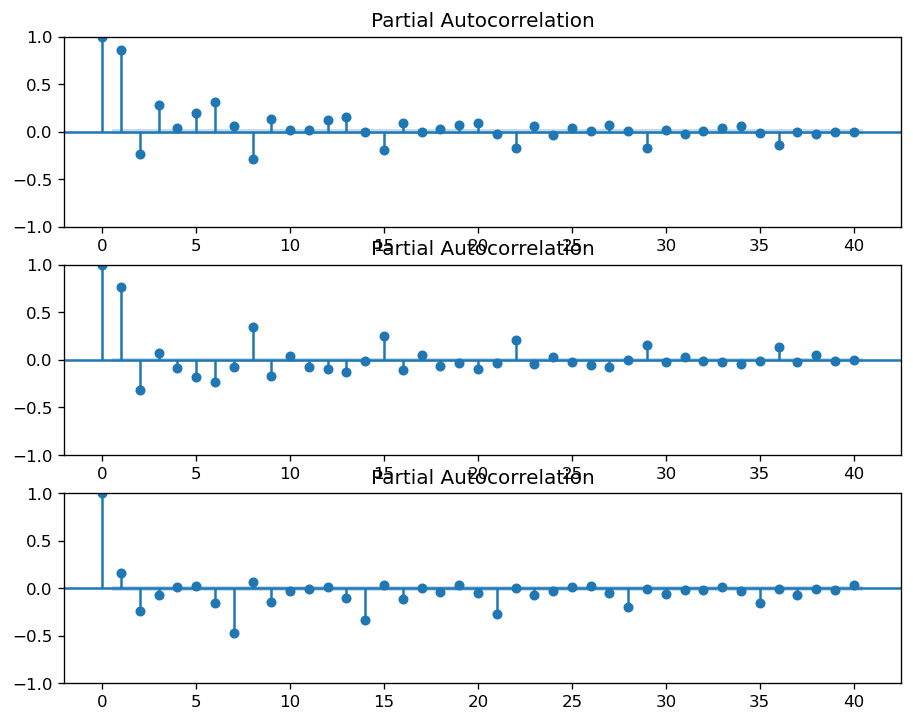

In [110]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(7).diff().dropna(), ax=ax3,lags=40)


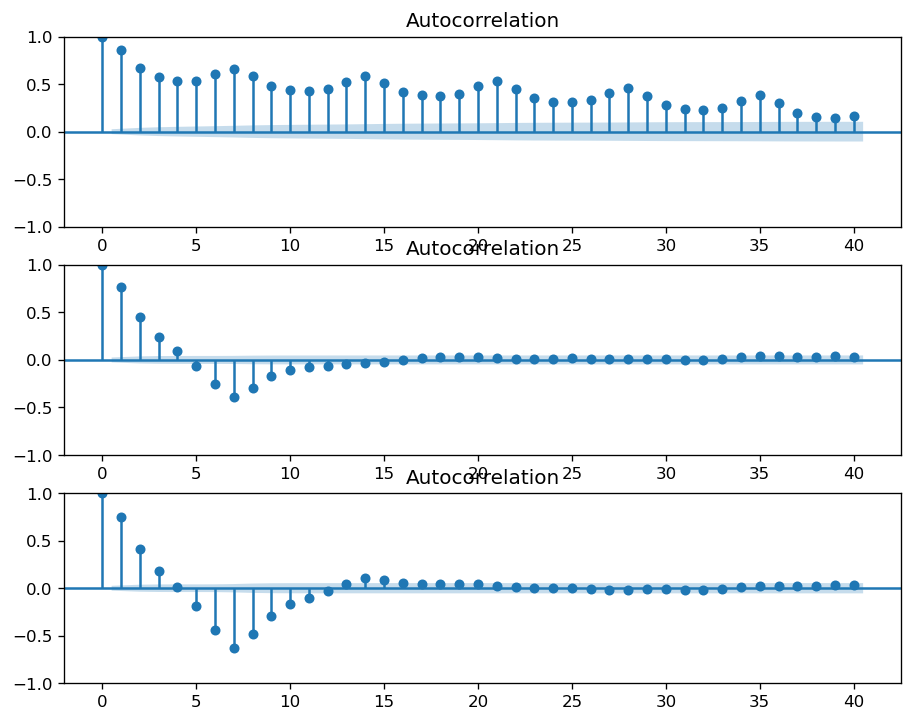

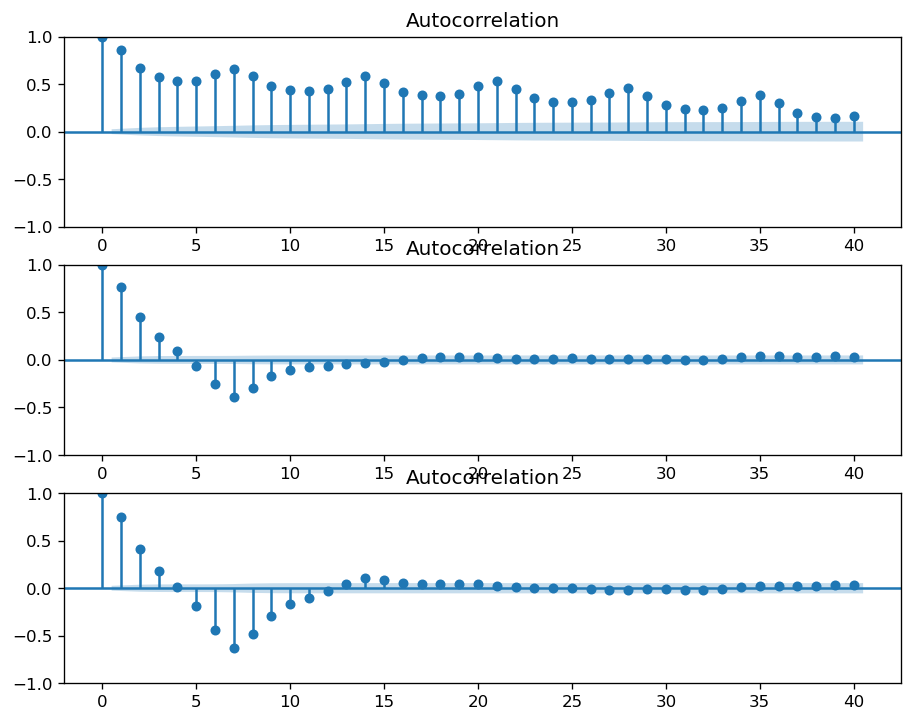

In [111]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(7).diff(7).dropna(), ax=ax3,lags=40)

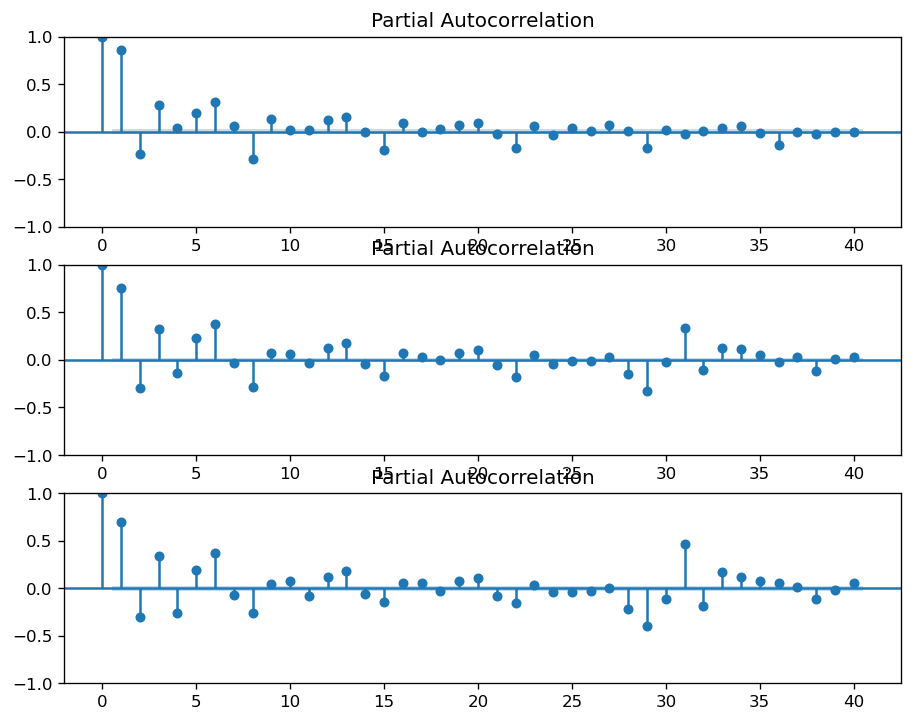

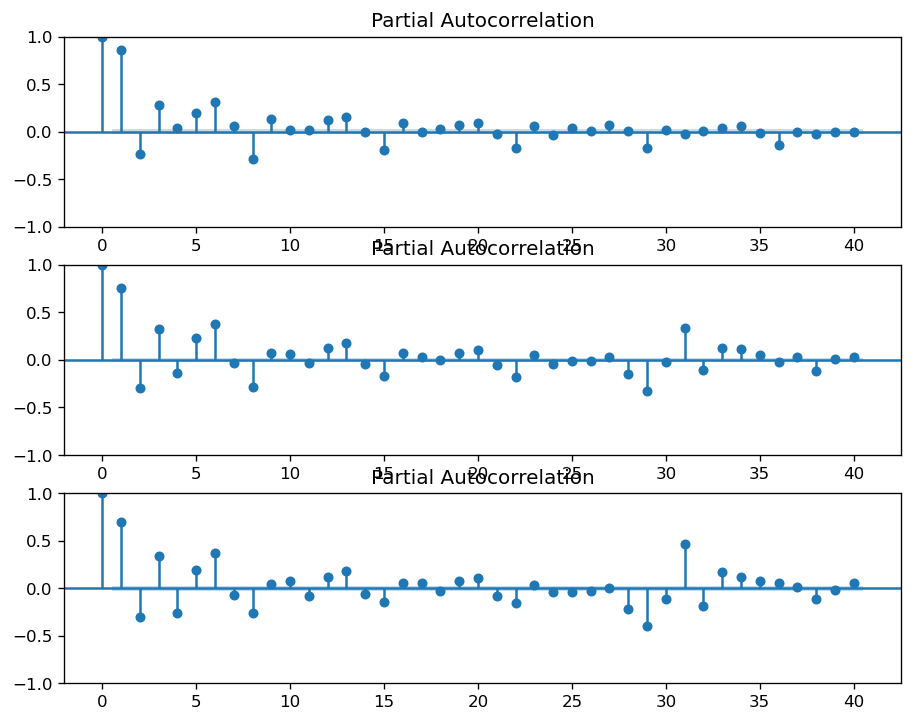

In [112]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_pacf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(30).dropna(), ax=ax2,lags=40)
plot_pacf(df_daily.PJMW_MW.diff(30).diff(30).dropna(), ax=ax3,lags=40)

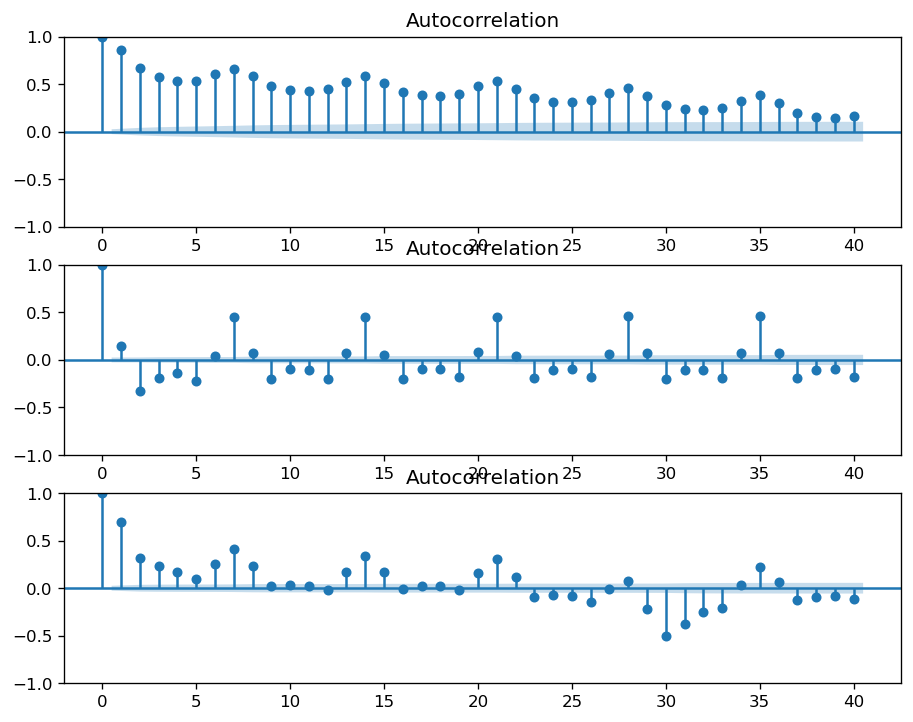

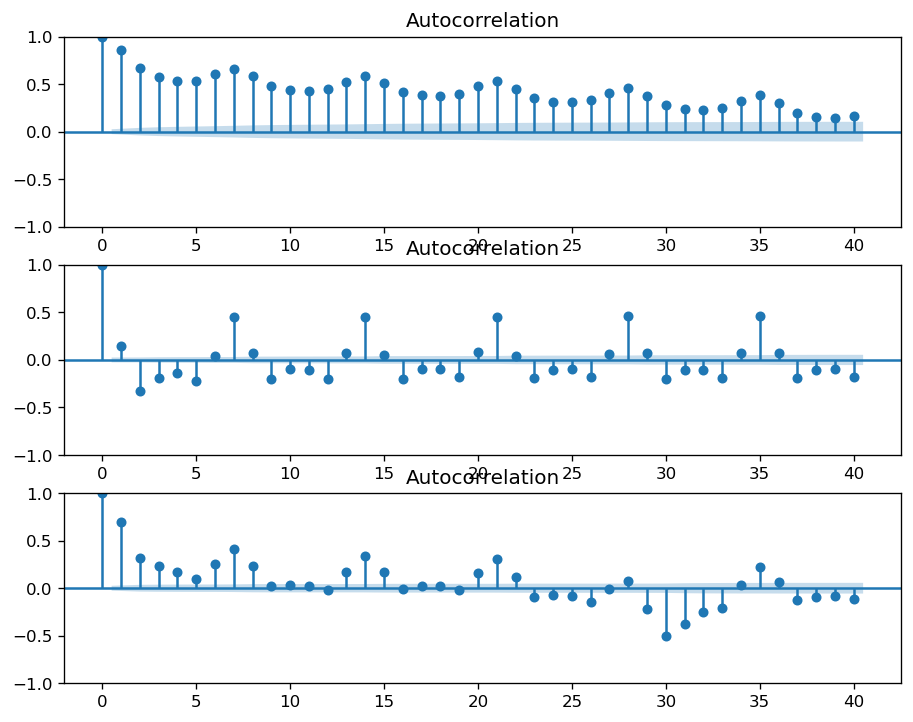

In [113]:
fig, (ax1, ax2, ax3) = plt.subplots(3)
plot_acf(df_daily.PJMW_MW, ax=ax1,lags=40)
plot_acf(df_daily.PJMW_MW.diff().dropna(), ax=ax2,lags=40)
plot_acf(df_daily.PJMW_MW.diff(30).diff(30).dropna(), ax=ax3,lags=40)

In [114]:
df_daily


,PJMW_MW,PJMW_MW_365 Day Shift,PJMW_MW_30 day Shift,PJMW_MW_120 Day Diffrence,PJMW_MW_7 day shift,PJMW_MW_1 day shift
Datetime,,,,,,
2002-04-01,5271.173913,NaN,NaN,NaN,NaN,NaN
2002-04-02,5310.416667,NaN,NaN,NaN,NaN,39.242754
2002-04-03,5325.916667,NaN,NaN,NaN,NaN,15.500000
2002-04-04,5670.791667,NaN,NaN,NaN,NaN,344.875000
2002-04-05,5686.125000,NaN,NaN,NaN,NaN,15.333333
...,...,...,...,...,...,...
2018-07-30,5492.708333,632.833333,-680.625000,783.000000,-407.333333,198.875000
2018-07-31,5660.750000,-97.000000,-660.750000,76.333333,-481.916667,168.041667
2018-08-01,5959.708333,-55.958333,-856.750000,348.583333,-76.500000,298.958333


In [115]:
df_daily['1--7 day diff'] = df_daily['PJMW_MW_7 day shift']-df_daily['PJMW_MW_7 day shift'].shift()


<AxesSubplot:xlabel='Datetime'>

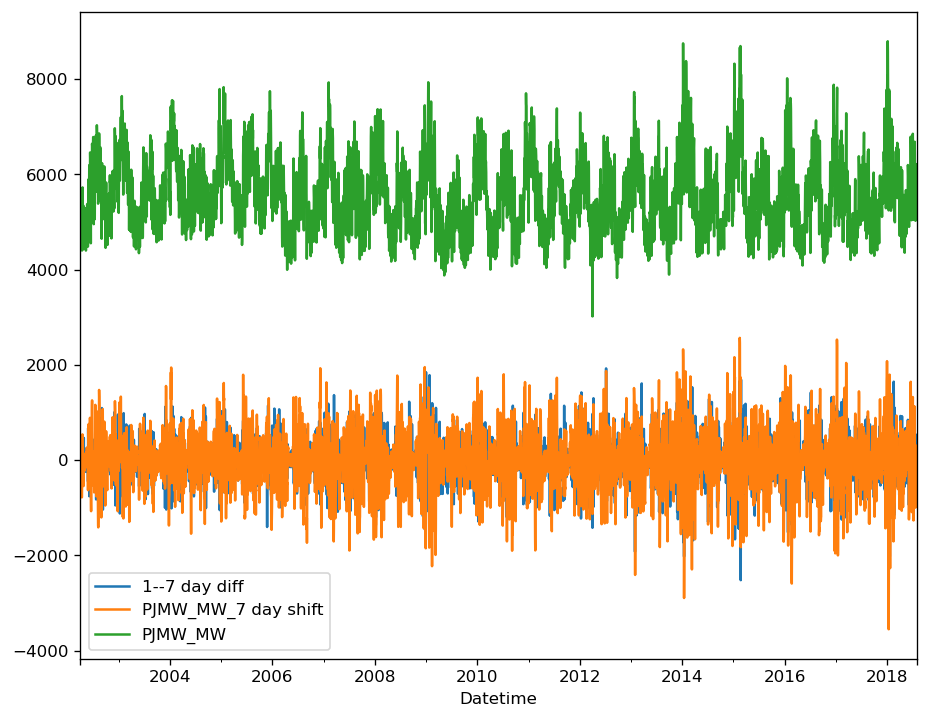

In [116]:
df_daily[['1--7 day diff','PJMW_MW_7 day shift','PJMW_MW']].plot()


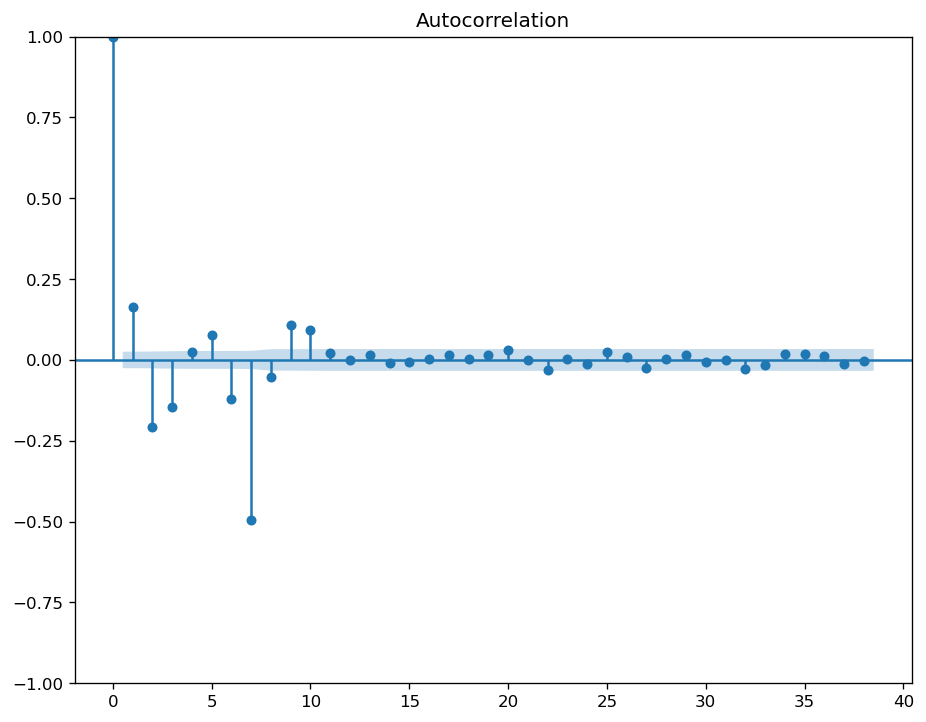

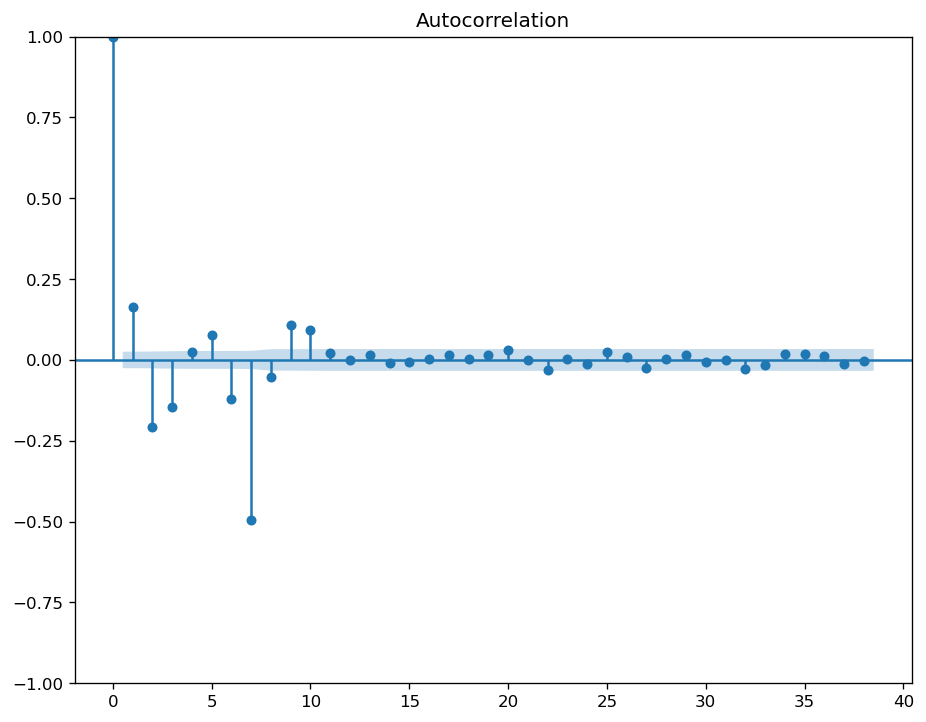

In [117]:
plot_acf(df_daily['1--7 day diff'].dropna())


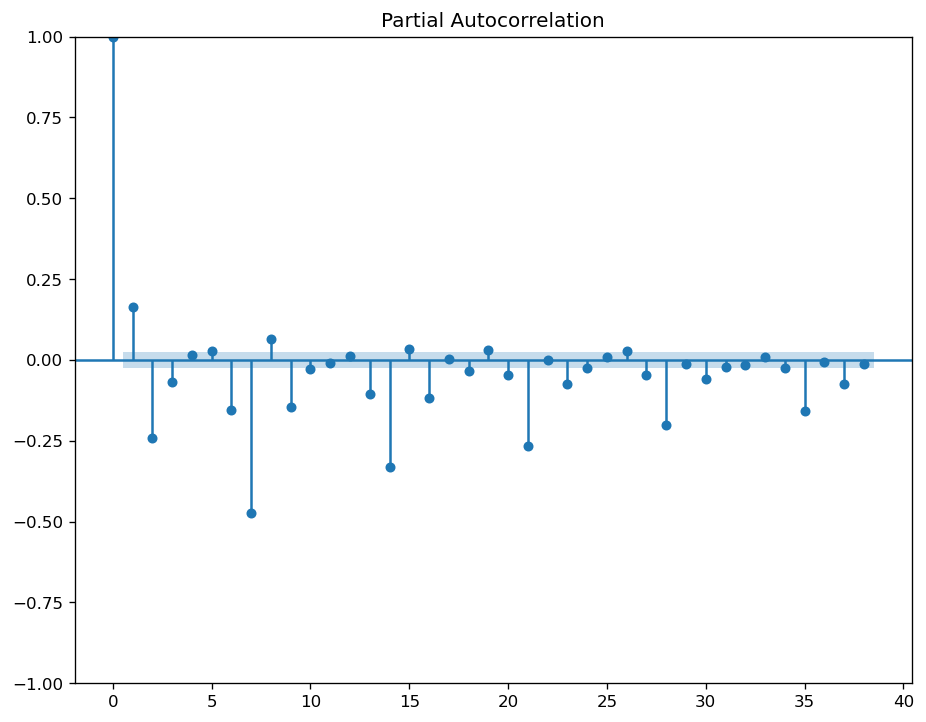

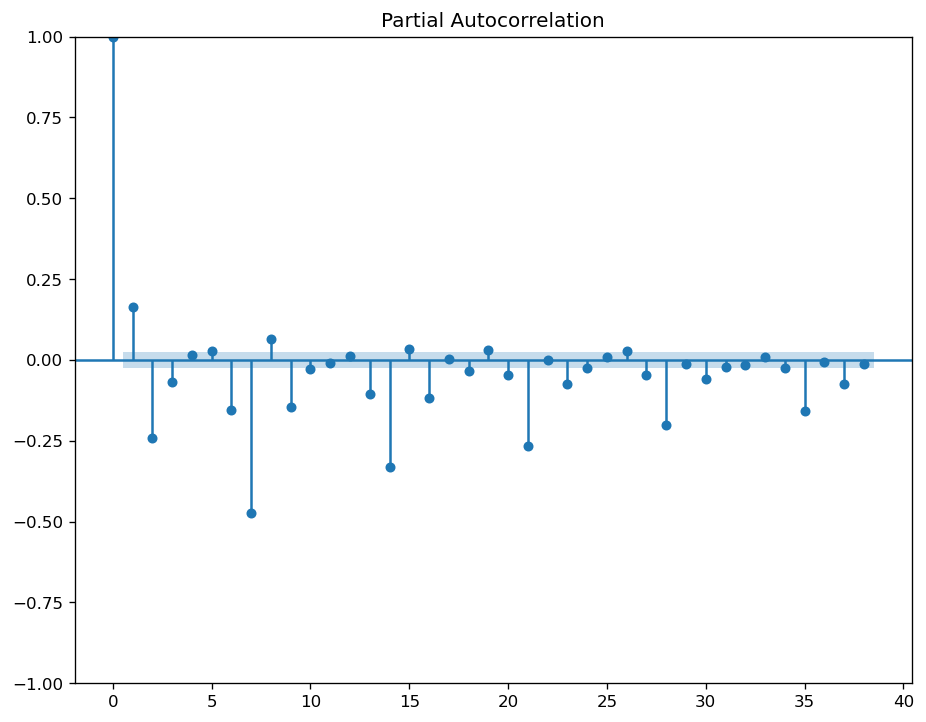

In [118]:
plot_pacf(df_daily['1--7 day diff'].dropna())


In [119]:
adf_test(df_daily['PJMW_MW_1 day shift'].dropna())


ADF Statistics: -14.39691544953562
p-values: 8.636781700455097e-27
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [120]:
adf_test(df_daily['PJMW_MW_7 day shift'].dropna())


ADF Statistics: -13.97513857971994
p-values: 4.2752184342048377e-26
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [121]:
adf_test(df_daily['PJMW_MW_30 day Shift'].dropna())


ADF Statistics: -9.193693067246592
p-values: 2.0901318753862775e-15
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [122]:
adf_test(df_daily['PJMW_MW_120 Day Diffrence'].dropna())


ADF Statistics: -7.60700285481104
p-values: 2.308043782843623e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [123]:
adf_test(df_daily['PJMW_MW_365 Day Shift'].dropna())


ADF Statistics: -7.944404396491014
p-values: 3.248966872307294e-12
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


Text(0.5, 1.0, 'Log Transformation')

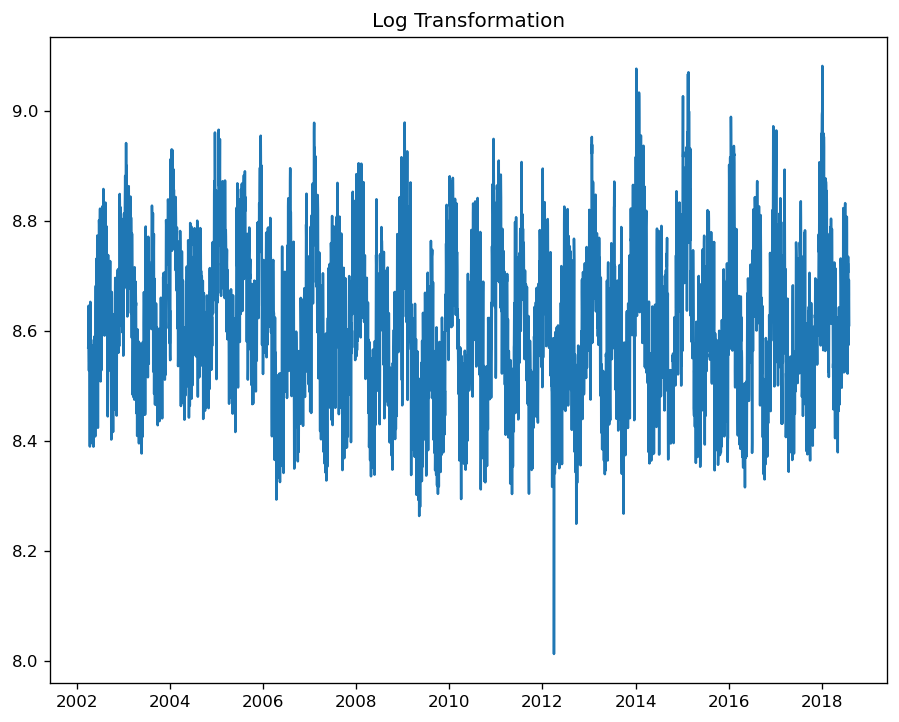

In [124]:
df_log = np.log(df_daily['PJMW_MW'])
plt.plot(df_log)
plt.title('Log Transformation')

In [125]:
adf_test(df_log)

ADF Statistics: -7.355378979339348
p-values: 9.811798786501218e-11
Strong evidence against the null hypothesis,reject the null hypothesis, Data is stationary


In [126]:
movingavg = df_log.rolling(window=30,min_periods=1).mean()
df_log_diff_movingavg = df_log-movingavg-movingavg
df_log_diff_movingavg.head()

Datetime
2002-04-01   -8.570008
2002-04-02   -8.570008
2002-04-03   -8.571509
2002-04-04   -8.542345
2002-04-05   -8.560873
Freq: D, Name: PJMW_MW, dtype: float64

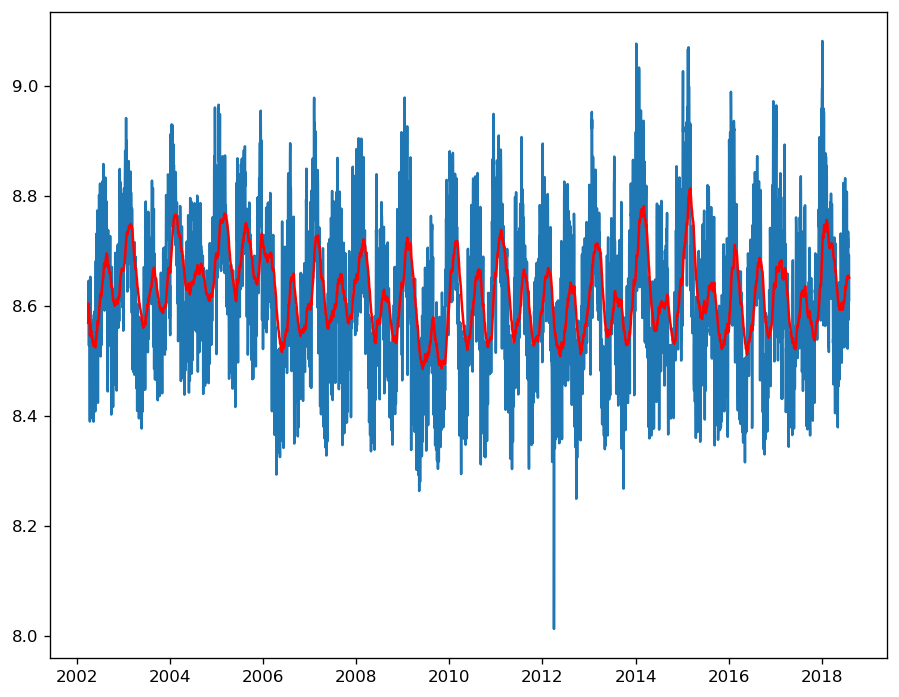

In [127]:
exponentialdecay_movingavg = df_log.ewm(halflife=30,min_periods=0,adjust=True).mean()
plt.plot(df_log.dropna())
plt.plot(exponentialdecay_movingavg.dropna(),color='r')

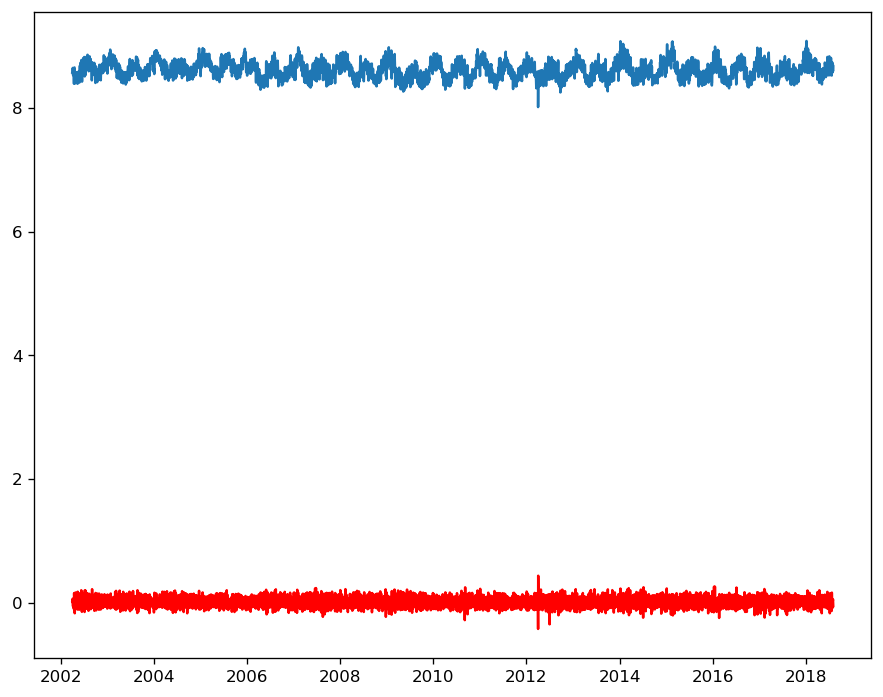

In [128]:
log_2shift = df_log-df_log.shift()
log_2shift.head()
plt.plot(df_log.dropna())
plt.plot(log_2shift.dropna(),color='r')

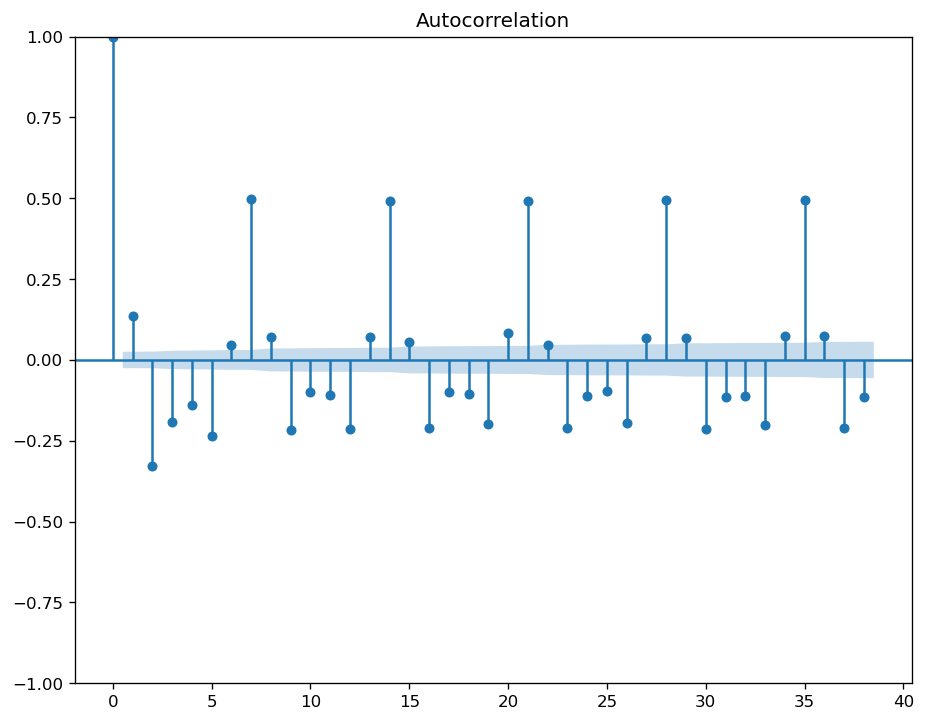

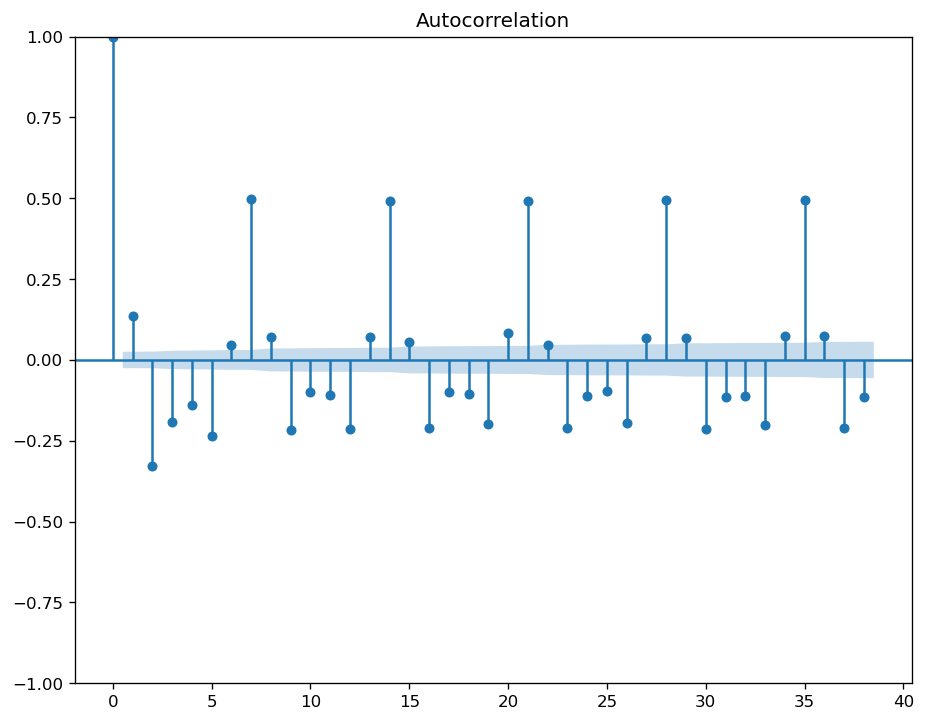

In [129]:
plot_acf(log_2shift.dropna())


In [130]:
from statsmodels.tsa.stattools import arma_order_select_ic


In [131]:
arma_order_select_ic(df_daily['PJMW_MW_365 Day Shift'].dropna())


{'bic':               0             1             2
 0  89426.923983  86067.202075  85505.747549
 1  85632.241766  85342.607918  85283.348491
 2  85459.422336  85298.820150  85201.906559
 3  85284.028424  85283.256208  84473.885417
 4  85280.307387  85296.446015  84186.421183,
 'bic_min_order': (4, 2)}

In [132]:
from statsmodels.tsa.arima.model import ARIMA


In [133]:
train = df_daily["PJMW_MW"][:5110]
test = df_daily["PJMW_MW"][5110:]
start = len(train)
end = len(train)+len(test)-1

In [134]:
# p,d,q ARIMA Model
model = ARIMA(train, order=(4,1,3))
model_fit = model.fit()
print(model_fit.summary())

                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 1, 3)   Log Likelihood              -36660.939
Date:                Wed, 05 Apr 2023   AIC                          73337.877
Time:                        12:53:22   BIC                          73390.188
Sample:                    04-01-2002   HQIC                         73356.191
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.5182      0.014     36.542      0.000       0.490       0.546
ar.L2         -1.0825      0.011    -97.483      0.000      -1.104      -1.061
ar.L3          0.7303      0.013     55.440      0.0

In [135]:
pred_arima=model_fit.predict(start =start,end=end)

In [136]:
forcast=model_fit.forecast(steps=890)

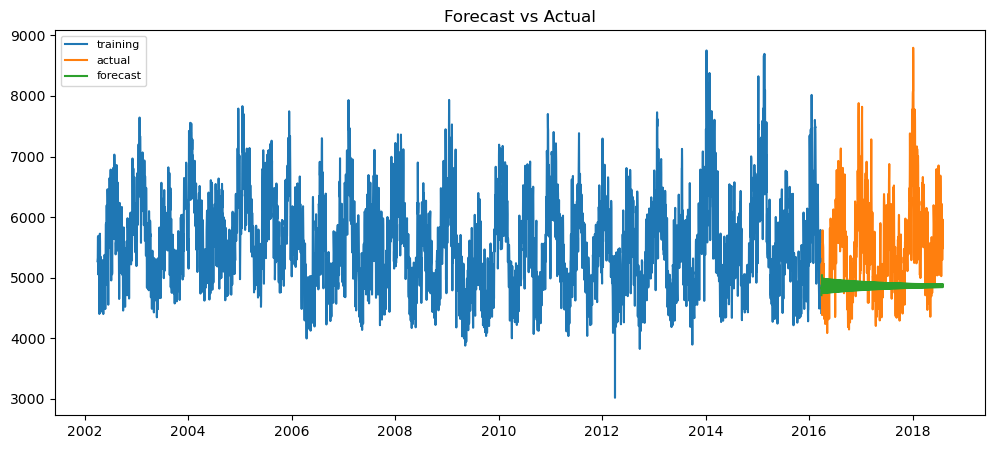

In [137]:
plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)

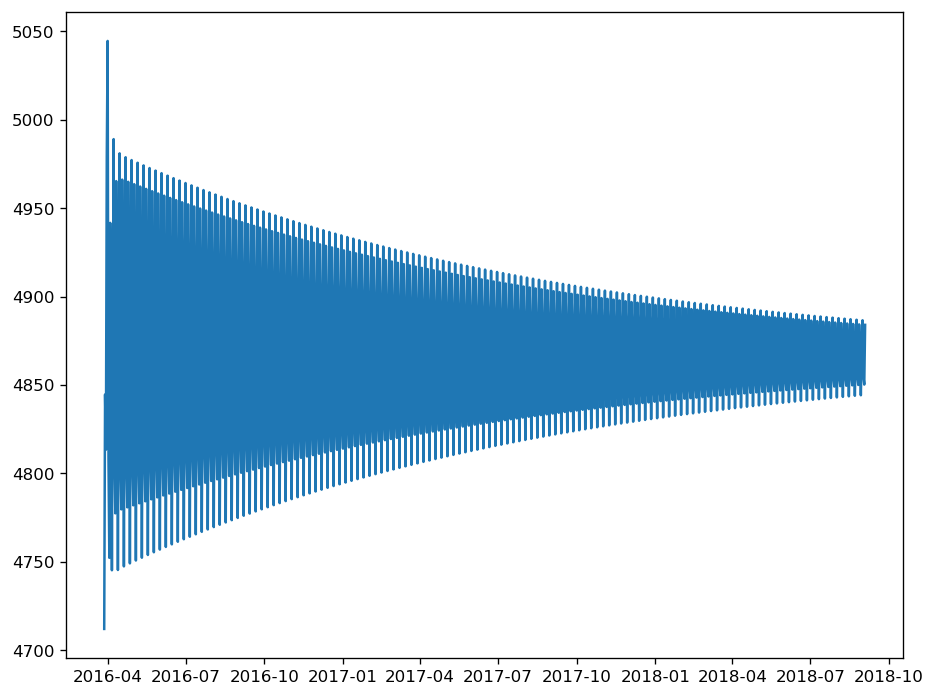

In [138]:
plt.plot(forcast,label='future')
plt.show()

In [139]:
# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error

In [140]:
arima_rmse_error = mean_absolute_error(test, pred_arima)
arima_mse_error = arima_rmse_error**2
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),4)

In [141]:
print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')


MSE Error: 612471.0074419824
RMSE Error: 782.6052692398528
MAPE: 12.9376


                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 0, 3)   Log Likelihood              -36936.299
Date:                Wed, 05 Apr 2023   AIC                          73890.598
Time:                        12:53:30   BIC                          73949.448
Sample:                    04-01-2002   HQIC                         73911.201
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8761     52.180    107.472      0.000    5505.606    5710.146
ar.L1          1.4976      0.031     47.793      0.000       1.436       1.559
ar.L2         -0.7448      0.068    -10.975      0.0

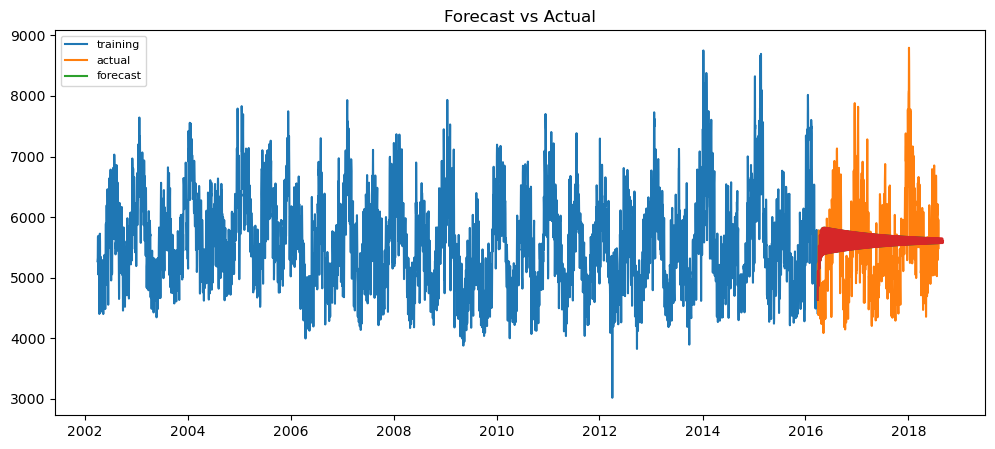

MSE Error: 337508.3511900055
RMSE Error: 580.9546894466087
MAPE: 10.493


In [142]:
# p,d,q ARIMA Model
model = ARIMA(train, order=(4,0,3),trend='c')
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error
arima_rmse_error = mean_absolute_error(test, pred_arima)
arima_mse_error = arima_rmse_error**2
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(4, 0, 4)   Log Likelihood              -36826.270
Date:                Wed, 05 Apr 2023   AIC                          73672.539
Time:                        12:53:40   BIC                          73737.929
Sample:                    04-01-2002   HQIC                         73695.432
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8759   7.25e-08   7.74e+10      0.000    5607.876    5607.876
ar.L1          2.5518      0.033     77.797      0.000       2.487       2.616
ar.L2         -2.9313      0.074    -39.760      0.0

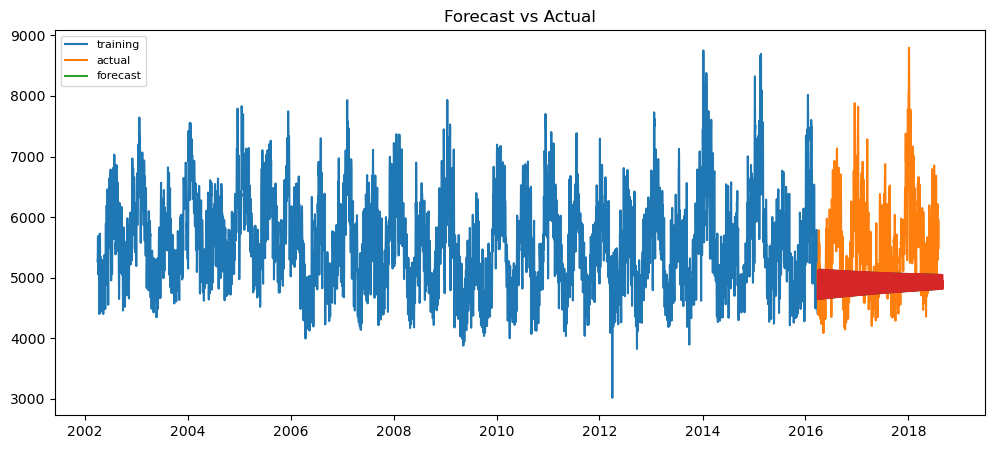

MSE Error: 546320.2526
RMSE Error: 739.1348
MAPE: 12.185


In [143]:
# p=4,d=0,q=4 ARIMA Model
model = ARIMA(train, order=(4,0,4))
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error



arima_rmse_error = round(mean_absolute_error(test, pred_arima),4)
arima_mse_error =(arima_rmse_error**2).round(4)
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

                               SARIMAX Results                                
Dep. Variable:                PJMW_MW   No. Observations:                 5110
Model:                 ARIMA(6, 0, 5)   Log Likelihood              -36438.559
Date:                Wed, 05 Apr 2023   AIC                          72903.118
Time:                        12:53:53   BIC                          72988.125
Sample:                    04-01-2002   HQIC                         72932.879
                         - 03-27-2016                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
const       5607.8762    169.793     33.028      0.000    5275.088    5940.664
ar.L1          0.7984      0.033     24.255      0.000       0.734       0.863
ar.L2         -0.5003      0.056     -8.868      0.0

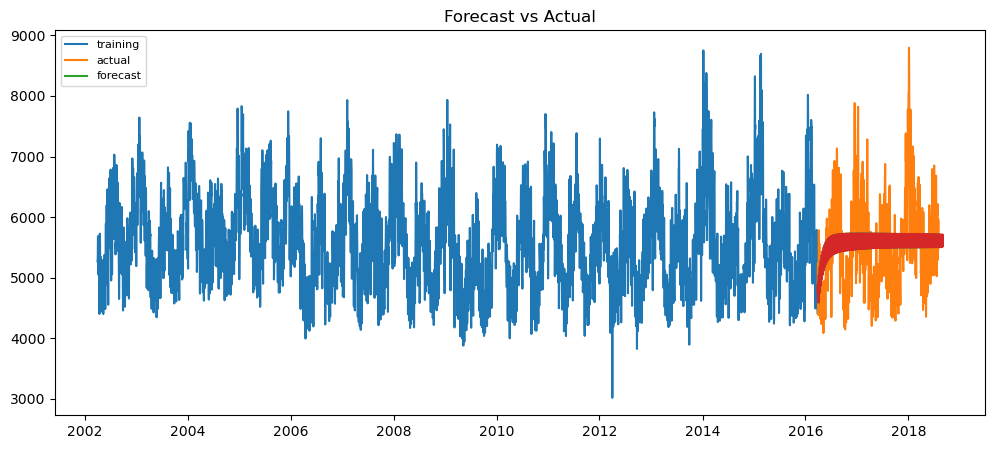

MSE Error: 325214.374
RMSE Error: 570.2757
MAPE: 10.247


In [144]:
# p=5,d=0,q=4 ARIMA Model
model = ARIMA(train, order=(6,0,5))
model_fit = model.fit()
print(model_fit.summary())
pred_arima=model_fit.predict(start =start,end=end)


forcast=model_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_arima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()



# Calculate RMSE ,MSE and MAPE Error
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.metrics import mean_absolute_percentage_error



arima_rmse_error = round(mean_absolute_error(test, pred_arima),4)
arima_mse_error =(arima_rmse_error**2).round(4)
arima_mape=round((mean_absolute_percentage_error(test,pred_arima)*100),3)



print(f'MSE Error: {arima_mse_error}\nRMSE Error: {arima_rmse_error}\nMAPE: {arima_mape}')

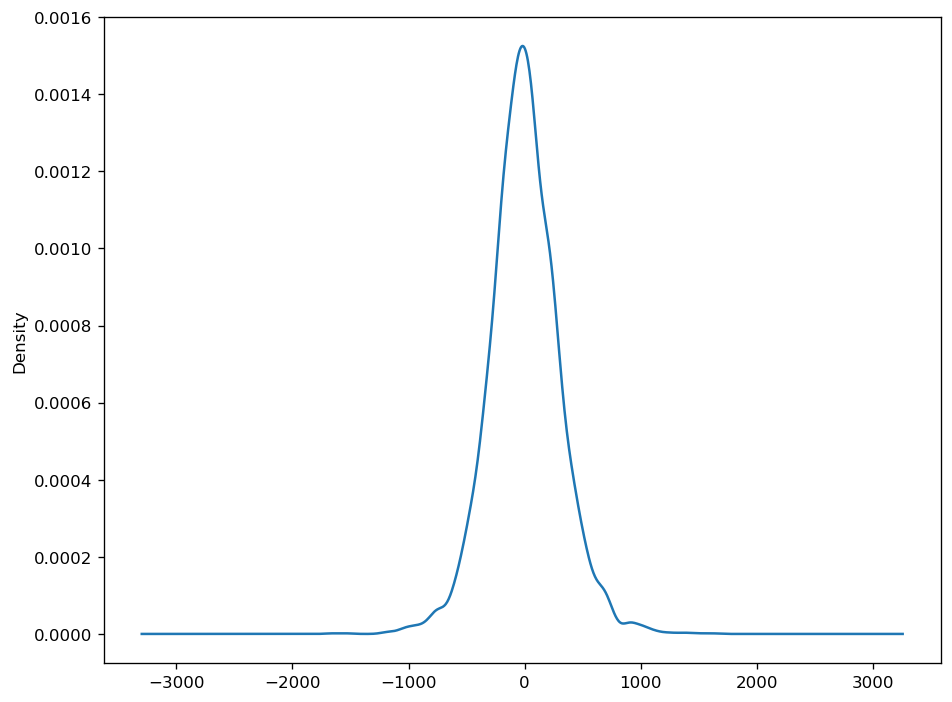

In [145]:
model_fit.resid.plot(kind='kde')
plt.show()

In [146]:
from statsmodels.tsa.statespace.sarimax import SARIMAX

In [147]:
model_serimax = SARIMAX(train, order=(6,0,5), seasonal_order=(1,0,1,12))

In [148]:
sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(6, 0, 5)x(1, 0, [1], 12)   Log Likelihood              -36532.158
Date:                              Wed, 05 Apr 2023   AIC                          73092.316
Time:                                      12:54:43   BIC                          73183.862
Sample:                                  04-01-2002   HQIC                         73124.366
                                       - 03-27-2016                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.8048      0.003    309.261      0.000       0.800       0.810
ar.L2         -0.45

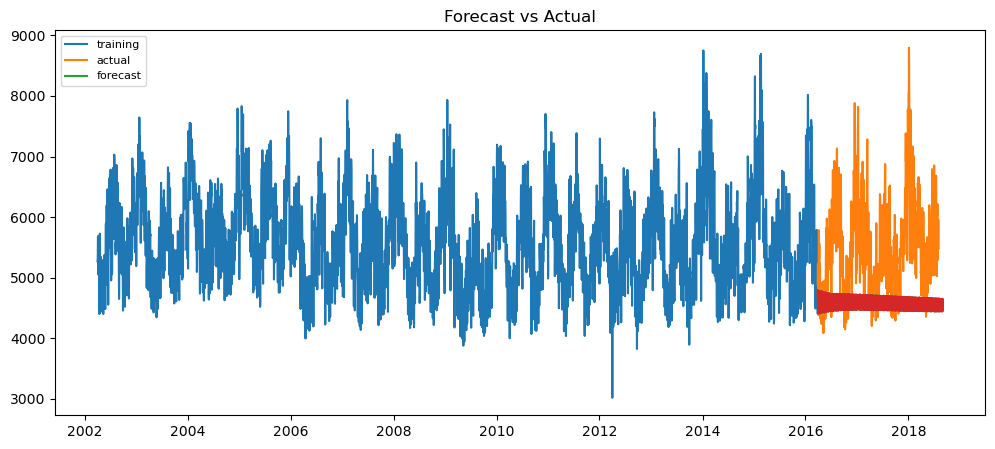

MSE Error: 1001760.5742
RMSE Error: 1000.8799
MAPE: 16.684


In [149]:
pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 0, 4)x(1, 0, [1], 7)   Log Likelihood              -35953.786
Date:                             Wed, 05 Apr 2023   AIC                          71927.572
Time:                                     12:54:53   BIC                          71992.962
Sample:                                 04-01-2002   HQIC                         71950.465
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.8238      0.012    244.621      0.000       2.801       2.846
ar.L2         -2.6566      

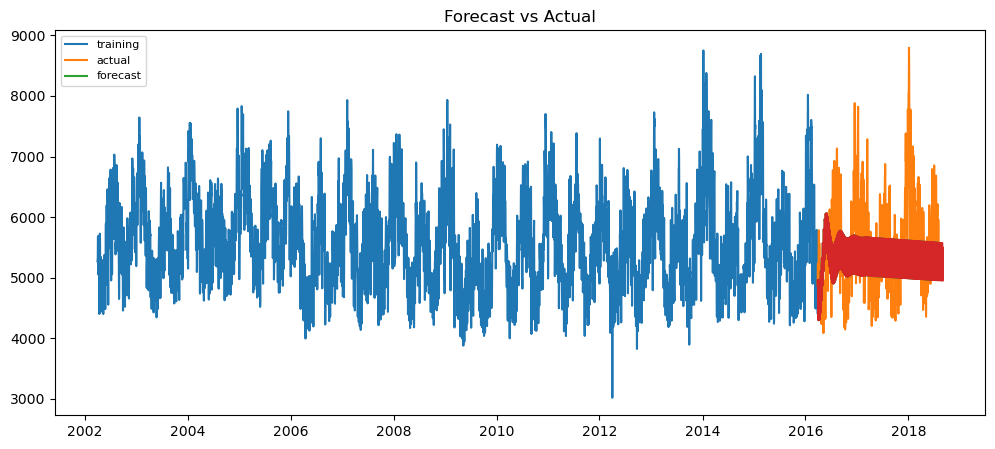

MSE Error: 333085.1545
RMSE Error: 577.1353
MAPE: 10.057


In [150]:
model_serimax = SARIMAX(train, order=(3,0,4), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(4, 0, 3)x(1, 0, [1], 7)   Log Likelihood              -35885.275
Date:                             Wed, 05 Apr 2023   AIC                          71790.550
Time:                                     12:55:02   BIC                          71855.940
Sample:                                 04-01-2002   HQIC                         71813.443
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.6439      0.039     68.382      0.000       2.568       2.720
ar.L2         -2.3108      

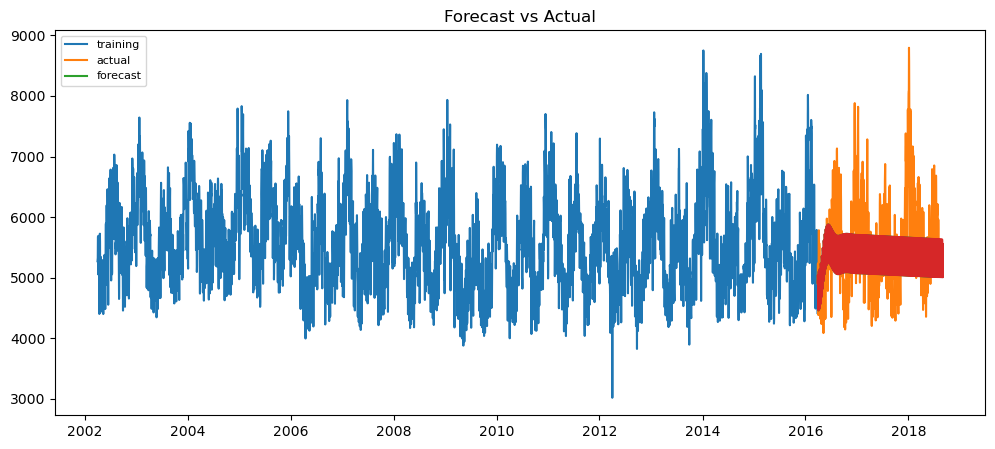

MSE Error: 316367.2137
RMSE Error: 562.4653
MAPE: 9.848


In [151]:
model_serimax = SARIMAX(train, order=(4,0,3), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(4, 0, 5)x(1, 0, [1], 7)   Log Likelihood              -35871.233
Date:                             Wed, 05 Apr 2023   AIC                          71766.466
Time:                                     12:55:18   BIC                          71844.934
Sample:                                 04-01-2002   HQIC                         71793.937
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          1.6159      0.026     61.365      0.000       1.564       1.667
ar.L2          0.3761      

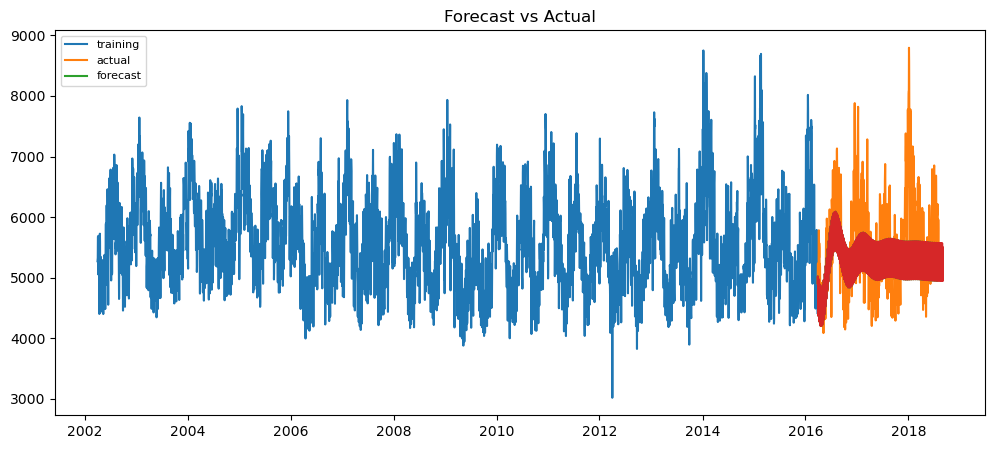

MSE Error: 270284.3644
RMSE Error: 519.8888
MAPE: 8.937


In [152]:
model_serimax = SARIMAX(train, order=(4,0,5), seasonal_order=(1,0,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                     SARIMAX Results                                      
Dep. Variable:                            PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 7)   Log Likelihood              -36475.977
Date:                            Wed, 05 Apr 2023   AIC                          72967.954
Time:                                    12:55:40   BIC                          73020.253
Sample:                                04-01-2002   HQIC                         72986.265
                                     - 03-27-2016                                         
Covariance Type:                              opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.7280      0.010    -72.332      0.000      -0.748      -0.708
ar.L2          0.4158      0.013   

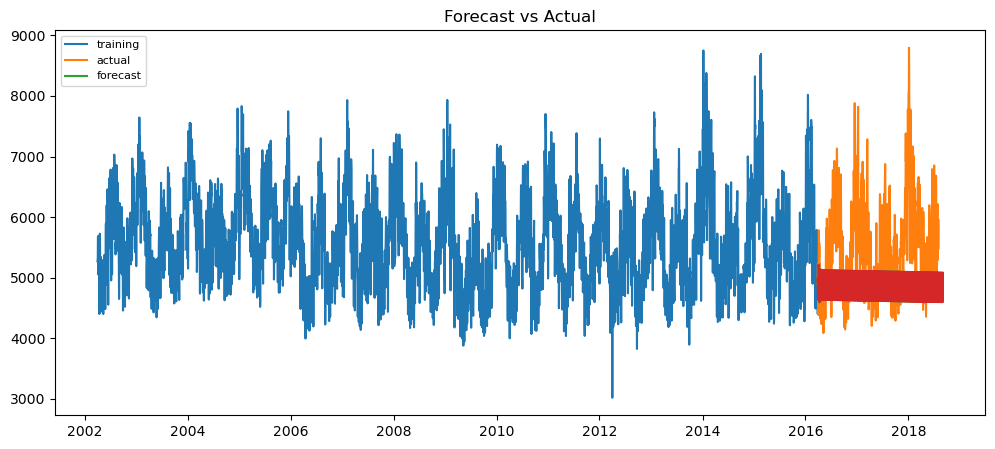

MSE Error: 682123.1986
RMSE Error: 825.9075
MAPE: 13.679


In [153]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 7)   Log Likelihood              -35843.578
Date:                             Wed, 05 Apr 2023   AIC                          71705.156
Time:                                     12:56:04   BIC                          71763.992
Sample:                                 04-01-2002   HQIC                         71725.756
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.3295      0.268     -1.229      0.219      -0.855       0.196
ar.L2          0.5664      

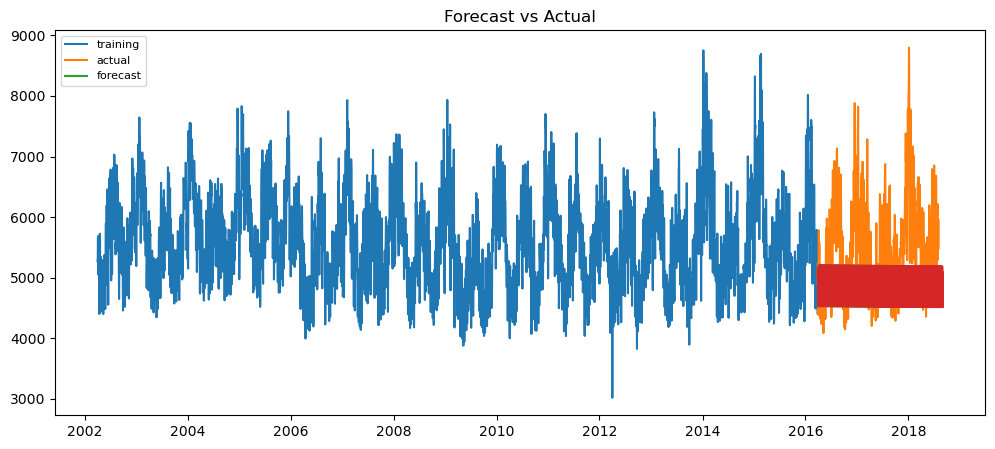

MSE Error: 484480.7302
RMSE Error: 696.0465
MAPE: 11.53


In [154]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,7))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 30)   Log Likelihood              -37021.985
Date:                              Wed, 05 Apr 2023   AIC                          74061.970
Time:                                      12:58:54   BIC                          74120.765
Sample:                                  04-01-2002   HQIC                         74082.560
                                       - 03-27-2016                                         
Covariance Type:                                opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          2.2311      0.040     56.243      0.000       2.153       2.309
ar.L2         -2.21

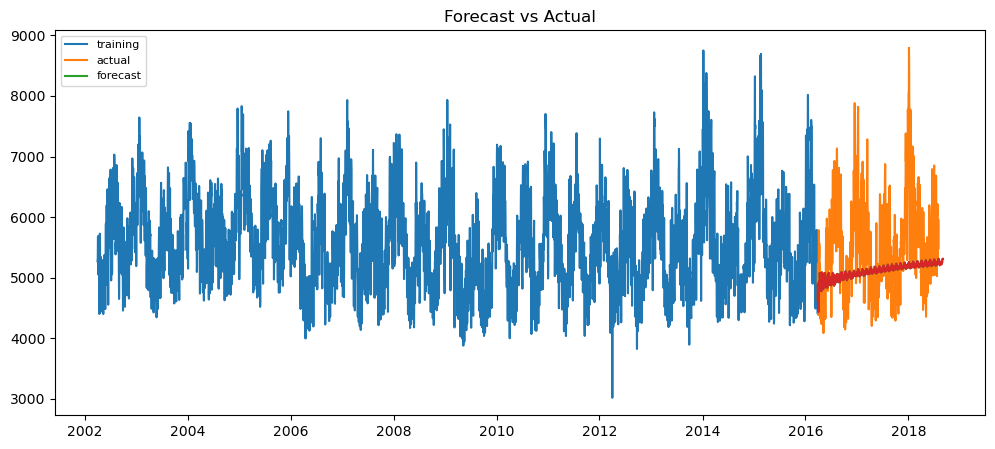

MSE Error: 418838.8459
RMSE Error: 647.1776
MAPE: 10.814


In [155]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,30))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                      
Dep. Variable:                             PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 30)   Log Likelihood              -38059.993
Date:                             Wed, 05 Apr 2023   AIC                          76135.986
Time:                                     13:01:06   BIC                          76188.249
Sample:                                 04-01-2002   HQIC                         76154.289
                                      - 03-27-2016                                         
Covariance Type:                               opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.2700      0.009     31.033      0.000       0.253       0.287
ar.L2          0.2194      

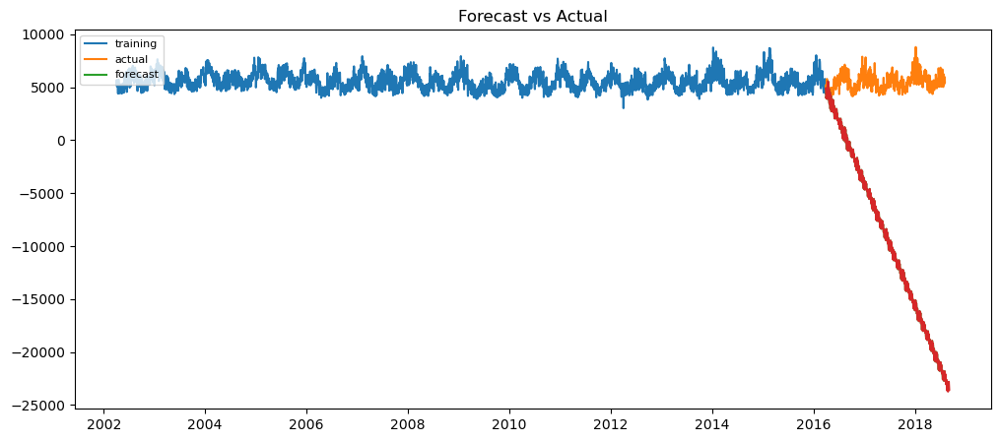

MSE Error: 207952934.3007
RMSE Error: 14420.5733
MAPE: 258.254


In [156]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,30))

sarimamodel_fit = model_serimax.fit()
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                       SARIMAX Results                                       
Dep. Variable:                               PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 120)   Log Likelihood              -36562.314
Date:                               Wed, 05 Apr 2023   AIC                          73142.628
Time:                                       13:54:27   BIC                          73201.263
Sample:                                   04-01-2002   HQIC                         73163.181
                                        - 03-27-2016                                         
Covariance Type:                        Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3753        nan        nan        nan         nan         nan
ar.L2      

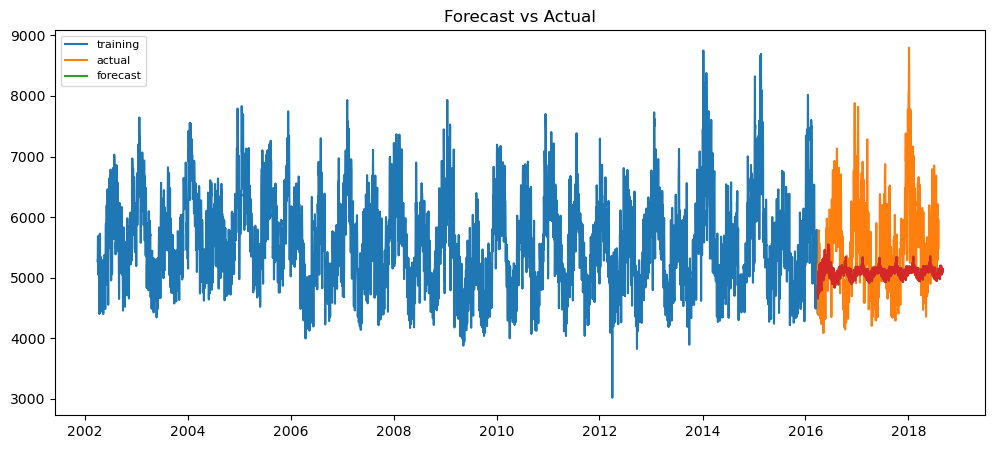

MSE Error: 466824.9599
RMSE Error: 683.2459
MAPE: 11.459


In [158]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,120))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [1], 90)   Log Likelihood              -36691.988
Date:                              Wed, 05 Apr 2023   AIC                          73401.975
Time:                                      14:20:13   BIC                          73460.664
Sample:                                  04-01-2002   HQIC                         73422.541
                                       - 03-27-2016                                         
Covariance Type:                       Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.0199        nan        nan        nan         nan         nan
ar.L2          0.24

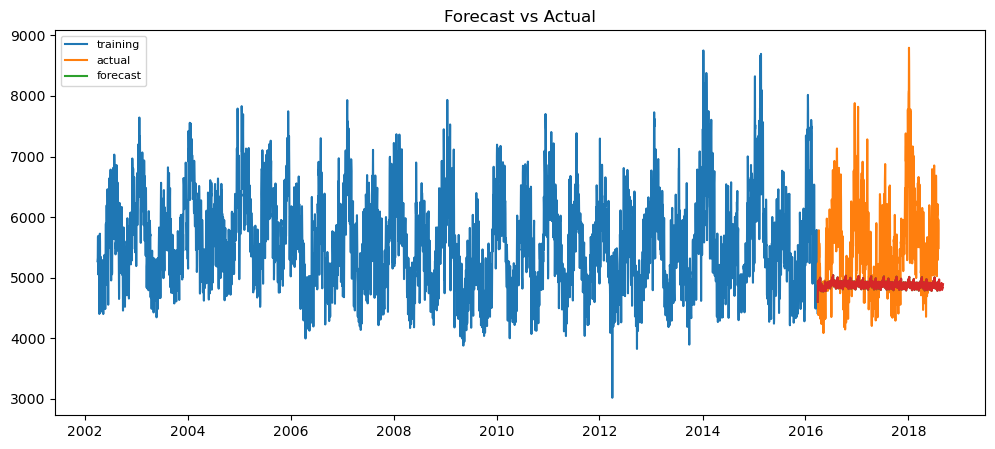

MSE Error: 587195.9196
RMSE Error: 766.2871
MAPE: 12.688


In [159]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,1,90))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')

                                      SARIMAX Results                                       
Dep. Variable:                              PJMW_MW   No. Observations:                 5110
Model:             SARIMAX(3, 1, 3)x(1, 1, [], 120)   Log Likelihood              -37347.372
Date:                              Wed, 05 Apr 2023   AIC                          74710.743
Time:                                      15:14:04   BIC                          74762.863
Sample:                                  04-01-2002   HQIC                         74729.012
                                       - 03-27-2016                                         
Covariance Type:                       Not computed                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1          0.3355        nan        nan        nan         nan         nan
ar.L2         -0.64

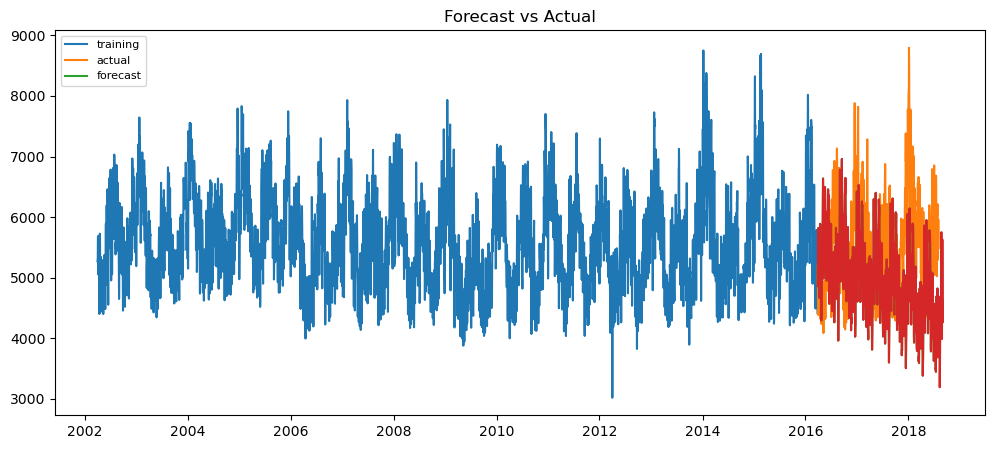

MSE Error: 988372.3982
RMSE Error: 994.1692
MAPE: 17.22


In [160]:
model_serimax = SARIMAX(train, order=(3,1,3), seasonal_order=(1,1,0,120))

sarimamodel_fit = model_serimax.fit(low_memory = True,cov_type = 'none')
print(sarimamodel_fit.summary())

pred_sarima=sarimamodel_fit.predict(start=start,end=end)


forcast=sarimamodel_fit.forecast(steps=890)## Forcasting future


plt.figure(figsize=(12,5), dpi=100)
plt.plot(train, label='training')
plt.plot(test, label='actual')
plt.plot(pred_sarima, label='forecast')
plt.title('Forecast vs Actual')
plt.legend(loc='upper left', fontsize=8)
plt.plot(forcast,label='future')
plt.show()




sarima_rmse_error = round(mean_absolute_error(test, pred_sarima),4)
sarima_mse_error =(sarima_rmse_error**2).round(4)
sarima_mape=round((mean_absolute_percentage_error(test,pred_sarima)*100),3)



print(f'MSE Error: {sarima_mse_error}\nRMSE Error: {sarima_rmse_error}\nMAPE: {sarima_mape}')